

# Training recurrent policies with PPO and Pytorch


https://stackoverflow.com/questions/57113226/how-to-prevent-google-colab-from-disconnecting
To prevent the notebook from disconnecting run in console (Opt + Command + i): 

function ClickConnect(){
console.log("Working"); 
document.querySelector("colab-toolbar-button#connect").click() 
}
setInterval(ClickConnect,60000)

# Workspace setup

In [1]:
# Workspace setup
WORKSPACE_PATH = "./"

In [2]:

# Install dependencies
#!pip install -q gym[box2d]==0.15.4 dotmap line_profiler > /dev/null

# Increase maximum number of open files to hitting limits while using for asynchronous gym vector environment.
# Also necessary for tensorboard if there are a large number of logs.
#!ulimit -n 4096
import gym
import torch
from torch import nn
from torch import distributions
import gym
import copy
from torch.utils.tensorboard import SummaryWriter
from torch import optim
import numpy as np
from itertools import count
import torch.nn.functional as F
import re
import copy
import time
import math
import pathlib
import time
import pickle
import os
from dataclasses import dataclass
import gc
from dotmap import DotMap
from base64 import b64encode
from IPython.display import HTML
from IPython.core.debugger import set_trace
from scipy.linalg import expm
import matplotlib.pyplot as plt
# Select version 2 of tensorflow to avoid warnings.
#%tensorflow_version 2.x
print("Import done!")

Import done!


.

# Settings

In [3]:
# Save metrics for viewing with tensorboard.
SAVE_METRICS_TENSORBOARD = True

# Save actor & critic parameters for viewing in tensorboard.
SAVE_PARAMETERS_TENSORBOARD = True

# Save training state frequency in PPO iterations.
CHECKPOINT_FREQUENCY = 100

# Save training state frequency in Operation learning iterations
OP_CHECKPOINT_FREQUENCY = 100

# Save plot from supersvised operator learning
PLOT_OP_LEARNING_FREQUENCY = 100

# Step env asynchronously using multiprocess or synchronously.
ASYNCHRONOUS_ENVIRONMENT = False

# Force using CPU for gathering trajectories.
FORCE_CPU_GATHER = True

# Parameters 

In [4]:
# Environment parameters
ENV = "Big_TE"
EXPERIMENT_NAME = "BIG-TE-constraintsetpoints-highlowstd"
ENV_MASK_VELOCITY = False

# Default Hyperparameters
SCALE_REWARD:         float = 0.01
MIN_REWARD:           float = -1000.
HIDDEN_SIZE:          float = 128
BATCH_SIZE:           int   = 512
DISCOUNT:             float = 0.99
GAE_LAMBDA:           float = 0.95
PPO_CLIP:             float = 0.2
PPO_EPOCHS:           int   = 10
MAX_GRAD_NORM:        float = 10.
ENTROPY_FACTOR:       float = 0.
ACTOR_LEARNING_RATE:  float = 1e-5
CRITIC_LEARNING_RATE: float = 1e-5
RECURRENT_SEQ_LEN:    int = 8
RECURRENT_LAYERS:     int = 1    
ROLLOUT_STEPS:        int = 2048
PARALLEL_ROLLOUTS:    int = 8
PATIENCE:             int = 200
TRAINABLE_STD_DEV:    bool = False 
INIT_LOG_STD_DEV:     float = -1.0

# Hyperparameters

In [5]:
@dataclass
class HyperParameters():
    scale_reward:         float = SCALE_REWARD
    min_reward:           float = MIN_REWARD
    hidden_size:          float = HIDDEN_SIZE
    batch_size:           int   = BATCH_SIZE
    discount:             float = DISCOUNT
    gae_lambda:           float = GAE_LAMBDA
    ppo_clip:             float = PPO_CLIP
    ppo_epochs:           int   = PPO_EPOCHS
    max_grad_norm:        float = MAX_GRAD_NORM
    entropy_factor:       float = ENTROPY_FACTOR
    actor_learning_rate:  float = ACTOR_LEARNING_RATE
    critic_learning_rate: float = CRITIC_LEARNING_RATE
    recurrent_seq_len:    int = RECURRENT_SEQ_LEN
    recurrent_layers:     int = RECURRENT_LAYERS 
    rollout_steps:        int = ROLLOUT_STEPS
    parallel_rollouts:    int = PARALLEL_ROLLOUTS
    patience:             int = PATIENCE
    # Apply to continous action spaces only 
    trainable_std_dev:    bool = TRAINABLE_STD_DEV
    init_log_std_dev:     float = INIT_LOG_STD_DEV

In [6]:
ENV

'Big_TE'

In [7]:

if ENV == "CartPole-v1" and ENV_MASK_VELOCITY:
    # Working perfectly with patience.
    hp = HyperParameters(parallel_rollouts=32, rollout_steps=512, batch_size=128, recurrent_seq_len=8)

elif ENV == "Pendulum-v0" and ENV_MASK_VELOCITY:
    # Works well.     
    hp = HyperParameters(parallel_rollouts=32, rollout_steps=200, batch_size=512, recurrent_seq_len=8,
                         init_log_std_dev=1., trainable_std_dev=True, actor_learning_rate=1e-3, critic_learning_rate=1e-3)

elif ENV == "LunarLander-v2" and ENV_MASK_VELOCITY:
    # Works well.
    hp = HyperParameters(parallel_rollouts=32, rollout_steps=1024, batch_size=512, recurrent_seq_len=8, patience=1000) 

elif ENV == "LunarLanderContinuous-v2" and ENV_MASK_VELOCITY:
    # Works well.
    hp = HyperParameters(parallel_rollouts=32, rollout_steps=1024, batch_size=1024, recurrent_seq_len=8, trainable_std_dev=True,  patience=1000)
    
elif ENV == "BipedalWalker-v2" and not ENV_MASK_VELOCITY:
    # Working :-D
    hp = HyperParameters(parallel_rollouts=8, rollout_steps=2048, batch_size=256, patience=1000, entropy_factor=1e-4,
                         init_log_std_dev=-1., trainable_std_dev=True, min_reward=-1.)
                         #init_log_std_dev=1., trainable_std_dev=True)
    
elif ENV == "BipedalWalkerHardcore-v2" and not ENV_MASK_VELOCITY:
    # Working :-D
#    hp = HyperParameters(batch_size=256, parallel_rollouts=8, recurrent_seq_len=8, rollout_steps=2048, patience=10000, entropy_factor=1e-4, 
#                         init_log_std_dev=-1., trainable_std_dev=True, min_reward=-1.)
    hp = HyperParameters(batch_size=1024, parallel_rollouts=32, recurrent_seq_len=8, rollout_steps=2048, patience=10000, entropy_factor=1e-4, 
                         init_log_std_dev=-1., trainable_std_dev=True, min_reward=-1., hidden_size=256)
elif ENV == "CustomEnv-v0" and not ENV_MASK_VELOCITY:
    hp = HyperParameters(batch_size=20, parallel_rollouts=32, recurrent_seq_len=8, rollout_steps=20, patience=10000, entropy_factor=1e-4, 
                         init_log_std_dev=-1., trainable_std_dev=True, hidden_size=512)

elif ENV == "Simplified_TE" and not ENV_MASK_VELOCITY:
    hp = HyperParameters(batch_size=20, parallel_rollouts=2, recurrent_seq_len=8, rollout_steps=500, patience=10000, entropy_factor=1e-4, 
                         init_log_std_dev=-1., trainable_std_dev=True, hidden_size=512)
elif ENV == "Haldex_Brake" and not ENV_MASK_VELOCITY:
    hp = HyperParameters(batch_size=10, parallel_rollouts=1, recurrent_seq_len=8, rollout_steps=1000, patience=10000, entropy_factor=1e-4, 
                         init_log_std_dev=-1., trainable_std_dev=True, hidden_size=512, scale_reward=1)
elif ENV == "Big_TE" and not ENV_MASK_VELOCITY:
    hp = HyperParameters(batch_size=10, parallel_rollouts=1, recurrent_seq_len=10, rollout_steps=720, patience=10000, entropy_factor=1e-4, 
                         init_log_std_dev=-1., trainable_std_dev=True, hidden_size=512, scale_reward=1)



else:
    raise NotImplementedError

In [8]:
"""
#Succesfull BIG_TE hp
elif ENV == "Big_TE" and not ENV_MASK_VELOCITY:
    hp = HyperParameters(batch_size=10, parallel_rollouts=1, recurrent_seq_len=10, rollout_steps=1440, patience=10000, entropy_factor=(1e-4), 
                         init_log_std_dev=-1., trainable_std_dev=True, hidden_size=512, scale_reward=1)
"""

'\n#Succesfull BIG_TE hp\nelif ENV == "Big_TE" and not ENV_MASK_VELOCITY:\n    hp = HyperParameters(batch_size=10, parallel_rollouts=1, recurrent_seq_len=10, rollout_steps=1440, patience=10000, entropy_factor=(1e-4), \n                         init_log_std_dev=-1., trainable_std_dev=True, hidden_size=512, scale_reward=1)\n'

In [9]:
batch_count = hp.parallel_rollouts * hp.rollout_steps / hp.recurrent_seq_len / hp.batch_size
print(f"batch_count: {batch_count}")
assert batch_count >= 1., "Less than 1 batch per trajectory.  Are you sure that's what you want?"

batch_count: 7.2


The discounted return at time $t$ is given by: \\
&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;$G_t = \sum_\limits{l=0}^{\infty} \gamma^l r_t$ \\
where $\gamma$ is Discount factor

In [10]:
def calc_discounted_return(rewards, discount, final_value):
    """
    Calculate discounted returns based on rewards and discount factor.
    """
    seq_len = len(rewards)
    discounted_returns = torch.zeros(seq_len)
    discounted_returns[-1] = rewards[-1] + discount * final_value
    for i in range(seq_len - 2, -1 , -1):
        discounted_returns[i] = rewards[i] + discount * discounted_returns[i + 1]
    return discounted_returns

The discounted return at time $t$ is given by: \\
&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; $A_t = \sum_\limits{l=0}^{\infty} (\lambda\gamma)^l \delta_t$,&nbsp; $\delta_t = r_t + \gamma V_t(s_{t + 1}) - V(s_t)$  \\
where $\lambda$ is the trace decay parameter and $\gamma$ is discount factor.

In [11]:
def compute_advantages(rewards, values, discount, gae_lambda):
    """
    Compute General Advantage.
    """
    deltas = rewards + discount * values[1:] - values[:-1]
    seq_len = len(rewards)
    advs = torch.zeros(seq_len + 1)
    multiplier = discount * gae_lambda
    for i in range(seq_len - 1, -1 , -1):
        advs[i] = advs[i + 1] * multiplier  + deltas[i]
    return advs[:-1]

# Helper functions

In [12]:
_INVALID_TAG_CHARACTERS = re.compile(r"[^-/\w\.]")
BASE_CHECKPOINT_PATH = f"{WORKSPACE_PATH}/checkpoints/{EXPERIMENT_NAME}/"
def save_parameters(writer, tag, model, batch_idx):
    """
    Save model parameters for tensorboard.
    """
    for k, v in model.state_dict().items():
        shape = v.shape
        # Fix shape definition for tensorboard.
        shape_formatted = _INVALID_TAG_CHARACTERS.sub("_", str(shape))
        # Don't do this for single weights or biases
        if np.any(np.array(shape) > 1):
            mean = torch.mean(v)
            std_dev = torch.std(v)
            maximum = torch.max(v)
            minimum = torch.min(v)
            writer.add_scalars(
                "{}_weights/{}{}".format(tag, k, shape_formatted),
                {"mean": mean, "std_dev": std_dev, "max": maximum, "min": minimum},
                batch_idx,
            )
        else:
            writer.add_scalar("{}_{}{}".format(tag, k, shape_formatted), v.data, batch_idx)
            
def get_env_space():
    """
    Return obsvervation dimensions, action dimensions and whether or not action space is continuous.
    """
    # 41 variables and 5 setpoints
    return 46,12,True

def get_last_checkpoint_iteration():
    """
    Determine latest checkpoint iteration.
    """
    if os.path.isdir(BASE_CHECKPOINT_PATH):
        max_checkpoint_iteration = max([int(dirname) for dirname in os.listdir(BASE_CHECKPOINT_PATH)])
    else:
        max_checkpoint_iteration = 0
    return max_checkpoint_iteration

def save_checkpoint(actor, critic, actor_optimizer, critic_optimizer, iteration, stop_conditions):
    """
    Save training checkpoint.
    """
    checkpoint = DotMap()
    checkpoint.env = ENV
    checkpoint.env_mask_velocity = ENV_MASK_VELOCITY 
    checkpoint.iteration = iteration
    checkpoint.stop_conditions = stop_conditions
    checkpoint.hp = hp
  
    CHECKPOINT_PATH = BASE_CHECKPOINT_PATH + f"{iteration}/"
    pathlib.Path(CHECKPOINT_PATH).mkdir(parents=True, exist_ok=True) 
    
    with open(CHECKPOINT_PATH + "parameters.pt", "wb") as f:
        pickle.dump(checkpoint, f)
    with open(CHECKPOINT_PATH + "actor_class.pt", "wb") as f:
        pickle.dump(Actor, f)
    with open(CHECKPOINT_PATH + "critic_class.pt", "wb") as f:
        pickle.dump(Critic, f)
    torch.save(actor.state_dict(), CHECKPOINT_PATH + "actor.pt")
    torch.save(critic.state_dict(), CHECKPOINT_PATH + "critic.pt")
    torch.save(actor_optimizer.state_dict(), CHECKPOINT_PATH + "actor_optimizer.pt")
    torch.save(critic_optimizer.state_dict(), CHECKPOINT_PATH + "critic_optimizer.pt")
    print("saved!")
    
def save_checkpoint_op(actor, critic, actor_optimizer, critic_optimizer, iteration, stop_conditions):
    """
    Save training checkpoint.
    """
    checkpoint = DotMap()
    checkpoint.env = ENV
    checkpoint.env_mask_velocity = ENV_MASK_VELOCITY 
    checkpoint.iteration = iteration
    checkpoint.stop_conditions = stop_conditions
    checkpoint.hp = hp
  
    CHECKPOINT_PATH = BASE_CHECKPOINT_PATH + f"{iteration}"+"op/"
    pathlib.Path(CHECKPOINT_PATH).mkdir(parents=True, exist_ok=True) 
    
    with open(CHECKPOINT_PATH + "parameters.pt", "wb") as f:
        pickle.dump(checkpoint, f)
    with open(CHECKPOINT_PATH + "actor_class.pt", "wb") as f:
        pickle.dump(Actor, f)
    with open(CHECKPOINT_PATH + "critic_class.pt", "wb") as f:
        pickle.dump(Critic, f)
    torch.save(actor.state_dict(), CHECKPOINT_PATH + "actor.pt")
    torch.save(critic.state_dict(), CHECKPOINT_PATH + "critic.pt")
    torch.save(actor_optimizer.state_dict(), CHECKPOINT_PATH + "actor_optimizer.pt")
    torch.save(critic_optimizer.state_dict(), CHECKPOINT_PATH + "critic_optimizer.pt")
    print("saved!")

def start_or_resume_from_checkpoint():
    """
    Create actor, critic, actor optimizer and critic optimizer from scratch
    or load from latest checkpoint if it exists. 
    """
    max_checkpoint_iteration = get_last_checkpoint_iteration()
    
    obsv_dim, action_dim, continuous_action_space = get_env_space()
    actor = Actor(obsv_dim,
                  action_dim,
                  continuous_action_space=continuous_action_space,
                  trainable_std_dev=hp.trainable_std_dev,
                  init_log_std_dev=hp.init_log_std_dev)
    critic = Critic(obsv_dim)
        
    actor_optimizer = optim.AdamW(actor.parameters(), lr=hp.actor_learning_rate)
    critic_optimizer = optim.AdamW(critic.parameters(), lr=hp.critic_learning_rate)
    
    stop_conditions = StopConditions()
        
    # If max checkpoint iteration is greater than zero initialise training with the checkpoint.
    if max_checkpoint_iteration > 0:
        actor_state_dict, critic_state_dict, actor_optimizer_state_dict, critic_optimizer_state_dict, stop_conditions = load_checkpoint(max_checkpoint_iteration)
        
        actor.load_state_dict(actor_state_dict, strict=True) 
        critic.load_state_dict(critic_state_dict, strict=True)
        actor_optimizer.load_state_dict(actor_optimizer_state_dict)
        critic_optimizer.load_state_dict(critic_optimizer_state_dict)

        # We have to move manually move optimizer states to TRAIN_DEVICE manually since optimizer doesn't yet have a "to" method.
        for state in actor_optimizer.state.values():
            for k, v in state.items():
                if isinstance(v, torch.Tensor):
                   state[k] = v.to(TRAIN_DEVICE)

        for state in critic_optimizer.state.values():
            for k, v in state.items():
                if isinstance(v, torch.Tensor):
                    state[k] = v.to(TRAIN_DEVICE)

    return actor, critic, actor_optimizer, critic_optimizer, max_checkpoint_iteration, stop_conditions
    
def load_checkpoint(iteration):
    """
    Load from training checkpoint.
    """
    CHECKPOINT_PATH = BASE_CHECKPOINT_PATH + f"{iteration}/"
    with open(CHECKPOINT_PATH + "parameters.pt", "rb") as f:
        checkpoint = pickle.load(f)
        
    #assert ENV == checkpoint.env, "To resume training environment must match current settings."
    #assert ENV_MASK_VELOCITY == checkpoint.env_mask_velocity, "To resume training model architecture must match current settings."
    #assert hp == checkpoint.hp, "To resume training hyperparameters must match current settings."

    actor_state_dict = torch.load(CHECKPOINT_PATH + "actor.pt", map_location=torch.device(TRAIN_DEVICE))
    critic_state_dict = torch.load(CHECKPOINT_PATH + "critic.pt", map_location=torch.device(TRAIN_DEVICE))
    actor_optimizer_state_dict = torch.load(CHECKPOINT_PATH + "actor_optimizer.pt", map_location=torch.device(TRAIN_DEVICE))
    critic_optimizer_state_dict = torch.load(CHECKPOINT_PATH + "critic_optimizer.pt", map_location=torch.device(TRAIN_DEVICE))
    
    return (actor_state_dict, critic_state_dict,
           actor_optimizer_state_dict, critic_optimizer_state_dict,
           checkpoint.stop_conditions)
        
@dataclass
class StopConditions():
    """
    Store parameters and variables used to stop training. 
    """
    best_reward: float = -1e6
    fail_to_improve_count: int = 0
    max_iterations: int = 100000
    max_operator_learning: int = 3
        
class MaskVelocityWrapper(gym.ObservationWrapper):
    """
    Gym environment observation wrapper used to mask velocity terms in
    observations. The intention is the make the MDP partially observatiable.
    """
    def __init__(self, env):
        super(MaskVelocityWrapper, self).__init__(env)
        if ENV == "CartPole-v1":
            self.mask = np.array([1., 0., 1., 0.])
        elif ENV == "Pendulum-v0":
            self.mask = np.array([1., 1., 0.])
        elif ENV == "LunarLander-v2":
            self.mask = np.array([1., 1., 0., 0., 1., 0., 1., 1,])
        elif ENV == "LunarLanderContinuous-v2":
            self.mask = np.array([1., 1., 0., 0., 1., 0., 1., 1,])
        else:
            raise NotImplementedError

    def observation(self, observation):
        return  observation * self.mask

In [13]:
import ctypes

import math
import random
from scipy import linalg

import numpy as np


import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.distributions import Normal
import matplotlib.pyplot as plt

from multiprocessing import Pool
from copy import deepcopy
from IPython.core.debugger import set_trace


%matplotlib inline
device   = torch.device("cpu")

import os
cwd = os.getcwd()
print(os.listdir())
print(cwd)

teprob = ctypes.cdll.LoadLibrary(os.path.abspath("a.out"))

['.ipynb_checkpoints', 'PPO_BIG_TE_constraints-Onehotencode.ipynb', 'steady_setpoints_lists', 'plotting_big_TE.ipynb', 'basic_animation.gif', 'logs', 'im.mp4', 'TE.ipynb', 'Animate_trajectory.ipynb', 'a.out', 'OTE_planta.png', 'checkpoints', 'PPO_BIG_TE-all-setpoints.ipynb', 'PPO_BIG_TE_survivaltest.ipynb', 'PPO_BIG_TE_constraints.ipynb', 'PPO_BIG_TE-all-setpoints-Copy1.ipynb', 'PPO_BIG_TE-testcase.ipynb', 'PPO_BIG_TE-Copy1.ipynb']
/home/eric/Documents/Master/BIG_TE


In [14]:


from numpy.ctypeslib import ndpointer
from ctypes import *
import ctypes
import copy

class TE():
    
    def __init__(self):
        self.te_init = teprob.teinit_
        self.te_init.argtypes = [POINTER(ctypes.c_longlong),POINTER(ctypes.c_double),ndpointer(ctypes.c_double, flags="C_CONTIGUOUS"),ndpointer(ctypes.c_double, flags="C_CONTIGUOUS")]

        self.te_func = teprob.tefunc_
        self.te_func.argtypes = [POINTER(ctypes.c_longlong),POINTER(ctypes.c_double),ndpointer(ctypes.c_double, flags="C_CONTIGUOUS"),ndpointer(ctypes.c_double, flags="C_CONTIGUOUS")]

        pv_ptr = teprob.pv_
        self.pv_ptr = cast(pv_ptr,POINTER(c_double))
        _,self.x,self.dx = self.start()
        self.t = 0.0
        self.dt = 1/3600
        
        dvec_ptr = teprob.dvec_
        self.dvec_ptr = cast(pv_ptr,POINTER(c_int))
        
        self.dt_sample_points = 60
        self.done = False
        
        self.step_cnt = 0
        
        self.max_obs =np.array([1.0182e+00, 5.8553e+03, 8.3691e+03, 1.5327e+01, 5.7174e+01,
          5.6647e+01, 3.6761e+03, 9.8263e+01, 1.4997e+02, 1.0318e+00,
          1.2259e+02, 9.8971e+01, 2.8824e+03, 7.1392e+01, 9.9833e+01,
          3.4150e+03, 5.1640e+01, 9.1023e+01, 5.6280e+02, 3.9328e+02,
          1.4112e+02, 1.0057e+02, 3.8704e+01, 1.1893e+01, 3.2123e+01,
          1.9629e+01, 2.9925e+01, 3.3803e+00, 4.0586e+01, 1.8047e+01,
          3.2809e+01, 1.9891e+01, 3.0322e+01, 6.8015e+00, 1.4306e+01,
          8.5693e+00, 8.4003e-01, 4.5093e+00, 5.3267e-01, 5.5465e+01,
          4.6045e+01])
        self.min_obs = np.array([-8.9204e-04, -9.7344e+00, -2.8562e+01, -1.4479e-01,  7.5163e+00,
          -2.7400e-01,  2.0423e+03,  5.2287e+01,  4.5724e+01, -1.8205e-03,
           2.9026e+01,  3.0014e+01,  1.9960e+03, -2.4383e-01,  1.8635e+01,
           2.3829e+03, -1.7631e-01,  3.9984e+01,  1.5041e+01,  1.7932e+02,
           4.0459e+01,  4.1280e+01,  2.3736e+01,  7.3857e+00,  1.6311e+01,
           1.5610e+00,  9.3034e+00,  8.5789e-01,  1.8609e+01,  9.5900e+00,
           7.2132e+00, -1.5111e-01,  7.1181e+00,  7.9119e-01,  6.8618e-01,
           2.4615e-01, -2.7485e-02,  5.8971e-01,  7.2881e-02,  5.1324e+01,
           4.0907e+01])        
        self.scale = (self.max_obs-self.min_obs)/2
        self.mean = (self.max_obs+self.min_obs)/2
        # Initial setpoint
        self.setpoint = [2705,75,120.4,50,50]
        self.setpoint_indx = [6,7,8,11,14]
        self.shutdown_limit_max = [2895,100,150,100,100]
        self.shutdown_limit_min = [0,50,0,30,30]
        
    def get_dvec(self):
        return self.dvec_ptr[0:20]
    
    def set_dvec(self,x):
        #takes a 20 long vector of booleans in int form!
        for i in range(0,20):
            self.pv_ptr[i] = x[i]

        
        
    def get_obs(self):
        return self.pv_ptr[0:41]
    
    def get_unscaled_obs(self):
        return np.expand_dims(np.array(copy.deepcopy(self.get_obs)),axis=0)
    
    def get_unscaled_shutdown_limits(self):
        return np.array(self.shutdown_limit_max), np.array(self.shutdown_limit_min)
    
    def get_u(self):
        return (np.array(self.pv_ptr[41:53])-50)/50
    
    def set_u(self,u):
        u = (u+1)*50
        u =u.data

        for i in range(0,12):
            self.pv_ptr[41+i] = u[i]
            
    
    def random_start_point():
        t = 0
        return t
    
    def start(self):
        x = 10*np.random.randn(50).astype(np.double)
        dx = 10*np.random.randn(50).astype(np.double)
        
        t = c_double(0.0)
        n_dof = c_longlong(50)
        self.x = x
        self.dx = dx
        self.t = 0.0
        self.step_cnt = 0
        
        self.te_init(byref(n_dof),byref(t),x,dx)
        return (t.value,x,dx)
    
    def der(self,t,x,dx):
        x = x.astype(np.double)
        dx = dx.astype(np.double)
        t = c_double(t)
        n_dof = c_longlong(50)

        self.te_func(byref(n_dof),byref(t),x,dx)
        return (t,x,dx)
    
    def get_scaled_setpoint(self):
        setp_mean = self.mean[self.setpoint_indx]
        setp_scale = self.scale[self.setpoint_indx]
        scaled_setpoint = (np.array(self.setpoint)-np.array(setp_mean))/np.array(setp_scale)
        
        return scaled_setpoint
    
    def get_scaled_shutdown_limits(self):
        setp_mean = self.mean[self.setpoint_indx]
        setp_scale = self.scale[self.setpoint_indx]
        scaled_max_limit = (np.array(self.shutdown_limit_max)-np.array(setp_mean))/np.array(setp_scale)
        scaled_min_limit = (np.array(self.shutdown_limit_min)-np.array(setp_mean))/np.array(setp_scale)
        
        return scaled_max_limit, scaled_min_limit
   
    def reward_internal(self,obs):
        set_point_1 = [2705,75,120.4,50,50]
        set_point_2 = [2800,65,122.9,50,50]
        set_point_3 = [2800,65,124.2,50,50]
        set_point_4 = [2800,65,128.2,50,50]
        setp_mean = self.mean[self.setpoint_indx]
        setp_scale = self.scale[self.setpoint_indx]
        
        """
        self.setpoint = set_point_1
        scale = [100,60,50,30,50]
        set_point_1 = np.array(set_point_1)
        scale = np.array(scale)
        obs_set = np.concatenate([obs[6:9],np.array([obs[11]]),np.array([obs[14]])])
        r = -np.sum(((set_point_1-obs_set)/scale)**2)/4
        """
        if self.step_cnt % 720 == 0:
            
            rand_indx = np.random.randint(4)
            if rand_indx == 0:
                self.setpoint = set_point_1
            elif rand_indx == 1:
                self.setpoint = set_point_2
            elif rand_indx == 2:
                self.setpoint = set_point_3
            elif rand_indx == 3:
                self.setpoint = set_point_4
        
        
        set_point_1 = self.get_scaled_setpoint()
        obs_set = np.concatenate([obs[6:9],np.array([obs[11]]),np.array([obs[14]])])
        scaled_obs_set = (np.array(obs_set)-np.array(setp_mean))/np.array(setp_scale)
        r = -np.sum((set_point_1-scaled_obs_set)**2)
        
        return (7.2+r)/7.5
        #return 7.2
    
      
        

    
    def scale_obs(self,x):
        #mean = [0.3,1500,2000,5,15,20,1500,50,60,1,40,30,1500,12.5,1500,300,60,10,50,50,15,20,12,3,15,1,10,5,10,1,2,0.01,1,0.1,50,50,1,1,1,50,50]
        #scale = [0.3,1500,2000,5,15,20,1500,50,60,1,40,30,1500,12.5,1500,1500,60,40,100,100,40,70,24,20,10,10,10,5,10,10,20,1,10,1,50,50,1,1,1,50,50]
        x = (np.array(x)-np.array(self.mean))/np.array(self.scale)
        return x
    
    def check(self):
        if self.step_cnt == hp.rollout_steps:
            return True
        constraints = [
    (7, -999999999999, 2895),
    (8, 50, 100),
    (9, -999999999999, 150),
    (12, 30, 100),
    (15, 30, 100)]
        y = self.get_obs()

        for (xi,lo,hi) in constraints:
            if lo>y[xi-1] or hi<y[xi-1]:
                #print(xi-1)
                self.done = True
                return True
        return self.done
    
    def get_scaled_obs_and_setp(self):
        scaled_obs = self.scale_obs(copy.deepcopy(self.get_obs()))
        scaled_setp = self.get_scaled_setpoint()
        scaled_obs_setp = np.concatenate([scaled_obs,scaled_setp])
    
        return scaled_obs_setp
        #return scaled_obs
        
    
    def reset(self):
        self.t,self.x,self.dx = self.start()
        self.done = False
        #return self.t,np.expand_dims(self.scale_obs(self.get_obs()),axis=0)
        return self.t,np.expand_dims(self.get_scaled_obs_and_setp(),axis=0)

    def step(self,u):
        self.step_cnt += 1
        u = np.squeeze(u,axis=0)
        self.set_u(u)
        for i in range(self.dt_sample_points):
            (t,x,dx) =self.der(self.t,self.x,self.dx)
            self.t += self.dt
            self.dx = dx
            self.x = copy.deepcopy(x) + self.dt*dx
        
        if self.check() == True:
        #if False:
            #reset 
            d = self.check()
            r = self.reward_internal(self.get_obs())-1
            t,o = self.reset()
            o = o[0,:]
            t2 = self.t
            #o2 = self.scale_obs(copy.deepcopy(self.get_obs()))
            o2 = self.get_scaled_obs_and_setp()
            
            #print("done!")
        else:
            #o = self.scale_obs(copy.deepcopy(self.get_obs()))
            o = self.get_scaled_obs_and_setp()
            t = self.t
            d = self.check()
            r = self.reward_internal(self.get_obs())
        di = [{}]
        r = np.expand_dims(r,axis=0)
        d = [d]
        o = np.expand_dims(o,axis=0)
        return o, t, d, r, di
 

In [15]:
class OUNoise(object):
    def __init__(self, action_dim, mu=0.0, theta=0.05, max_sigma=0.1, min_sigma=0.01, decay_period=4000):
        self.mu           = mu
        self.theta        = theta
        self.sigma        = max_sigma
        self.max_sigma    = max_sigma
        self.min_sigma    = min_sigma
        self.decay_period = decay_period
        self.action_dim   = action_dim
        self.low          = -1
        self.high         = 1
        self.reset()
        
    def reset(self):
        self.state = np.ones(self.action_dim) * self.mu
        
    def evolve_state(self):
        x  = self.state
        dx = self.theta * (self.mu - x) + self.sigma * (np.random.randn(self.action_dim))
        self.state = x + dx
        return self.state
    
    def get_action(self, action, t=0):
        ou_state = self.evolve_state()
        self.sigma = self.max_sigma - (self.max_sigma - self.min_sigma) * min(1.0, t / self.decay_period)
        return np.clip(action + ou_state, self.low, self.high)
    

In [16]:
"""
noise = OUNoise(12)

env = TE()
done = False    
t,o = env.reset()

x = []
y = []
t = []
#u = np.zeros(12)
print(len(env.get_u()))
u = np.array(env.get_u())
dones = []
dxs = []
us = []
rs = []
ups = []
x.append(o[0,:])
def colour_n(x,y):
    
    #if np.random.rand(1)>995/1000:
    #    x = (np.random.rand(12)-1/2)*0.5
    y_l = x
    return 0.5*x+0.5*y+0.1*(np.random.rand(12)-1/2),x

n = (np.random.rand(12)-1/2)
nl = (np.random.rand(12)-1/2)

#while done == False:
for i in range(40):
    #r = 0.5*(1/2-np.random.rand(12))
    n,nl = colour_n(n,nl)
    #print(n)
    #n = (np.random.rand(12)-1/2)*0.05
    up = u + n
    up = np.expand_dims(up,axis=0)
    print(up.shape)
    xn,tn,done,r,_ = env.step(up)

    xn = xn[0,:]
    done = done[0]
    
    rs.append(r)
    ups.append(np.squeeze(up,axis=0))
    
    dones.append(done)
    x.append(xn)
    y.append(env.get_obs())
    t.append(tn)
    us.append(env.get_u())
    #print(env.get_u())
plt.figure()
plt.title("Observations")
plt.xlabel("Timesteps/Hours")
x = np.stack(x)
t = np.stack(t)
plt.plot(x)
plt.show()

plt.figure()
plt.title("Dones")
plt.plot(dones)
plt.figure()
plt.title("Unscaled Observations")
plt.plot(y)
plt.show()

x = np.matrix(x)
plt.figure()
plt.plot(ups)
plt.show()
"""

'\nnoise = OUNoise(12)\n\nenv = TE()\ndone = False    \nt,o = env.reset()\n\nx = []\ny = []\nt = []\n#u = np.zeros(12)\nprint(len(env.get_u()))\nu = np.array(env.get_u())\ndones = []\ndxs = []\nus = []\nrs = []\nups = []\nx.append(o[0,:])\ndef colour_n(x,y):\n    \n    #if np.random.rand(1)>995/1000:\n    #    x = (np.random.rand(12)-1/2)*0.5\n    y_l = x\n    return 0.5*x+0.5*y+0.1*(np.random.rand(12)-1/2),x\n\nn = (np.random.rand(12)-1/2)\nnl = (np.random.rand(12)-1/2)\n\n#while done == False:\nfor i in range(40):\n    #r = 0.5*(1/2-np.random.rand(12))\n    n,nl = colour_n(n,nl)\n    #print(n)\n    #n = (np.random.rand(12)-1/2)*0.05\n    up = u + n\n    up = np.expand_dims(up,axis=0)\n    print(up.shape)\n    xn,tn,done,r,_ = env.step(up)\n\n    xn = xn[0,:]\n    done = done[0]\n    \n    rs.append(r)\n    ups.append(np.squeeze(up,axis=0))\n    \n    dones.append(done)\n    x.append(xn)\n    y.append(env.get_obs())\n    t.append(tn)\n    us.append(env.get_u())\n    #print(env.get_u()

# Recurrent Models

In [17]:
class Actor(nn.Module):
    def __init__(self, state_dim, action_dim, continuous_action_space, trainable_std_dev, init_log_std_dev=None):
        super().__init__()
        self.lstm = nn.LSTM(state_dim, hp.hidden_size, num_layers=hp.recurrent_layers)
        self.layer_hidden = nn.Linear(hp.hidden_size, hp.hidden_size)
        self.layer_policy_logits = nn.Linear(hp.hidden_size, action_dim)
        self.action_dim = action_dim
        self.continuous_action_space = continuous_action_space 
        self.log_std_dev = nn.Parameter(init_log_std_dev * torch.ones((action_dim), dtype=torch.float), requires_grad=trainable_std_dev)
        self.covariance_eye = torch.eye(self.action_dim).unsqueeze(0)
        self.hidden_cell = None
        self.T_scale = nn.Tanh()
        
    def get_init_state(self, batch_size, device):
        self.hidden_cell = (torch.zeros(hp.recurrent_layers, batch_size, hp.hidden_size).to(device),
                            torch.zeros(hp.recurrent_layers, batch_size,hp.hidden_size).to(device))
        
    def forward(self, state, terminal=None):
        batch_size = state.shape[1]
        device = state.device
       
        if self.hidden_cell is None or batch_size != self.hidden_cell[0].shape[1]:
            self.get_init_state(batch_size, device)
        if terminal is not None:
            self.hidden_cell = [value * (1. - terminal).reshape(1, batch_size, 1) for value in self.hidden_cell]
            
        _, self.hidden_cell = self.lstm(state, self.hidden_cell)
        
        hidden_out = F.elu(self.layer_hidden(self.hidden_cell[0][-1]))
        policy_logits_out = self.layer_policy_logits(hidden_out)
        policy_logits_out = self.T_scale(policy_logits_out)
        if self.continuous_action_space:
            
            cov_matrix = self.covariance_eye.to(device).expand(batch_size, self.action_dim, self.action_dim) * torch.exp(self.log_std_dev.to(device))
            # We define the distribution on the CPU since otherwise operations fail with CUDA illegal memory access error.
            policy_dist = torch.distributions.multivariate_normal.MultivariateNormal(policy_logits_out.to("cpu"), cov_matrix.to("cpu"))
        else:
            policy_dist = distributions.Categorical(F.softmax(policy_logits_out, dim=1).to("cpu"))
        return policy_dist
    
class Critic(nn.Module):
    def __init__(self, state_dim):
        super().__init__()
        self.layer_lstm = nn.LSTM(state_dim, hp.hidden_size, num_layers=hp.recurrent_layers)
        self.layer_hidden = nn.Linear(hp.hidden_size, hp.hidden_size)
        self.layer_value = nn.Linear(hp.hidden_size, 1)
        self.hidden_cell = None
        
    def get_init_state(self, batch_size, device):
        self.hidden_cell = (torch.zeros(hp.recurrent_layers, batch_size, hp.hidden_size).to(device),
                            torch.zeros(hp.recurrent_layers, batch_size, hp.hidden_size).to(device))
    
    def forward(self, state, terminal=None):
        
        batch_size = state.shape[1]
        device = state.device
        if self.hidden_cell is None or batch_size != self.hidden_cell[0].shape[1]:
            self.get_init_state(batch_size, device)
        if terminal is not None:
            self.hidden_cell = [(value * (1. - terminal)).reshape((1, batch_size, hp.hidden_size)) for value in self.hidden_cell]
      
        _, self.hidden_cell = self.layer_lstm(state, self.hidden_cell)
        hidden_out = F.elu(self.layer_hidden(self.hidden_cell[0][-1]))
        value_out = self.layer_value(hidden_out)
     
        return value_out

# Gather operator trajectories from MLC

In [18]:
def gather_operator_trajectories(input_data):
    """
    Gather operator trajectories from gyms lqr environment.
    """
    # Unpack inputs.
    env = input_data["env"]
    actor = input_data["actor"]
    critic = input_data["critic"]
    
    # Initialise variables.
    obsv = env.reset()
    trajectory_data_ppo = {
                 "ppo_actions": [],
                 "values": [],
                 "actor_hidden_states": [],
                 "actor_cell_states": [],
                 "critic_hidden_states": [],
                 "critic_cell_states": [],
                 "ppo_actions_mu": []
                  }
    padded_trajectories = {"discounted_returns": []}
    terminal = torch.ones(hp.parallel_rollouts) 
    obs_dim = env.observation_space.shape[0]
  
    # Get MLC trajectories
    mlp_obs_traj, mlp_act_traj, mlp_rew_traj = env.get_mlp_trajectory()
    mlp_obs_traj = torch.tensor(mlp_obs_traj, dtype=torch.float32)
    mlp_act_traj = torch.tensor(mlp_act_traj, dtype=torch.float32)
    mlp_rew_traj = hp.scale_reward*torch.tensor(mlp_rew_traj).float()

    
    # Reset actor and critic state.
    actor.get_init_state(hp.parallel_rollouts, TRAIN_DEVICE)
    critic.get_init_state(hp.parallel_rollouts, TRAIN_DEVICE)
    # Take 1 additional step in order to collect the state and value for the final state.
    for i in range(hp.rollout_steps):
        # save hidden and cell states
        trajectory_data_ppo["actor_hidden_states"].append(actor.hidden_cell[0].squeeze(0).cpu())
        trajectory_data_ppo["actor_cell_states"].append(actor.hidden_cell[1].squeeze(0).cpu())
        trajectory_data_ppo["critic_hidden_states"].append(critic.hidden_cell[0].squeeze(0).cpu())
        trajectory_data_ppo["critic_cell_states"].append(critic.hidden_cell[1].squeeze(0).cpu())

      
        state = mlp_obs_traj[i,:,:]
        value = critic(state.unsqueeze(0).to(TRAIN_DEVICE), terminal.to(TRAIN_DEVICE))
        trajectory_data_ppo["values"].append(value.squeeze(1).cpu())
        action_dist = actor(state.unsqueeze(0).to(TRAIN_DEVICE), terminal.to(TRAIN_DEVICE))
        set_trace()
        action_ppo_mu = action_dist.loc
        trajectory_data_ppo["ppo_actions_mu"].append(action_ppo_mu)
        action_ppo = action_dist.rsample().reshape(hp.parallel_rollouts, -1)
        trajectory_data_ppo["ppo_actions"].append(action_ppo)

# Combine step lists into tensors.
   
    trajectory_tensors_ppo = {key: torch.stack(value) for key, value in trajectory_data_ppo.items()}
    trajectory_tensors_ppo["op_actions"] = mlp_act_traj
    trajectory_tensors_ppo["rewards"] = mlp_rew_traj
    trajectory_tensors_ppo["states"] = mlp_obs_traj
    
    for i in range(hp.parallel_rollouts):
        single_padding = torch.zeros(0)
        padded_trajectories["discounted_returns"].append(torch.cat((calc_discounted_return(rewards=trajectory_tensors_ppo["rewards"][:,i],
                                                                    discount=DISCOUNT,
                                                                    final_value=0), single_padding)))
   
    return_val = {k: torch.stack(v) for k, v in padded_trajectories.items()} 
    return_val["discounted_returns"] = torch.transpose(return_val["discounted_returns"],0,1)
    
    for k,v in trajectory_tensors_ppo.items():
      return_val[k] = v
    return_val = {key: value.to(TRAIN_DEVICE) for key, value in return_val.items()}
    return return_val


****************Remember that we forget final value, equal to saying that we have 0 for terminal episodes so it might work *********************

# Gather trajectories from environment using current policy.

In [19]:
_MIN_REWARD_VALUES = torch.full([hp.parallel_rollouts], hp.min_reward)

def gather_trajectories(input_data):
    """
    Gather policy trajectories from gym environment.
    """
    
    # Unpack inputs.
    env = input_data["env"]
    actor = input_data["actor"]
    critic = input_data["critic"]
    
    # Initialise variables.
    t, obsv = env.reset()
    trajectory_data = {"states": [],
                 "actions": [],
                 "action_probabilities": [],
                 "rewards": [],
                 "true_rewards": [],
                 "values": [],
                 "terminals": [],
                 "actor_hidden_states": [],
                 "actor_cell_states": [],
                 "critic_hidden_states": [],
                 "critic_cell_states": []}
    terminal = torch.ones(hp.parallel_rollouts) 

    with torch.no_grad():
        # Reset actor and critic state.
        actor.get_init_state(hp.parallel_rollouts, GATHER_DEVICE)
        critic.get_init_state(hp.parallel_rollouts, GATHER_DEVICE)
        # Take 1 additional step in order to collect the state and value for the final state.
        for i in range(hp.rollout_steps):
            
            trajectory_data["actor_hidden_states"].append(actor.hidden_cell[0].squeeze(0).cpu())
            trajectory_data["actor_cell_states"].append(actor.hidden_cell[1].squeeze(0).cpu())
            trajectory_data["critic_hidden_states"].append(critic.hidden_cell[0].squeeze(0).cpu())
            trajectory_data["critic_cell_states"].append(critic.hidden_cell[1].squeeze(0).cpu())
            
            # Choose next action 
            state = torch.tensor(obsv, dtype=torch.float32)
            trajectory_data["states"].append(state)
            value = critic(state.unsqueeze(0).to(GATHER_DEVICE), terminal.to(GATHER_DEVICE))
            trajectory_data["values"].append(value.squeeze(1).cpu())
            action_dist = actor(state.unsqueeze(0).to(GATHER_DEVICE), terminal.to(GATHER_DEVICE))
            action = action_dist.sample().reshape(hp.parallel_rollouts, -1)
        
            if not actor.continuous_action_space:
                action = action.squeeze(1)
            trajectory_data["actions"].append(action.cpu())
            trajectory_data["action_probabilities"].append(action_dist.log_prob(action).cpu())

            # Step environment 
            action_np = action.cpu().numpy()
          
            obsv, tn, done, reward, _ = env.step(action_np)
            
            
            terminal = torch.tensor(done).float()
            transformed_reward = hp.scale_reward * torch.max(_MIN_REWARD_VALUES, torch.tensor(reward).float())
                                                            
            trajectory_data["rewards"].append(transformed_reward)
            trajectory_data["true_rewards"].append(torch.tensor(reward).float())
            trajectory_data["terminals"].append(terminal)
        
        
        # Compute final value to allow for incomplete episodes.
        state = torch.tensor(obsv, dtype=torch.float32)
        value = critic(state.unsqueeze(0).to(GATHER_DEVICE), terminal.to(GATHER_DEVICE))
        # Future value for terminal episodes is 0.
        trajectory_data["values"].append(value.squeeze(1).cpu() * (1 - terminal))
    
    # Combine step lists into tensors.
    trajectory_tensors = {key: torch.stack(value) for key, value in trajectory_data.items()}
    
    return trajectory_tensors

In [20]:
_MIN_REWARD_VALUES = torch.full([hp.parallel_rollouts], hp.min_reward)

def gather_mu_trajectories(input_data):
    """
    Gather policy trajectories from gym environment.
    """
    
    # Unpack inputs.
    env = input_data["env"]
    actor = input_data["actor"]
    critic = input_data["critic"]
    
    # Initialise variables.
    t, obsv = env.reset()
    trajectory_data = {"states": [],
                 "actions": [],
                 "action_probabilities": [],
                 "rewards": [],
                 "true_rewards": [],
                 "values": [],
                 "terminals": [],
                 "actor_hidden_states": [],
                 "actor_cell_states": [],
                 "critic_hidden_states": [],
                 "critic_cell_states": []}
    terminal = torch.ones(hp.parallel_rollouts) 

    with torch.no_grad():
        # Reset actor and critic state.
        actor.get_init_state(hp.parallel_rollouts, GATHER_DEVICE)
        critic.get_init_state(hp.parallel_rollouts, GATHER_DEVICE)
        # Take 1 additional step in order to collect the state and value for the final state.
        for i in range(hp.rollout_steps):
            
            trajectory_data["actor_hidden_states"].append(actor.hidden_cell[0].squeeze(0).cpu())
            trajectory_data["actor_cell_states"].append(actor.hidden_cell[1].squeeze(0).cpu())
            trajectory_data["critic_hidden_states"].append(critic.hidden_cell[0].squeeze(0).cpu())
            trajectory_data["critic_cell_states"].append(critic.hidden_cell[1].squeeze(0).cpu())
            
            # Choose next action 
            state = torch.tensor(obsv, dtype=torch.float32)
            trajectory_data["states"].append(state)
            value = critic(state.unsqueeze(0).to(GATHER_DEVICE), terminal.to(GATHER_DEVICE))
            trajectory_data["values"].append(value.squeeze(1).cpu())
            action_dist = actor(state.unsqueeze(0).to(GATHER_DEVICE), terminal.to(GATHER_DEVICE))
            action = action_dist.loc.reshape(hp.parallel_rollouts, -1)
            
            if not actor.continuous_action_space:
                action = action.squeeze(1)
            trajectory_data["actions"].append(action.cpu())
            trajectory_data["action_probabilities"].append(action_dist.log_prob(action).cpu())

            # Step environment 
            action_np = action.cpu().numpy()
          
            obsv, tn, done, reward, _ = env.step(action_np)
            
            
            terminal = torch.tensor(done).float()
            transformed_reward = hp.scale_reward * torch.max(_MIN_REWARD_VALUES, torch.tensor(reward).float())
                                                            
            trajectory_data["rewards"].append(transformed_reward)
            trajectory_data["true_rewards"].append(torch.tensor(reward).float())
            trajectory_data["terminals"].append(terminal)
        
        
        # Compute final value to allow for incomplete episodes.
        state = torch.tensor(obsv, dtype=torch.float32)
        value = critic(state.unsqueeze(0).to(GATHER_DEVICE), terminal.to(GATHER_DEVICE))
        # Future value for terminal episodes is 0.
        trajectory_data["values"].append(value.squeeze(1).cpu() * (1 - terminal))
    
    # Combine step lists into tensors.
    trajectory_tensors = {key: torch.stack(value) for key, value in trajectory_data.items()}
    
    return trajectory_tensors

In [21]:
def split_trajectories_episodes(trajectory_tensors):
    """
    Split trajectories by episode.
    """

    states_episodes, actions_episodes, action_probabilities_episodes = [], [], []
    rewards_episodes, terminal_rewards_episodes, terminals_episodes, values_episodes = [], [], [], []
    policy_hidden_episodes, policy_cell_episodes, critic_hidden_episodes, critic_cell_episodes = [], [], [], []
    len_episodes = []
    trajectory_episodes = {key: [] for key in trajectory_tensors.keys()}
    for i in range(hp.parallel_rollouts):
        terminals_tmp = trajectory_tensors["terminals"].clone()
        terminals_tmp[0, i] = 1
        terminals_tmp[-1, i] = 1
        split_points = (terminals_tmp[:, i] == 1).nonzero() + 1

        split_lens = split_points[1:] - split_points[:-1]
        split_lens[0] += 1
        
        len_episode = [split_len.item() for split_len in split_lens]
        len_episodes += len_episode
        for key, value in trajectory_tensors.items():
            # Value includes additional step.
            if key == "values":
                value_split = list(torch.split(value[:, i], len_episode[:-1] + [len_episode[-1] + 1]))
                # Append extra 0 to values to represent no future reward.
                for j in range(len(value_split) - 1):
                    value_split[j] = torch.cat((value_split[j], torch.zeros(1)))
                trajectory_episodes[key] += value_split
            else:
                trajectory_episodes[key] += torch.split(value[:, i], len_episode)
    return trajectory_episodes, len_episodes

In [22]:
def pad_and_compute_returns(trajectory_episodes, len_episodes):

    """
    Pad the trajectories up to hp.rollout_steps so they can be combined in a
    single tensor.
    Add advantages and discounted_returns to trajectories.
    """

    episode_count = len(len_episodes)
    advantages_episodes, discounted_returns_episodes = [], []
    padded_trajectories = {key: [] for key in trajectory_episodes.keys()}
    padded_trajectories["advantages"] = []
    padded_trajectories["discounted_returns"] = []

    for i in range(episode_count):
        single_padding = torch.zeros(hp.rollout_steps - len_episodes[i])
        for key, value in trajectory_episodes.items():
            
            if value[i].ndim > 1:
                padding = torch.zeros(hp.rollout_steps - len_episodes[i], value[0].shape[1], dtype=value[i].dtype)
            else:
                padding = torch.zeros(hp.rollout_steps - len_episodes[i], dtype=value[i].dtype)
            padded_trajectories[key].append(torch.cat((value[i], padding)))
        padded_trajectories["advantages"].append(torch.cat((compute_advantages(rewards=trajectory_episodes["rewards"][i],
                                                        values=trajectory_episodes["values"][i],
                                                        discount=DISCOUNT,
                                                        gae_lambda=GAE_LAMBDA), single_padding)))
        padded_trajectories["discounted_returns"].append(torch.cat((calc_discounted_return(rewards=trajectory_episodes["rewards"][i],
                                                                    discount=DISCOUNT,
                                                                    final_value=trajectory_episodes["values"][i][-1]), single_padding)))
    return_val = {k: torch.stack(v) for k, v in padded_trajectories.items()} 
    return_val["seq_len"] = torch.tensor(len_episodes)
    
    return return_val 

# Training dataset from trajectories

In [23]:
@dataclass
class TrajectorBatch():
    """
    Dataclass for storing data batch.
    """
    states: torch.tensor
    actions: torch.tensor
    action_probabilities: torch.tensor
    advantages: torch.tensor
    discounted_returns: torch.tensor
    batch_size: torch.tensor
    actor_hidden_states: torch.tensor
    actor_cell_states: torch.tensor
    critic_hidden_states: torch.tensor
    critic_cell_states: torch.tensor
    

In [24]:
class TrajectoryDataset():
    """
    Fast dataset for producing training batches from trajectories.
    """
    def __init__(self, trajectories, batch_size, device, batch_len):
        
        # Combine multiple trajectories into
        self.trajectories = {key: value.to(device) for key, value in trajectories.items()}
        self.batch_len = batch_len 
        truncated_seq_len = torch.clamp(trajectories["seq_len"] - batch_len + 1, 0, hp.rollout_steps)
       
        self.cumsum_seq_len =  np.cumsum(np.concatenate( (np.array([0]), truncated_seq_len.numpy())))
        self.batch_size = batch_size
        
    def __iter__(self):
        self.valid_idx = np.arange(self.cumsum_seq_len[-1])
        self.batch_count = 0
        return self
        
    def __next__(self):
        
        if self.batch_count * self.batch_size >= math.ceil(self.cumsum_seq_len[-1] / self.batch_len):
            raise StopIteration
        else:
            actual_batch_size = min(len(self.valid_idx), self.batch_size) 
            start_idx = np.random.choice(self.valid_idx, size=actual_batch_size, replace=False )
            self.valid_idx = np.setdiff1d(self.valid_idx, start_idx)
            eps_idx = np.digitize(start_idx, bins = self.cumsum_seq_len, right=False) - 1
            seq_idx = start_idx - self.cumsum_seq_len[eps_idx]
            series_idx = np.linspace(seq_idx, seq_idx + self.batch_len - 1, num=self.batch_len, dtype=np.int64)
            self.batch_count += 1
            return TrajectorBatch(**{key: value[eps_idx, series_idx]for key, value
                                     in self.trajectories.items() if key in TrajectorBatch.__dataclass_fields__.keys()},
                                  batch_size=actual_batch_size)

# PPO Training

In [25]:
def plot_brake_trajectory(env,actor,critic,iteration, mu_or_sample):
    if mu_or_sample == "mu":
        CHECKPOINT_PATH = BASE_CHECKPOINT_PATH + f"{iteration}/mu_"
        input_data = {"env": env, "actor": actor, "critic": critic, "discount": hp.discount,
                      "gae_lambda": hp.gae_lambda}
        trajectory_tensors = gather_mu_trajectories(input_data)
    else:
        CHECKPOINT_PATH = BASE_CHECKPOINT_PATH + f"{iteration}/sample_"        
        input_data = {"env": env, "actor": actor, "critic": critic, "discount": hp.discount,
                      "gae_lambda": hp.gae_lambda}
        trajectory_tensors = gather_trajectories(input_data)
    
    
    terminals = trajectory_tensors['terminals'][:,0]
    try:
        done_indx = list(terminals).index(1)
    except:
        done_indx = terminals.shape[0]
    act_traj = trajectory_tensors["actions"][:done_indx,0,:]
    stat_traj = trajectory_tensors["states"][:done_indx,0,:]
    rewards = trajectory_tensors["rewards"][:done_indx,0]
    
    state_titles = ["Reactor pressure", "Reactor level", "Reactor temperature", "Sep. level", "Stripper level"]
    state_ylabels = ["norm. kPa", "norm. %", "norm. degree C.","norm. %", "norm. %"]
    setpoint_indx = [6,7,8,11,14]
    scaled_setpoints = env.get_scaled_setpoint()
    max_limit, min_limit = env.get_scaled_shutdown_limits()
    min_limit[0] = None
    min_limit[2] = None
    
    plt.figure()
    plt.plot(act_traj)
    plt.title(mu_or_sample+'Action PPO')
    plt.xlabel("Timesteps/1 min.")
    plt.ylabel("Action value/norm.")
    plt.savefig(CHECKPOINT_PATH+"action.png")
    plt.show()
    plt.close()
    plt.figure()
    plt.plot(stat_traj)
    plt.title('States OTE')
    plt.xlabel("Timesteps/1 min.")
    plt.ylabel("State value/norm.")
    plt.savefig(CHECKPOINT_PATH+"state.png")
    plt.show()
    plt.close()
    plt.figure()
    plt.title('Terminals')
    plt.plot(terminals)
    plt.xlabel("Timesteps/1 min.")
    plt.ylabel("Done")
    plt.show()
    plt.close()
    plt.figure()
    plt.title('Rewards')
    plt.plot(rewards)
    plt.xlabel("Timesteps/1 min.")
    plt.ylabel("norm. rewards")
    plt.savefig(CHECKPOINT_PATH+"rewards.png")
    plt.show()
    plt.close()
    
    for loc_indx,indx in enumerate(setpoint_indx):
        plt.figure()
        #loc_setp = scaled_setpoints[loc_indx]
        loc_max = max_limit[loc_indx]
        loc_min = min_limit[loc_indx]
        #setp_array = np.repeat(loc_setp, done_indx-1)
        setp_array = stat_traj[:,41+loc_indx]
        max_level = np.repeat(loc_max, done_indx-1)
        plt.title(state_titles[loc_indx])
        plt.xlabel("Timesteps / 1 min.")
        plt.ylabel(state_ylabels[loc_indx])
        plt.plot(stat_traj[:,indx], label="actual")
        plt.plot(setp_array, label="setpoint")
        plt.plot(max_level,'--',label="max limit")
        if loc_min is not None:
            min_level = np.repeat(loc_min, done_indx-1)
            plt.plot(min_level,'--',label="min limit")
            
        plt.legend()

        plt.savefig(CHECKPOINT_PATH+state_titles[loc_indx]+".png")
        plt.show()
        
        plt.close()
    

In [26]:
def plot_survival(max_s,min_s,mean_s,iteration):
    CHECKPOINT_PATH = BASE_CHECKPOINT_PATH + f"{iteration}/"
    plt.figure()
    plt.title("Survival graph")
    plt.xlabel("Training rounds")
    plt.ylabel("Minutes")
    plt.plot(max_s,label="max")
    plt.plot(min_s,label="min")
    plt.plot(mean_s,label="mean")
    plt.legend()
    plt.savefig(CHECKPOINT_PATH+"survival.png")
    plt.show()
    plt.close()

In [27]:
def train_model(actor, critic, actor_optimizer, critic_optimizer, iteration, stop_conditions):
    
    # Vector environment manages multiple instances of the environment.
    # A key difference between this and the standard gym environment is it automatically resets.
    # Therefore when the done flag is active in the done vector the corresponding state is the first new state.
    #env = gym.vector.make(ENV, hp.parallel_rollouts, asynchronous=ASYNCHRONOUS_ENVIRONMENT)
    env = TE()
    if ENV_MASK_VELOCITY:
        env = MaskVelocityWrapper(env)
    max_episode_lengths = []
    min_episode_lengths = []
    mean_episode_lengths = []
    while iteration < stop_conditions.max_iterations:      

        actor = actor.to(GATHER_DEVICE)
        critic = critic.to(GATHER_DEVICE)
        start_gather_time = time.time()

        # Gather trajectories.
        input_data = {"env": env, "actor": actor, "critic": critic, "discount": hp.discount,
                      "gae_lambda": hp.gae_lambda}
        found_nan = True
        while found_nan:
            trajectory_tensors = gather_trajectories(input_data)
            bol_nan = torch.isnan(trajectory_tensors["states"])
            nbr_nans = (bol_nan==True).nonzero().shape[0]
            if nbr_nans > 0:
                print("Found "+str(nbr_nans)+ "nans and resamples.")
                found_nan = True
            else:
                found_nan = False

        trajectory_episodes, len_episodes = split_trajectories_episodes(trajectory_tensors)
        max_episode = np.max(len_episodes)
        min_episode = np.min(len_episodes)
        mean_episode = np.mean(len_episodes)
        max_episode_lengths.append(max_episode)
        min_episode_lengths.append(min_episode)
        mean_episode_lengths.append(mean_episode)
        trajectories = pad_and_compute_returns(trajectory_episodes, len_episodes)

        # Calculate mean reward.
        complete_episode_count = trajectories["terminals"].sum().item()
        
        terminal_episodes_rewards = (trajectories["terminals"].sum(axis=1) * trajectories["true_rewards"].sum(axis=1)).sum()
       
        mean_reward =  terminal_episodes_rewards / (complete_episode_count)

        # Check stop conditions.
        if mean_reward > stop_conditions.best_reward:
            stop_conditions.best_reward = mean_reward
            stop_conditions.fail_to_improve_count = 0
        else:
            stop_conditions.fail_to_improve_count += 1
        if stop_conditions.fail_to_improve_count > hp.patience:
            print(f"Policy has not yielded higher reward for {hp.patience} iterations...  Stopping now.")
            break

        trajectory_dataset = TrajectoryDataset(trajectories, batch_size=hp.batch_size,
                                        device=TRAIN_DEVICE, batch_len=hp.recurrent_seq_len)
        end_gather_time = time.time()
        start_train_time = time.time()
        
        actor = actor.to(TRAIN_DEVICE)
        critic = critic.to(TRAIN_DEVICE)
        
        # Train actor and critic. 
        for epoch_idx in range(hp.ppo_epochs): 
            for batch in trajectory_dataset:
                
                # Get batch 
                actor.hidden_cell = (batch.actor_hidden_states[:1], batch.actor_cell_states[:1])
                
                # Update actor
                actor_optimizer.zero_grad()
                action_dist = actor(batch.states)
                # Action dist runs on cpu as a workaround to CUDA illegal memory access.
                action_probabilities = action_dist.log_prob(batch.actions[-1, :].to("cpu")).to(TRAIN_DEVICE)
                # Compute probability ratio from probabilities in logspace.
                probabilities_ratio = torch.exp(action_probabilities - batch.action_probabilities[-1, :])
                surrogate_loss_0 = probabilities_ratio * batch.advantages[-1, :]
                surrogate_loss_1 =  torch.clamp(probabilities_ratio, 1. - hp.ppo_clip, 1. + hp.ppo_clip) * batch.advantages[-1, :]
                surrogate_loss_2 = action_dist.entropy().to(TRAIN_DEVICE)
                
                actor_loss = -torch.mean(torch.min(surrogate_loss_0, surrogate_loss_1)) - torch.mean(hp.entropy_factor * surrogate_loss_2)
                PPO_clip = torch.mean(torch.min(surrogate_loss_0, surrogate_loss_1))
                entropy_factor = torch.mean(hp.entropy_factor * surrogate_loss_2)
                actor_loss.backward() 
                #torch.nn.utils.clip_grad.clip_grad_norm_(actor.parameters(), hp.max_grad_norm)
                actor_optimizer.step()

                # Update critic
                critic_optimizer.zero_grad()
                critic.hidden_cell = (batch.critic_hidden_states[:1], batch.critic_cell_states[:1])
                values = critic(batch.states)
                critic_loss = F.mse_loss(batch.discounted_returns[-1, :], values.squeeze(1))
                #set_trace()
                
                critic_loss.backward()
                c_grad_list = [] 
                
                for p in critic.parameters():
                  c_grad_list.append(p.grad.detach().abs().max())
                #torch.nn.utils.clip_grad.clip_grad_norm_(critic.parameters(), hp.max_grad_norm)
                critic_optimizer.step()
                
        end_train_time = time.time()
        print(f"Iteration: {iteration},  Mean reward: {mean_reward}, Mean Entropy: {torch.mean(surrogate_loss_2)}, " +
              f"complete_episode_count: {complete_episode_count}, Gather time: {end_gather_time - start_gather_time:.2f}s, " +
              f"Train time: {end_train_time - start_train_time:.2f}s," +
              f"Max episode: {max_episode}min., Min episode: {min_episode}min., Mean episode: {mean_episode:.2f}min." +
              f"PPO_clip: {PPO_clip} vs. Entropy_factor: {entropy_factor}")

        if SAVE_METRICS_TENSORBOARD:
            writer.add_scalar("complete_episode_count", complete_episode_count, iteration)
            writer.add_scalar("total_reward", mean_reward , iteration)
            writer.add_scalar("actor_loss", actor_loss, iteration)
            writer.add_scalar("critic_loss", critic_loss, iteration)
            writer.add_scalar("policy_entropy", torch.mean(surrogate_loss_2), iteration)
        if SAVE_PARAMETERS_TENSORBOARD:
            save_parameters(writer, "actor", actor, iteration)
            save_parameters(writer, "value", critic, iteration)
        if iteration % CHECKPOINT_FREQUENCY == 0: 
            save_checkpoint(actor,critic, actor_optimizer, critic_optimizer, iteration, stop_conditions)
        
        
        if iteration % CHECKPOINT_FREQUENCY == 0:
            plot_brake_trajectory(env,actor,critic,iteration,"mu")
            plot_brake_trajectory(env,actor,critic,iteration,"sample")
            plot_survival(max_episode_lengths,min_episode_lengths,mean_episode_lengths,iteration)
            
        iteration += 1
    return stop_conditions.best_reward 

# Operator Learning

In [28]:
def plot_actions(ppo_actions,op_actions,iteration):
  plt.figure()
  plt.title("Actions")
  plt.plot(ppo_actions, label="PPO")
  plt.plot(op_actions, label="MLC")
  plt.legend()
  PLOT_OP_PATH = BASE_CHECKPOINT_PATH+"/op_plot/"
  pathlib.Path(PLOT_OP_PATH).mkdir(parents=True, exist_ok=True) 
  plt.savefig(PLOT_OP_PATH+str(iteration)+".png")
  plt.close()
  #plt.show()

In [29]:
def operator_training(actor, critic, actor_optimizer, critic_optimizer, iteration, stop_conditions):
  

  
  env = TE_Environments(hp.parallel_rollouts)
  while iteration < stop_conditions.max_operator_learning:      

    actor = actor.to(TRAIN_DEVICE)
    critic = critic.to(TRAIN_DEVICE)
    start_gather_time = time.time()

    # Gather trajectories.
    start_gather_time = time.time()
    input_data = {"env": env, "actor": actor, "critic": critic, "discount": hp.discount}
    operator_tensors = gather_operator_trajectories(input_data)
    end_gather_time = time.time()

    # Train time whopi di whop
    actor = actor.to(TRAIN_DEVICE)
    critic = critic.to(TRAIN_DEVICE)
    start_train_time = time.time()
    # Unpack trajectories
    ppo_actions_mu = operator_tensors["ppo_actions_mu"]
    ppo_actions = operator_tensors["ppo_actions"]
    op_actions = operator_tensors["op_actions"]
    discounted_returns = operator_tensors["discounted_returns"]
    values = operator_tensors["values"]
   
    # One backprop for all steps
    
    # Calculate loss
    
    actor_loss = torch.mean(torch.mean(((ppo_actions-op_actions) ** 2).sum(2), dim=1, keepdim=True))
    critic_loss = torch.mean(torch.mean(((values-discounted_returns) ** 2), dim=1, keepdim=True))
    

    critic_optimizer.zero_grad()
    actor_optimizer.zero_grad()
    
    actor_loss.backward()
    critic_loss.backward()
    

    critic_optimizer.step()
    actor_optimizer.step()

    mean_actor_loss = (actor_loss.cpu().data.numpy())
    mean_critic_loss = (critic_loss.cpu().data.numpy())
    end_train_time = time.time()
    print(f"Iteration: {iteration},  Actor loss: {mean_actor_loss}, Critic loss: {mean_critic_loss}, " +
              f"Gather time: {end_gather_time - start_gather_time:.2f}s, " +
              f"Train time: {end_train_time - start_train_time:.2f}s")
    if iteration % PLOT_OP_LEARNING_FREQUENCY == 0:
      plot_actions(ppo_actions_mu[:,0,:].cpu().data.numpy(),op_actions[:,0,:].cpu().data.numpy(),iteration)
    if iteration % OP_CHECKPOINT_FREQUENCY == 0:
        save_checkpoint_op(actor,critic, actor_optimizer, critic_optimizer, iteration, stop_conditions)
    iteration += 1

# Environment Setup

In [30]:
RANDOM_SEED = 0
# Set random seed for consistant runs.
torch.random.manual_seed(RANDOM_SEED)
np.random.seed(RANDOM_SEED)
# Set maximum threads for torch to avoid inefficient use of multiple cpu cores.
torch.set_num_threads(1)
TRAIN_DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
GATHER_DEVICE = "cuda" if torch.cuda.is_available() and not FORCE_CPU_GATHER else "cpu"
print(TRAIN_DEVICE)
print(GATHER_DEVICE)

cpu
cpu


In [42]:
#!kill 471583
%load_ext tensorboard
%reload_ext tensorboard
%tensorboard --logdir  "{WORKSPACE_PATH}/logs/{EXPERIMENT_NAME}"



The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


# Run training

In [43]:
writer = SummaryWriter(log_dir=f"{WORKSPACE_PATH}/logs/{EXPERIMENT_NAME}")
actor, critic, actor_optimizer, critic_optimizer, iteration, stop_conditions = start_or_resume_from_checkpoint()
torch.autograd.set_detect_anomaly(True)

print(iteration)

5800


In [44]:
#actor.log_std_dev.requires_grad = False
actor.log_std_dev

Parameter containing:
tensor([-2.9603, -2.9530, -2.9490, -3.0571, -3.0014, -2.9562, -3.2078, -3.1009,
        -2.9687, -3.1954, -2.9517, -2.9577], requires_grad=True)

In [38]:

changed_log_std = actor.log_std_dev.data
print(changed_log_std)
changed_log_std = changed_log_std - 2 
print(changed_log_std)



tensor([-0.9603, -0.9530, -0.9490, -1.0571, -1.0014, -0.9562, -1.2078, -1.1009,
        -0.9687, -1.1954, -0.9517, -0.9577])
tensor([-2.9603, -2.9530, -2.9490, -3.0571, -3.0014, -2.9562, -3.2078, -3.1009,
        -2.9687, -3.1954, -2.9517, -2.9577])


In [39]:
actor.log_std_dev = nn.Parameter(changed_log_std, requires_grad=True)


In [40]:
actor.log_std_dev

Parameter containing:
tensor([-2.9603, -2.9530, -2.9490, -3.0571, -3.0014, -2.9562, -3.2078, -3.1009,
        -2.9687, -3.1954, -2.9517, -2.9577], requires_grad=True)

Iteration: 5800,  Mean reward: 310.6171569824219, Mean Entropy: -1.1021442413330078, complete_episode_count: 2.0, Gather time: 4.94s, Train time: 26.29s,Max episode: 371min., Min episode: 55min., Mean episode: 240.00min.PPO_clip: -11.446138381958008 vs. Entropy_factor: -0.00011021442333003506


/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


saved!


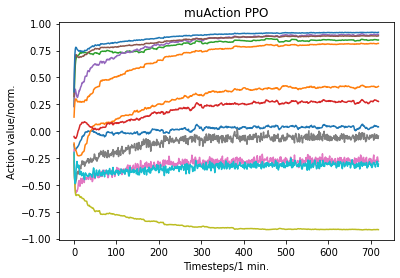

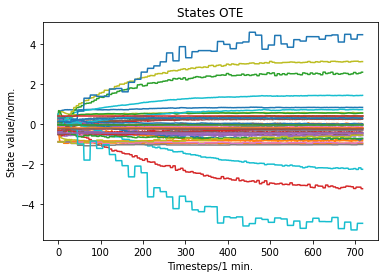

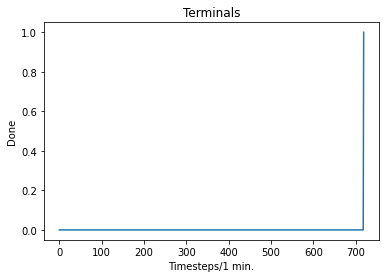

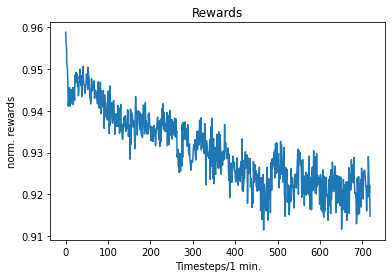

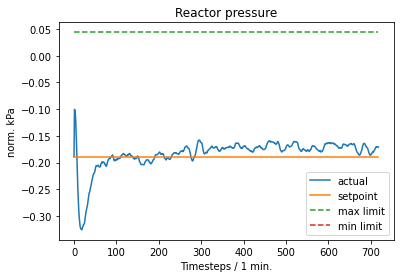

...

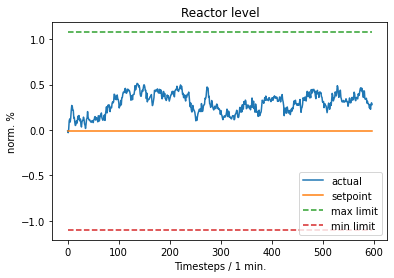

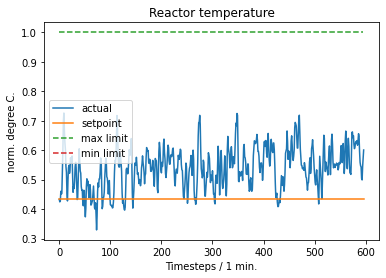

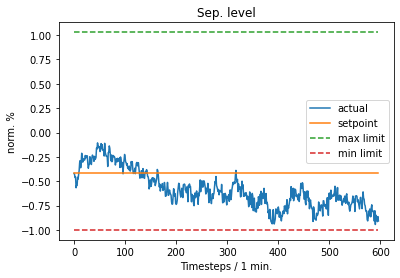

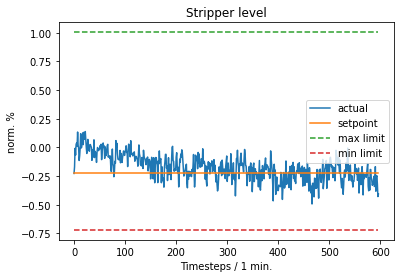

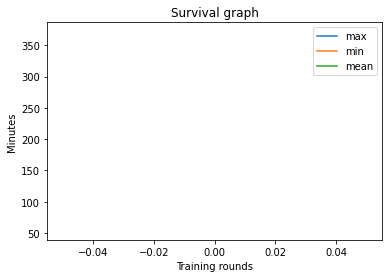

Iteration: 5801,  Mean reward: 671.0794677734375, Mean Entropy: -1.1018028259277344, complete_episode_count: 1.0, Gather time: 3.94s, Train time: 26.26s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 8.83254337310791 vs. Entropy_factor: -0.0001101802772609517
Iteration: 5802,  Mean reward: 673.5723266601562, Mean Entropy: -1.101541519165039, complete_episode_count: 1.0, Gather time: 3.64s, Train time: 23.90s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.003257462289184332 vs. Entropy_factor: -0.00011015414202120155
Iteration: 5803,  Mean reward: 624.1625366210938, Mean Entropy: -1.1015605926513672, complete_episode_count: 1.0, Gather time: 3.86s, Train time: 22.46s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.3774142265319824 vs. Entropy_factor: -0.00011015605559805408
Iteration: 5804,  Mean reward: 620.7030029296875, Mean Entropy: -1.1014881134033203, complete_episode_count: 1.0, Gathe

Iteration: 5829,  Mean reward: 652.1736450195312, Mean Entropy: -1.0981521606445312, complete_episode_count: 1.0, Gather time: 3.43s, Train time: 22.20s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.391247510910034 vs. Entropy_factor: -0.00010981522791553289
Iteration: 5830,  Mean reward: 589.8709716796875, Mean Entropy: -1.097707748413086, complete_episode_count: 1.0, Gather time: 4.20s, Train time: 22.16s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.3964431881904602 vs. Entropy_factor: -0.00010977078636642545
Iteration: 5831,  Mean reward: 597.4202270507812, Mean Entropy: -1.097452163696289, complete_episode_count: 1.0, Gather time: 3.33s, Train time: 22.89s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.7585761547088623 vs. Entropy_factor: -0.00010974520409945399
Iteration: 5832,  Mean reward: 657.6495361328125, Mean Entropy: -1.097452163696289, complete_episode_count: 1.0, Gather 

Iteration: 5857,  Mean reward: 300.98736572265625, Mean Entropy: -1.0944766998291016, complete_episode_count: 2.0, Gather time: 3.77s, Train time: 19.61s,Max episode: 332min., Min episode: 65min., Mean episode: 240.00min.PPO_clip: -0.6054607629776001 vs. Entropy_factor: -0.00010944766836473718
Iteration: 5858,  Mean reward: 327.43548583984375, Mean Entropy: -1.0946159362792969, complete_episode_count: 2.0, Gather time: 3.42s, Train time: 22.79s,Max episode: 368min., Min episode: 8min., Mean episode: 240.00min.PPO_clip: 0.43077772855758667 vs. Entropy_factor: -0.00010946158727165312
Iteration: 5859,  Mean reward: 314.71295166015625, Mean Entropy: -1.094533920288086, complete_episode_count: 2.0, Gather time: 4.04s, Train time: 22.46s,Max episode: 362min., Min episode: 30min., Mean episode: 240.00min.PPO_clip: -1.0725420713424683 vs. Entropy_factor: -0.00010945337999146432
Iteration: 5860,  Mean reward: 302.7460632324219, Mean Entropy: -1.0944271087646484, complete_episode_count: 2.0, Gat

Iteration: 5885,  Mean reward: 334.8213806152344, Mean Entropy: -1.0913314819335938, complete_episode_count: 1.0, Gather time: 3.89s, Train time: 23.97s,Max episode: 367min., Min episode: 353min., Mean episode: 360.00min.PPO_clip: 0.2520062029361725 vs. Entropy_factor: -0.00010913315054494888
Iteration: 5886,  Mean reward: 313.1147155761719, Mean Entropy: -1.091268539428711, complete_episode_count: 2.0, Gather time: 3.62s, Train time: 21.83s,Max episode: 353min., Min episode: 29min., Mean episode: 240.00min.PPO_clip: -0.3059096932411194 vs. Entropy_factor: -0.00010912683501373976
Iteration: 5887,  Mean reward: 298.5586242675781, Mean Entropy: -1.091033935546875, complete_episode_count: 2.0, Gather time: 3.83s, Train time: 21.10s,Max episode: 357min., Min episode: 64min., Mean episode: 240.00min.PPO_clip: -1.1416339874267578 vs. Entropy_factor: -0.00010910339187830687
Iteration: 5888,  Mean reward: 311.3653259277344, Mean Entropy: -1.0910472869873047, complete_episode_count: 1.0, Gather

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


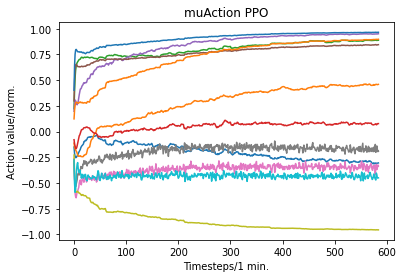

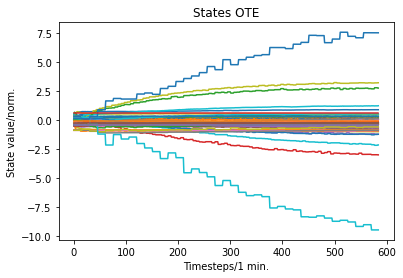

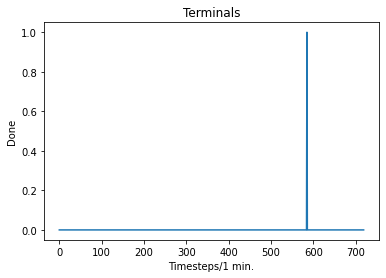

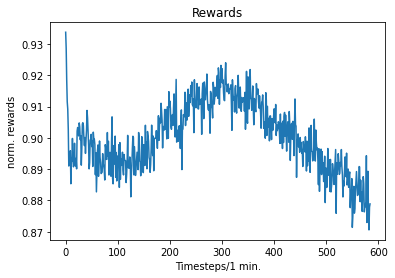

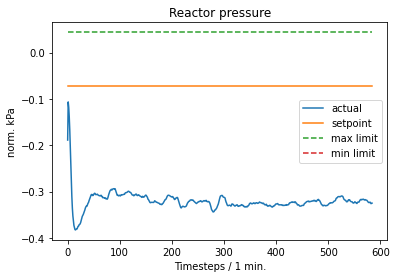

...

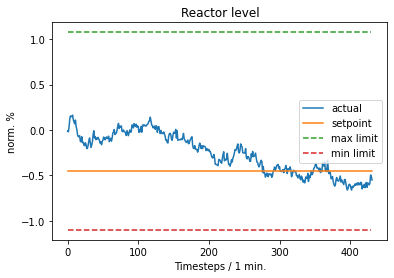

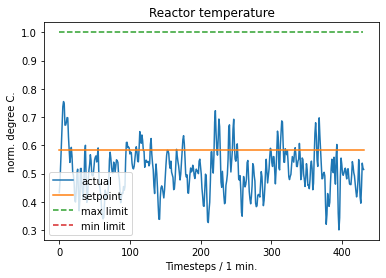

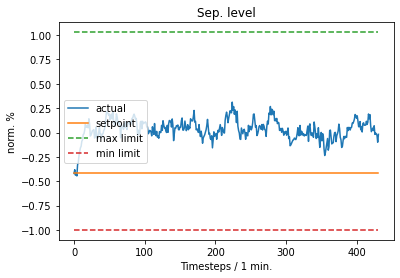

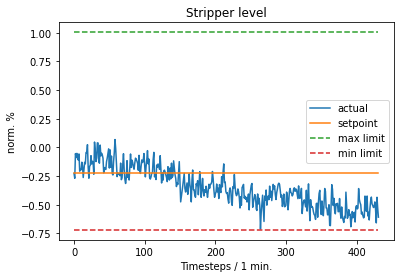

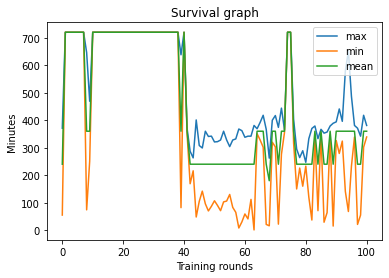

Iteration: 5901,  Mean reward: 301.4337158203125, Mean Entropy: -1.0902118682861328, complete_episode_count: 1.0, Gather time: 3.99s, Train time: 25.53s,Max episode: 383min., Min episode: 337min., Mean episode: 360.00min.PPO_clip: -1.9063329696655273 vs. Entropy_factor: -0.00010902118810918182
Iteration: 5902,  Mean reward: 408.29693603515625, Mean Entropy: -1.0901336669921875, complete_episode_count: 1.0, Gather time: 3.99s, Train time: 25.56s,Max episode: 454min., Min episode: 266min., Mean episode: 360.00min.PPO_clip: 0.9482933282852173 vs. Entropy_factor: -0.00010901336645474657
Iteration: 5903,  Mean reward: 463.9140625, Mean Entropy: -1.0900516510009766, complete_episode_count: 1.0, Gather time: 3.90s, Train time: 22.77s,Max episode: 520min., Min episode: 200min., Mean episode: 360.00min.PPO_clip: 0.5842127799987793 vs. Entropy_factor: -0.00010900515189860016
Iteration: 5904,  Mean reward: 498.1710510253906, Mean Entropy: -1.0900840759277344, complete_episode_count: 1.0, Gather t

Iteration: 5929,  Mean reward: 368.1834716796875, Mean Entropy: -1.0847225189208984, complete_episode_count: 1.0, Gather time: 3.14s, Train time: 20.32s,Max episode: 428min., Min episode: 292min., Mean episode: 360.00min.PPO_clip: 1.7776944637298584 vs. Entropy_factor: -0.00010847224621102214
Iteration: 5930,  Mean reward: 312.2275085449219, Mean Entropy: -1.0846271514892578, complete_episode_count: 1.0, Gather time: 3.07s, Train time: 20.09s,Max episode: 361min., Min episode: 359min., Mean episode: 360.00min.PPO_clip: -0.5166341662406921 vs. Entropy_factor: -0.00010846271470654756
Iteration: 5931,  Mean reward: 480.45562744140625, Mean Entropy: -1.0847549438476562, complete_episode_count: 1.0, Gather time: 3.37s, Train time: 20.45s,Max episode: 555min., Min episode: 165min., Mean episode: 360.00min.PPO_clip: 8.625033378601074 vs. Entropy_factor: -0.00010847549128811806
Iteration: 5932,  Mean reward: 464.3985290527344, Mean Entropy: -1.084564208984375, complete_episode_count: 1.0, Gath

Iteration: 5957,  Mean reward: 318.6927490234375, Mean Entropy: -1.080648422241211, complete_episode_count: 2.0, Gather time: 3.37s, Train time: 20.80s,Max episode: 381min., Min episode: 339min., Mean episode: 360.00min.PPO_clip: 0.5580048561096191 vs. Entropy_factor: -0.00010806483624037355
Iteration: 5958,  Mean reward: 319.13043212890625, Mean Entropy: -1.0803108215332031, complete_episode_count: 2.0, Gather time: 3.56s, Train time: 22.12s,Max episode: 383min., Min episode: 337min., Mean episode: 360.00min.PPO_clip: 0.2254757434129715 vs. Entropy_factor: -0.00010803107579704374
Iteration: 5959,  Mean reward: 317.00732421875, Mean Entropy: -1.0802497863769531, complete_episode_count: 2.0, Gather time: 3.57s, Train time: 18.28s,Max episode: 395min., Min episode: 6min., Mean episode: 240.00min.PPO_clip: 0.053501151502132416 vs. Entropy_factor: -0.00010802497854456306
Iteration: 5960,  Mean reward: 343.3735656738281, Mean Entropy: -1.0802993774414062, complete_episode_count: 1.0, Gather

Iteration: 5985,  Mean reward: 543.0713500976562, Mean Entropy: -1.076486587524414, complete_episode_count: 1.0, Gather time: 2.79s, Train time: 19.21s,Max episode: 597min., Min episode: 123min., Mean episode: 360.00min.PPO_clip: 0.371496319770813 vs. Entropy_factor: -0.00010764865146484226
Iteration: 5986,  Mean reward: 523.041259765625, Mean Entropy: -1.0764713287353516, complete_episode_count: 1.0, Gather time: 2.99s, Train time: 20.27s,Max episode: 573min., Min episode: 147min., Mean episode: 360.00min.PPO_clip: 0.5166305303573608 vs. Entropy_factor: -0.00010764713806565851
Iteration: 5987,  Mean reward: 536.2017211914062, Mean Entropy: -1.0763969421386719, complete_episode_count: 1.0, Gather time: 3.83s, Train time: 24.02s,Max episode: 590min., Min episode: 130min., Mean episode: 360.00min.PPO_clip: -0.09361828863620758 vs. Entropy_factor: -0.00010763968748506159
Iteration: 5988,  Mean reward: 517.70458984375, Mean Entropy: -1.0764293670654297, complete_episode_count: 1.0, Gather 

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


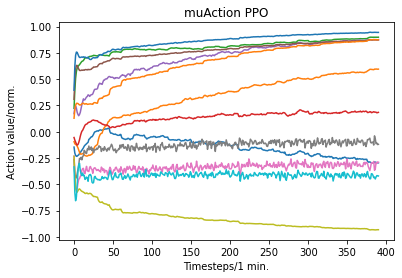

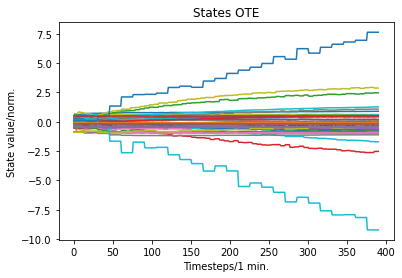

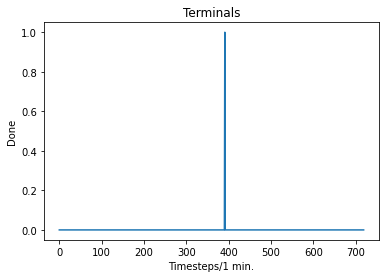

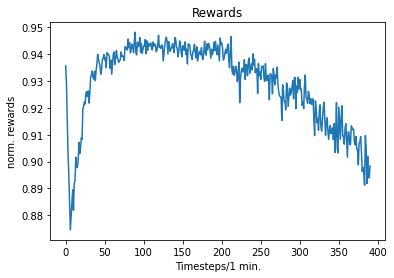

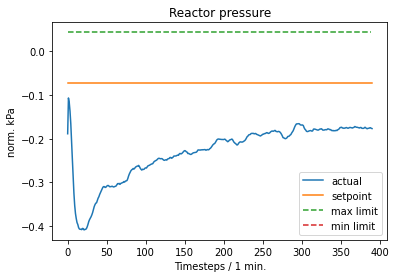

...

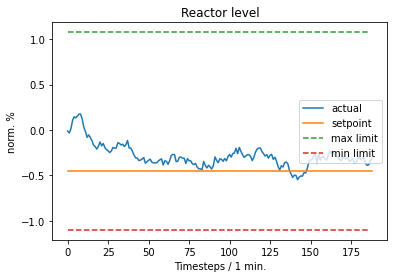

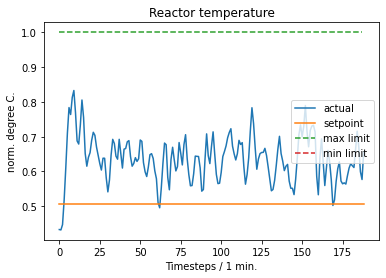

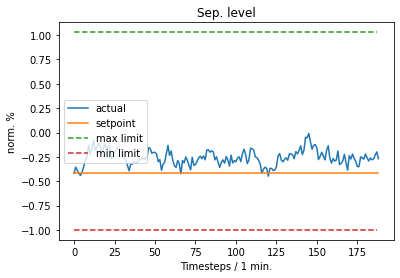

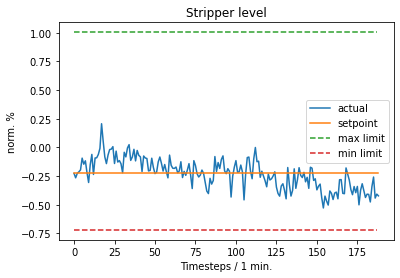

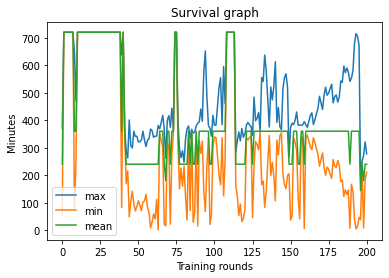

Iteration: 6001,  Mean reward: 209.68927001953125, Mean Entropy: -1.0741519927978516, complete_episode_count: 3.0, Gather time: 3.49s, Train time: 21.95s,Max episode: 373min., Min episode: 6min., Mean episode: 180.00min.PPO_clip: 3.6064486503601074 vs. Entropy_factor: -0.00010741519508883357
Iteration: 6002,  Mean reward: 220.172119140625, Mean Entropy: -1.074371337890625, complete_episode_count: 3.0, Gather time: 4.07s, Train time: 24.51s,Max episode: 330min., Min episode: 9min., Mean episode: 180.00min.PPO_clip: -4.133534908294678 vs. Entropy_factor: -0.00010743712482508272
Iteration: 6003,  Mean reward: 316.8117980957031, Mean Entropy: -1.074148178100586, complete_episode_count: 2.0, Gather time: 4.06s, Train time: 22.45s,Max episode: 346min., Min episode: 35min., Mean episode: 240.00min.PPO_clip: 4.202871322631836 vs. Entropy_factor: -0.0001074148021871224
Iteration: 6004,  Mean reward: 313.5585632324219, Mean Entropy: -1.0740795135498047, complete_episode_count: 2.0, Gather time: 

Iteration: 6029,  Mean reward: 654.2944946289062, Mean Entropy: -1.0694923400878906, complete_episode_count: 1.0, Gather time: 3.79s, Train time: 27.38s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.2630555331707001 vs. Entropy_factor: -0.00010694922821130604
Iteration: 6030,  Mean reward: 661.9262084960938, Mean Entropy: -1.0692996978759766, complete_episode_count: 1.0, Gather time: 3.91s, Train time: 26.84s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.1023318767547607 vs. Entropy_factor: -0.00010692996147554368
Iteration: 6031,  Mean reward: 644.1676025390625, Mean Entropy: -1.0690536499023438, complete_episode_count: 1.0, Gather time: 4.15s, Train time: 27.32s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.7100600004196167 vs. Entropy_factor: -0.00010690536873880774
Iteration: 6032,  Mean reward: 638.559326171875, Mean Entropy: -1.0687236785888672, complete_episode_count: 1.0, Ga

Iteration: 6057,  Mean reward: 585.2568359375, Mean Entropy: -1.0644073486328125, complete_episode_count: 1.0, Gather time: 3.96s, Train time: 27.19s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.5745328664779663 vs. Entropy_factor: -0.00010644072608556598
Iteration: 6058,  Mean reward: 575.3801879882812, Mean Entropy: -1.0641002655029297, complete_episode_count: 1.0, Gather time: 3.76s, Train time: 27.67s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -2.6878533363342285 vs. Entropy_factor: -0.00010641002154443413
Iteration: 6059,  Mean reward: 596.6043090820312, Mean Entropy: -1.063821792602539, complete_episode_count: 1.0, Gather time: 4.30s, Train time: 27.89s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.10345196723938 vs. Entropy_factor: -0.00010638216917868704
Iteration: 6060,  Mean reward: 592.0213623046875, Mean Entropy: -1.0635356903076172, complete_episode_count: 1.0, Gather ti

Iteration: 6085,  Mean reward: 140.53692626953125, Mean Entropy: -1.0607547760009766, complete_episode_count: 1.0, Gather time: 4.35s, Train time: 28.12s,Max episode: 565min., Min episode: 155min., Mean episode: 360.00min.PPO_clip: -3.0692715644836426 vs. Entropy_factor: -0.00010607547301333398
Iteration: 6086,  Mean reward: 558.8289794921875, Mean Entropy: -1.0607185363769531, complete_episode_count: 1.0, Gather time: 3.84s, Train time: 26.79s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.2568941116333008 vs. Entropy_factor: -0.00010607183503452688
Iteration: 6087,  Mean reward: 622.6427612304688, Mean Entropy: -1.060537338256836, complete_episode_count: 1.0, Gather time: 4.06s, Train time: 29.19s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.963648796081543 vs. Entropy_factor: -0.0001060537324519828
Iteration: 6088,  Mean reward: 570.7362060546875, Mean Entropy: -1.0600433349609375, complete_episode_count: 1.0, Gathe

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


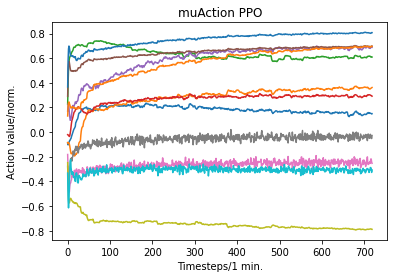

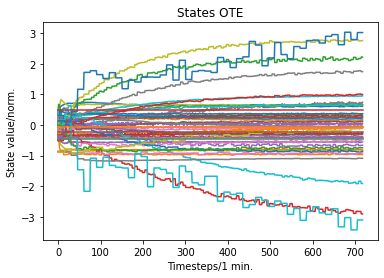

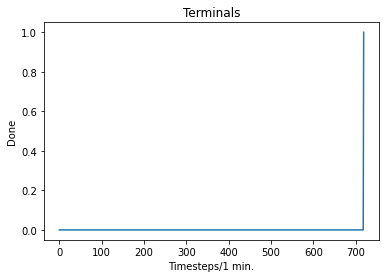

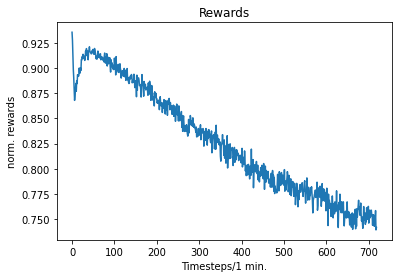

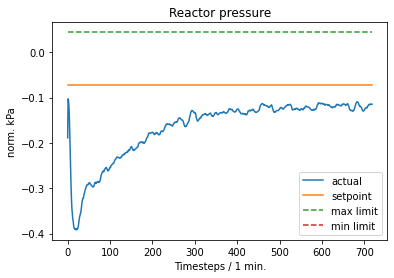

...

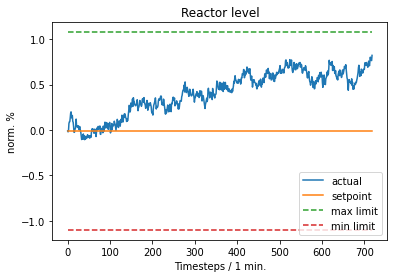

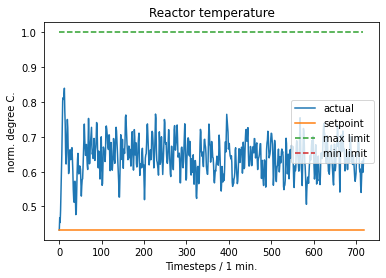

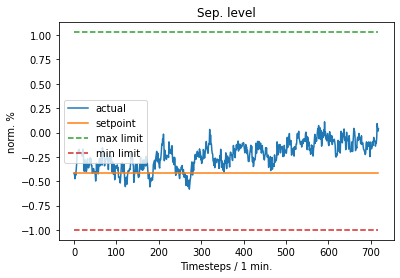

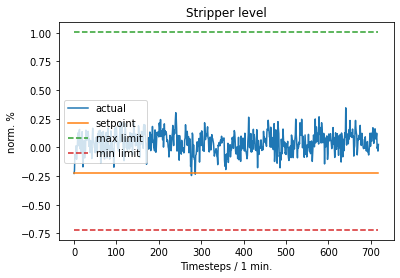

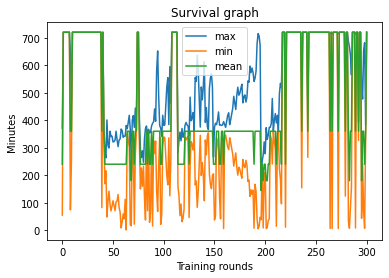

Iteration: 6101,  Mean reward: 593.308837890625, Mean Entropy: -1.0587520599365234, complete_episode_count: 1.0, Gather time: 3.73s, Train time: 29.94s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.48859065771102905 vs. Entropy_factor: -0.00010587520955596119
Iteration: 6102,  Mean reward: 599.262451171875, Mean Entropy: -1.0586891174316406, complete_episode_count: 1.0, Gather time: 3.53s, Train time: 28.54s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.20121708512306213 vs. Entropy_factor: -0.00010586890857666731
Iteration: 6103,  Mean reward: 259.359619140625, Mean Entropy: -1.0588951110839844, complete_episode_count: 1.0, Gather time: 3.81s, Train time: 29.22s,Max episode: 429min., Min episode: 291min., Mean episode: 360.00min.PPO_clip: 0.009723484516143799 vs. Entropy_factor: -0.00010588949953671545
Iteration: 6104,  Mean reward: 617.607666015625, Mean Entropy: -1.0587425231933594, complete_episode_count: 1.0, Gat

Iteration: 6129,  Mean reward: 638.906005859375, Mean Entropy: -1.0550308227539062, complete_episode_count: 1.0, Gather time: 4.27s, Train time: 27.54s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.0578083992004395 vs. Entropy_factor: -0.0001055030879797414
Iteration: 6130,  Mean reward: 654.0908203125, Mean Entropy: -1.0548324584960938, complete_episode_count: 1.0, Gather time: 3.87s, Train time: 28.02s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.9392550587654114 vs. Entropy_factor: -0.0001054832391673699
Iteration: 6131,  Mean reward: 638.8531494140625, Mean Entropy: -1.054708480834961, complete_episode_count: 1.0, Gather time: 4.27s, Train time: 27.53s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.0771188735961914 vs. Entropy_factor: -0.00010547084093559533
Iteration: 6132,  Mean reward: 659.7760009765625, Mean Entropy: -1.0546283721923828, complete_episode_count: 1.0, Gather tim

Iteration: 6157,  Mean reward: 609.3106689453125, Mean Entropy: -1.0504322052001953, complete_episode_count: 1.0, Gather time: 4.45s, Train time: 27.49s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.9312103390693665 vs. Entropy_factor: -0.00010504321835469455
Iteration: 6158,  Mean reward: 51.615299224853516, Mean Entropy: -1.0505962371826172, complete_episode_count: 1.0, Gather time: 4.18s, Train time: 28.41s,Max episode: 662min., Min episode: 58min., Mean episode: 360.00min.PPO_clip: -2.7875657081604004 vs. Entropy_factor: -0.00010505960381124169
Iteration: 6159,  Mean reward: 5.311803340911865, Mean Entropy: -1.0504741668701172, complete_episode_count: 1.0, Gather time: 3.46s, Train time: 27.53s,Max episode: 713min., Min episode: 7min., Mean episode: 360.00min.PPO_clip: 0.6394957304000854 vs. Entropy_factor: -0.00010504740930628031
Iteration: 6160,  Mean reward: 609.05859375, Mean Entropy: -1.0506019592285156, complete_episode_count: 1.0, Gather tim

Iteration: 6185,  Mean reward: 586.5142822265625, Mean Entropy: -1.045969009399414, complete_episode_count: 1.0, Gather time: 4.20s, Train time: 26.64s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.1516615152359009 vs. Entropy_factor: -0.0001045968965627253
Iteration: 6186,  Mean reward: 583.754638671875, Mean Entropy: -1.0459480285644531, complete_episode_count: 1.0, Gather time: 3.72s, Train time: 27.45s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.2220089435577393 vs. Entropy_factor: -0.00010459480108693242
Iteration: 6187,  Mean reward: 590.8153686523438, Mean Entropy: -1.0459957122802734, complete_episode_count: 1.0, Gather time: 3.90s, Train time: 27.18s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.2944070100784302 vs. Entropy_factor: -0.0001045995595632121
Iteration: 6188,  Mean reward: 591.281982421875, Mean Entropy: -1.0456733703613281, complete_episode_count: 1.0, Gather 

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


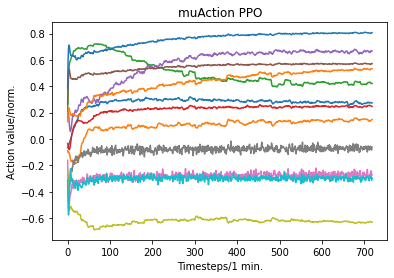

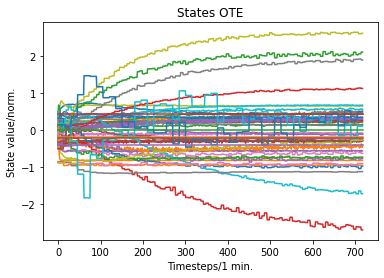

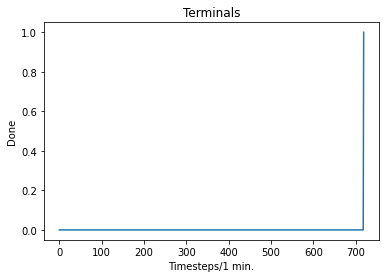

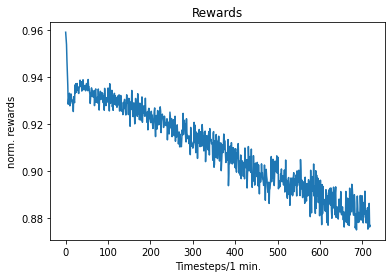

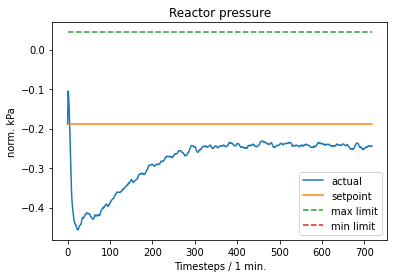

...

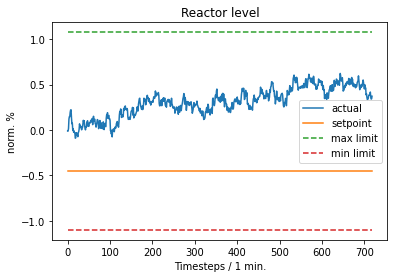

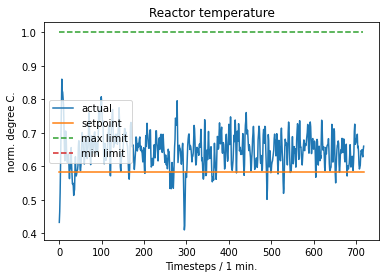

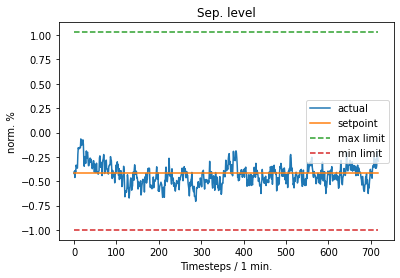

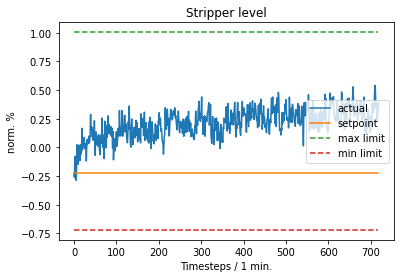

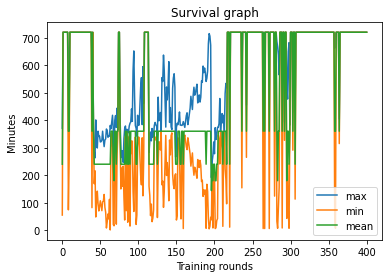

Iteration: 6201,  Mean reward: 610.6040649414062, Mean Entropy: -1.0436592102050781, complete_episode_count: 1.0, Gather time: 3.30s, Train time: 21.57s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.4025816917419434 vs. Entropy_factor: -0.00010436591401230544
Iteration: 6202,  Mean reward: 607.520751953125, Mean Entropy: -1.0436115264892578, complete_episode_count: 1.0, Gather time: 3.29s, Train time: 22.44s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.11358636617660522 vs. Entropy_factor: -0.00010436114098411053
Iteration: 6203,  Mean reward: 607.7125854492188, Mean Entropy: -1.043466567993164, complete_episode_count: 1.0, Gather time: 3.31s, Train time: 21.91s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.20981626212596893 vs. Entropy_factor: -0.00010434664727654308
Iteration: 6204,  Mean reward: 607.729248046875, Mean Entropy: -1.0432929992675781, complete_episode_count: 1.0, Gat

Iteration: 6229,  Mean reward: 593.6533813476562, Mean Entropy: -1.0395870208740234, complete_episode_count: 1.0, Gather time: 3.34s, Train time: 22.66s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.6515567302703857 vs. Entropy_factor: -0.00010395869321655482
Iteration: 6230,  Mean reward: 595.9205932617188, Mean Entropy: -1.039377212524414, complete_episode_count: 1.0, Gather time: 3.23s, Train time: 22.85s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.8454831838607788 vs. Entropy_factor: -0.00010393770935479552
Iteration: 6231,  Mean reward: 608.393310546875, Mean Entropy: -1.0393390655517578, complete_episode_count: 1.0, Gather time: 3.61s, Train time: 22.71s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 4.370380878448486 vs. Entropy_factor: -0.00010393389675300568
Iteration: 6232,  Mean reward: 69.57232666015625, Mean Entropy: -1.0386486053466797, complete_episode_count: 3.0, Gather

Iteration: 6257,  Mean reward: 632.7327880859375, Mean Entropy: -1.0348148345947266, complete_episode_count: 1.0, Gather time: 3.64s, Train time: 22.37s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.47337007522583 vs. Entropy_factor: -0.00010348147770855576
Iteration: 6258,  Mean reward: 269.9613952636719, Mean Entropy: -1.0346946716308594, complete_episode_count: 2.0, Gather time: 3.51s, Train time: 19.43s,Max episode: 607min., Min episode: 6min., Mean episode: 240.00min.PPO_clip: 0.015780029818415642 vs. Entropy_factor: -0.00010346945782657713
Iteration: 6259,  Mean reward: 5.303434371948242, Mean Entropy: -1.0350265502929688, complete_episode_count: 1.0, Gather time: 3.46s, Train time: 22.18s,Max episode: 713min., Min episode: 7min., Mean episode: 360.00min.PPO_clip: 1.7271579504013062 vs. Entropy_factor: -0.00010350265074521303
Iteration: 6260,  Mean reward: 68.07952117919922, Mean Entropy: -1.035003662109375, complete_episode_count: 1.0, Gather ti

Iteration: 6285,  Mean reward: 671.6724243164062, Mean Entropy: -1.0320358276367188, complete_episode_count: 1.0, Gather time: 3.94s, Train time: 22.56s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.4830751419067383 vs. Entropy_factor: -0.00010320357978343964
Iteration: 6286,  Mean reward: 636.2112426757812, Mean Entropy: -1.0319080352783203, complete_episode_count: 1.0, Gather time: 3.52s, Train time: 22.93s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.7633996605873108 vs. Entropy_factor: -0.0001031907886499539
Iteration: 6287,  Mean reward: 483.9971008300781, Mean Entropy: -1.0316600799560547, complete_episode_count: 1.0, Gather time: 3.44s, Train time: 22.31s,Max episode: 536min., Min episode: 184min., Mean episode: 360.00min.PPO_clip: 0.825727641582489 vs. Entropy_factor: -0.00010316599218640476
Iteration: 6288,  Mean reward: 637.6565551757812, Mean Entropy: -1.0317230224609375, complete_episode_count: 1.0, Gathe

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


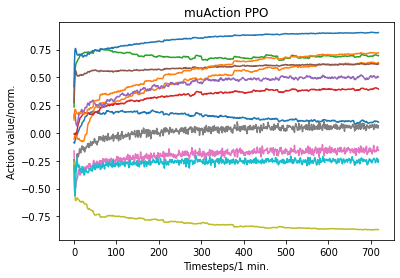

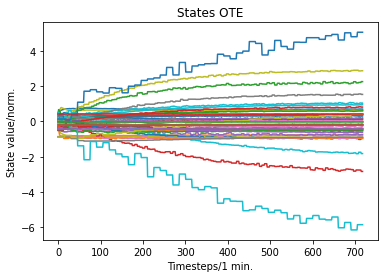

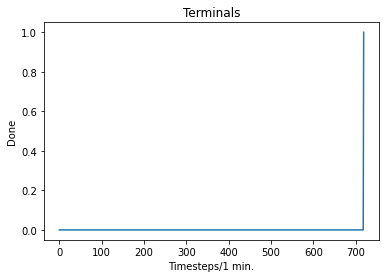

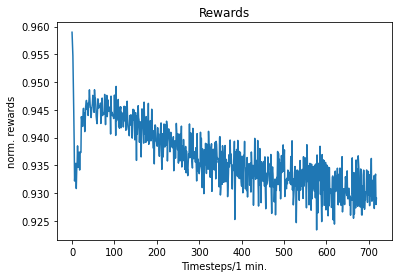

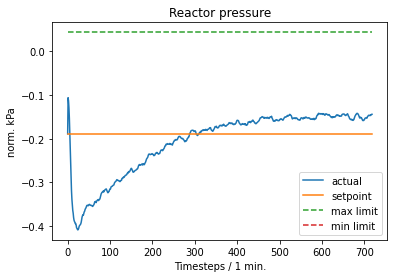

...

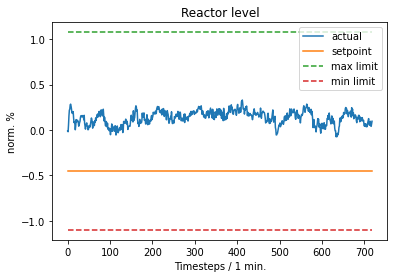

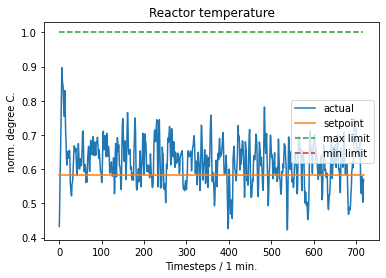

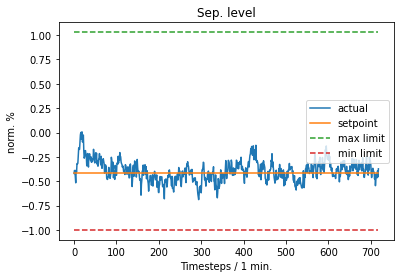

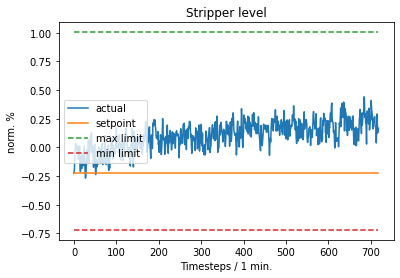

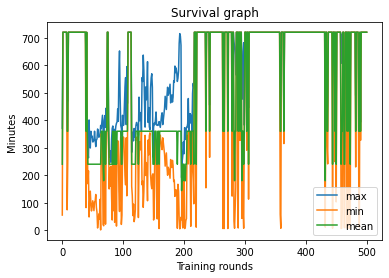

Iteration: 6301,  Mean reward: 644.3260498046875, Mean Entropy: -1.0308189392089844, complete_episode_count: 1.0, Gather time: 3.31s, Train time: 22.60s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.5470786094665527 vs. Entropy_factor: -0.0001030818821163848
Iteration: 6302,  Mean reward: 433.7922058105469, Mean Entropy: -1.0308055877685547, complete_episode_count: 1.0, Gather time: 3.72s, Train time: 22.09s,Max episode: 484min., Min episode: 236min., Mean episode: 360.00min.PPO_clip: -3.1906139850616455 vs. Entropy_factor: -0.0001030805433401838
Iteration: 6303,  Mean reward: 638.127197265625, Mean Entropy: -1.0305042266845703, complete_episode_count: 1.0, Gather time: 3.49s, Train time: 22.44s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.9137771129608154 vs. Entropy_factor: -0.00010305042087566108
Iteration: 6304,  Mean reward: 667.3665771484375, Mean Entropy: -1.0303096771240234, complete_episode_count: 1.0, Gather

Iteration: 6329,  Mean reward: 513.1204223632812, Mean Entropy: -1.0261573791503906, complete_episode_count: 1.0, Gather time: 3.56s, Train time: 22.77s,Max episode: 547min., Min episode: 173min., Mean episode: 360.00min.PPO_clip: -1.1513570547103882 vs. Entropy_factor: -0.0001026157260639593
Iteration: 6330,  Mean reward: 674.0994262695312, Mean Entropy: -1.025705337524414, complete_episode_count: 1.0, Gather time: 3.49s, Train time: 22.28s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 7.213569641113281 vs. Entropy_factor: -0.00010257052781525999
Iteration: 6331,  Mean reward: 676.6814575195312, Mean Entropy: -1.0255775451660156, complete_episode_count: 1.0, Gather time: 3.77s, Train time: 22.72s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.8129923343658447 vs. Entropy_factor: -0.00010255775123368949
Iteration: 6332,  Mean reward: 676.8258666992188, Mean Entropy: -1.0255966186523438, complete_episode_count: 1.0, Gathe

Iteration: 6357,  Mean reward: 660.5814819335938, Mean Entropy: -1.021371841430664, complete_episode_count: 1.0, Gather time: 3.38s, Train time: 22.43s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.4611232280731201 vs. Entropy_factor: -0.00010213717177975923
Iteration: 6358,  Mean reward: 657.4564819335938, Mean Entropy: -1.0213356018066406, complete_episode_count: 1.0, Gather time: 3.59s, Train time: 22.61s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.0935478210449219 vs. Entropy_factor: -0.0001021335629047826
Iteration: 6359,  Mean reward: 660.243408203125, Mean Entropy: -1.0211601257324219, complete_episode_count: 1.0, Gather time: 3.46s, Train time: 22.33s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.05240916460752487 vs. Entropy_factor: -0.00010211601329501718
Iteration: 6360,  Mean reward: 662.2962646484375, Mean Entropy: -1.020986557006836, complete_episode_count: 1.0, Gather 

Iteration: 6385,  Mean reward: 655.3438720703125, Mean Entropy: -1.0183544158935547, complete_episode_count: 1.0, Gather time: 3.52s, Train time: 21.82s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.28083521127700806 vs. Entropy_factor: -0.00010183545236941427
Iteration: 6386,  Mean reward: 653.5485229492188, Mean Entropy: -1.0180530548095703, complete_episode_count: 1.0, Gather time: 3.61s, Train time: 22.21s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.5056606531143188 vs. Entropy_factor: -0.0001018053008010611
Iteration: 6387,  Mean reward: 657.7610473632812, Mean Entropy: -1.0180854797363281, complete_episode_count: 1.0, Gather time: 3.82s, Train time: 21.81s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.5877900719642639 vs. Entropy_factor: -0.00010180856043007225
Iteration: 6388,  Mean reward: 661.2527465820312, Mean Entropy: -1.0181713104248047, complete_episode_count: 1.0, Gat

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


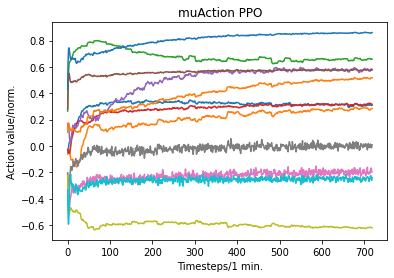

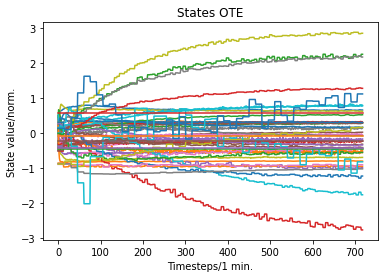

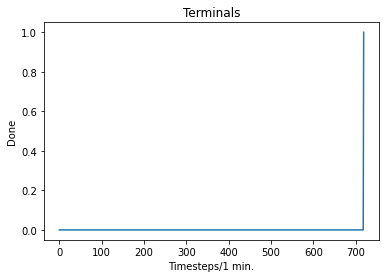

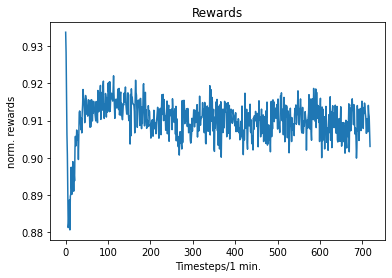

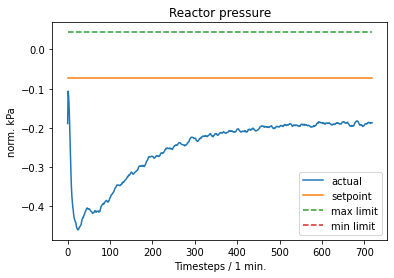

...

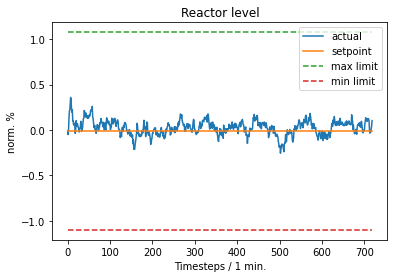

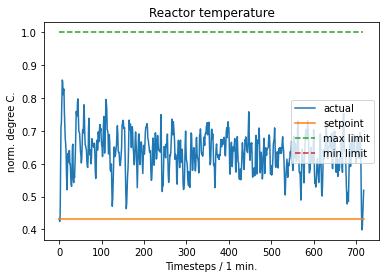

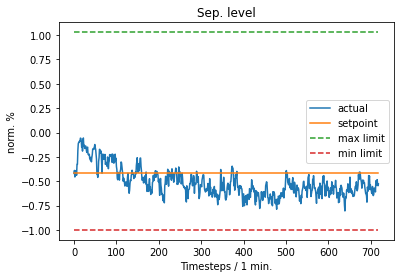

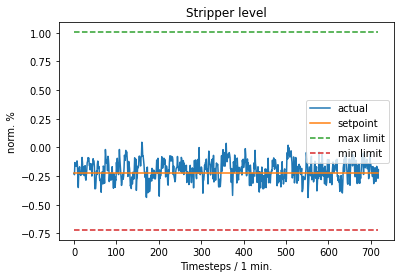

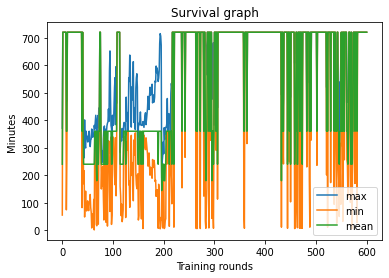

Iteration: 6401,  Mean reward: 652.412353515625, Mean Entropy: -1.016733169555664, complete_episode_count: 1.0, Gather time: 3.41s, Train time: 22.51s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.7337646484375 vs. Entropy_factor: -0.0001016733149299398
Iteration: 6402,  Mean reward: 679.180419921875, Mean Entropy: -1.0161571502685547, complete_episode_count: 1.0, Gather time: 3.56s, Train time: 21.80s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.229772686958313 vs. Entropy_factor: -0.00010161571844946593
Iteration: 6403,  Mean reward: 658.522216796875, Mean Entropy: -1.0158653259277344, complete_episode_count: 1.0, Gather time: 3.58s, Train time: 23.33s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.5222012996673584 vs. Entropy_factor: -0.00010158652730751783
Iteration: 6404,  Mean reward: 660.076416015625, Mean Entropy: -1.0156574249267578, complete_episode_count: 1.0, Gather time: 3

Iteration: 6429,  Mean reward: 664.0745849609375, Mean Entropy: -1.0120792388916016, complete_episode_count: 1.0, Gather time: 3.13s, Train time: 20.06s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -7.998831748962402 vs. Entropy_factor: -0.00010120791557710618
Iteration: 6430,  Mean reward: 678.4349975585938, Mean Entropy: -1.0119209289550781, complete_episode_count: 1.0, Gather time: 3.25s, Train time: 19.62s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.8891775608062744 vs. Entropy_factor: -0.00010119208309333771
Iteration: 6431,  Mean reward: 650.028564453125, Mean Entropy: -1.012063980102539, complete_episode_count: 1.0, Gather time: 3.09s, Train time: 19.66s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.7918323278427124 vs. Entropy_factor: -0.00010120640217792243
Iteration: 6432,  Mean reward: 655.4095458984375, Mean Entropy: -1.0118160247802734, complete_episode_count: 1.0, Gath

Iteration: 6457,  Mean reward: 657.5120239257812, Mean Entropy: -1.007711410522461, complete_episode_count: 1.0, Gather time: 3.12s, Train time: 19.77s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 4.331789016723633 vs. Entropy_factor: -0.00010077113984152675
Iteration: 6458,  Mean reward: 656.0574951171875, Mean Entropy: -1.0075340270996094, complete_episode_count: 1.0, Gather time: 3.00s, Train time: 19.95s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.2716209888458252 vs. Entropy_factor: -0.00010075340105686337
Iteration: 6459,  Mean reward: 661.8652954101562, Mean Entropy: -1.007680892944336, complete_episode_count: 1.0, Gather time: 3.19s, Train time: 19.67s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.48659104108810425 vs. Entropy_factor: -0.00010076806938741356
Iteration: 6460,  Mean reward: 657.1471557617188, Mean Entropy: -1.0077285766601562, complete_episode_count: 1.0, Gather

Iteration: 6485,  Mean reward: 448.7812194824219, Mean Entropy: -1.0040225982666016, complete_episode_count: 1.0, Gather time: 3.32s, Train time: 19.29s,Max episode: 497min., Min episode: 223min., Mean episode: 360.00min.PPO_clip: -13.08045482635498 vs. Entropy_factor: -0.00010040226334240288
Iteration: 6486,  Mean reward: 598.12890625, Mean Entropy: -1.0041236877441406, complete_episode_count: 1.0, Gather time: 3.06s, Train time: 19.54s,Max episode: 665min., Min episode: 55min., Mean episode: 360.00min.PPO_clip: 6.607601165771484 vs. Entropy_factor: -0.00010041236237157136
Iteration: 6487,  Mean reward: 85.09795379638672, Mean Entropy: -1.0037860870361328, complete_episode_count: 1.0, Gather time: 3.13s, Train time: 19.88s,Max episode: 625min., Min episode: 95min., Mean episode: 360.00min.PPO_clip: -6.317910194396973 vs. Entropy_factor: -0.00010037860192824155
Iteration: 6488,  Mean reward: 128.90194702148438, Mean Entropy: -1.0033206939697266, complete_episode_count: 2.0, Gather time

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


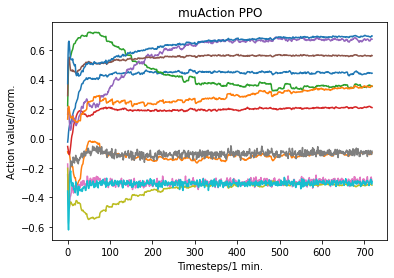

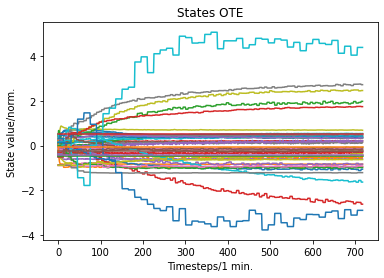

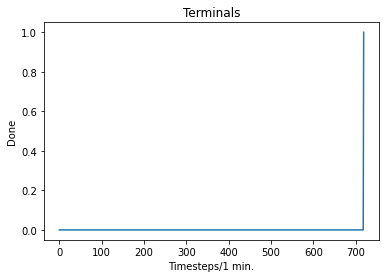

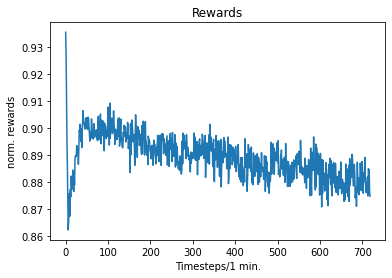

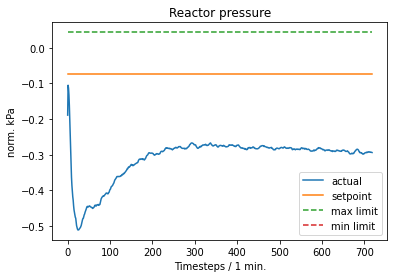

...

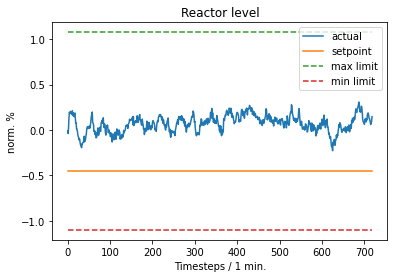

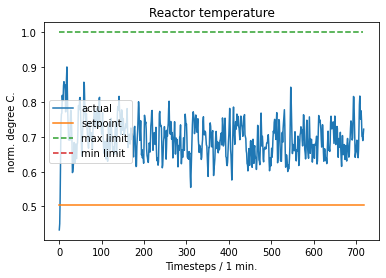

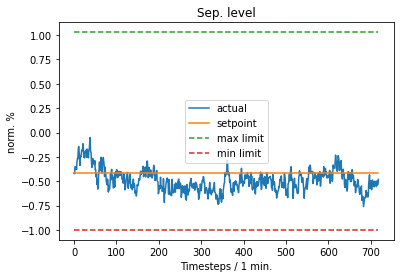

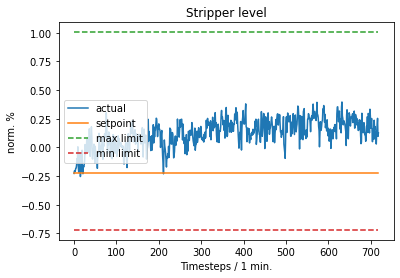

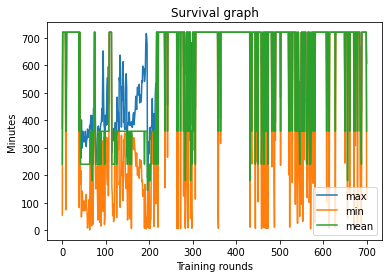

Iteration: 6501,  Mean reward: 635.0218505859375, Mean Entropy: -1.0016460418701172, complete_episode_count: 1.0, Gather time: 3.20s, Train time: 19.61s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.6039736270904541 vs. Entropy_factor: -0.00010016460146289319
Iteration: 6502,  Mean reward: 632.46923828125, Mean Entropy: -1.0016117095947266, complete_episode_count: 1.0, Gather time: 2.96s, Train time: 20.01s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.6061416864395142 vs. Entropy_factor: -0.0001001611672108993
Iteration: 6503,  Mean reward: 639.4346923828125, Mean Entropy: -1.0016326904296875, complete_episode_count: 1.0, Gather time: 3.19s, Train time: 19.87s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.8290026187896729 vs. Entropy_factor: -0.00010016326268669218
Iteration: 6504,  Mean reward: 632.3705444335938, Mean Entropy: -1.0015926361083984, complete_episode_count: 1.0, Gather

Iteration: 6529,  Mean reward: 643.1841430664062, Mean Entropy: -0.9981460571289062, complete_episode_count: 1.0, Gather time: 3.18s, Train time: 20.03s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.460580825805664 vs. Entropy_factor: -9.981459879782051e-05
Iteration: 6530,  Mean reward: 641.256103515625, Mean Entropy: -0.9980049133300781, complete_episode_count: 1.0, Gather time: 3.35s, Train time: 20.08s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.0330455303192139 vs. Entropy_factor: -9.980048344004899e-05
Iteration: 6531,  Mean reward: 639.6060791015625, Mean Entropy: -0.9977073669433594, complete_episode_count: 1.0, Gather time: 3.12s, Train time: 19.55s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.4079427719116211 vs. Entropy_factor: -9.977073932532221e-05
Iteration: 6532,  Mean reward: 641.0032958984375, Mean Entropy: -0.9974803924560547, complete_episode_count: 1.0, Gather t

Iteration: 6558,  Mean reward: 465.41644287109375, Mean Entropy: -0.9933395385742188, complete_episode_count: 1.0, Gather time: 3.03s, Train time: 19.35s,Max episode: 508min., Min episode: 212min., Mean episode: 360.00min.PPO_clip: -5.499746322631836 vs. Entropy_factor: -9.933394903782755e-05
Iteration: 6559,  Mean reward: 658.7037963867188, Mean Entropy: -0.992919921875, complete_episode_count: 1.0, Gather time: 3.23s, Train time: 19.55s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.3784548044204712 vs. Entropy_factor: -9.929198131430894e-05
Iteration: 6560,  Mean reward: 663.91845703125, Mean Entropy: -0.9928016662597656, complete_episode_count: 1.0, Gather time: 3.07s, Train time: 19.65s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 3.2574057579040527 vs. Entropy_factor: -9.928016515914351e-05
Iteration: 6561,  Mean reward: 661.7557373046875, Mean Entropy: -0.9925460815429688, complete_episode_count: 1.0, Gather time:

Iteration: 6586,  Mean reward: 659.9022827148438, Mean Entropy: -0.9890403747558594, complete_episode_count: 1.0, Gather time: 3.17s, Train time: 19.78s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.10848797857761383 vs. Entropy_factor: -9.890402725432068e-05
Iteration: 6587,  Mean reward: 493.8938903808594, Mean Entropy: -0.9888229370117188, complete_episode_count: 1.0, Gather time: 3.08s, Train time: 19.69s,Max episode: 535min., Min episode: 185min., Mean episode: 360.00min.PPO_clip: -0.15114858746528625 vs. Entropy_factor: -9.88822866929695e-05
Iteration: 6588,  Mean reward: 281.9588623046875, Mean Entropy: -0.9884223937988281, complete_episode_count: 1.0, Gather time: 3.30s, Train time: 20.08s,Max episode: 414min., Min episode: 306min., Mean episode: 360.00min.PPO_clip: -0.1359240710735321 vs. Entropy_factor: -9.884223982226104e-05
Iteration: 6589,  Mean reward: 670.6876831054688, Mean Entropy: -0.9881248474121094, complete_episode_count: 1.0, Gat

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


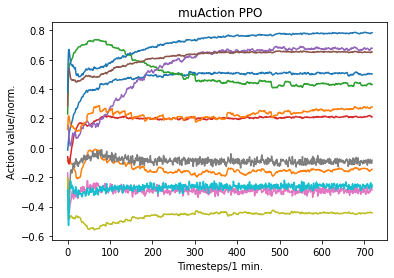

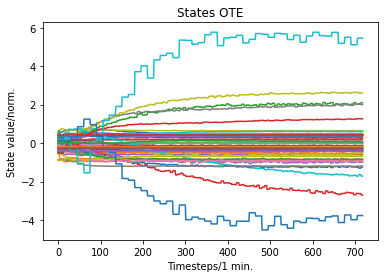

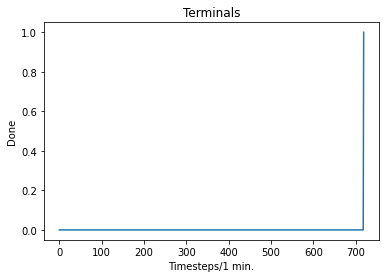

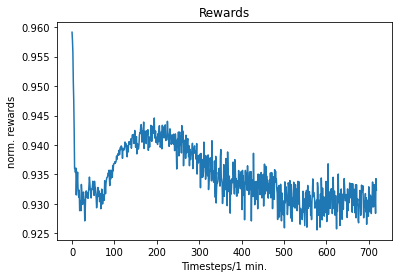

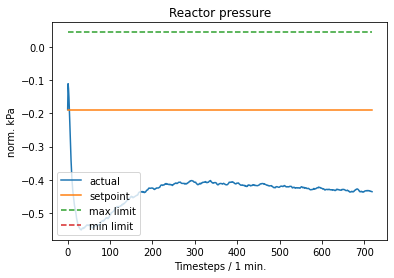

...

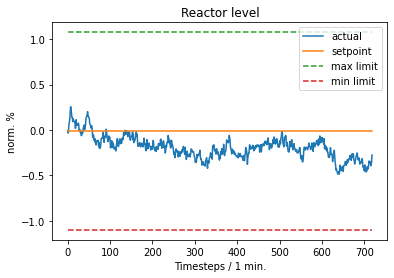

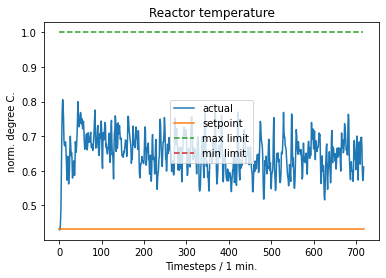

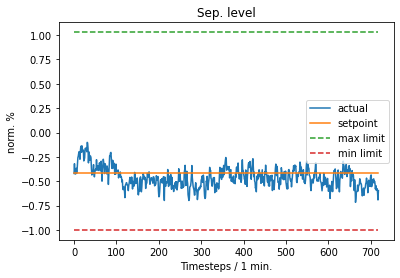

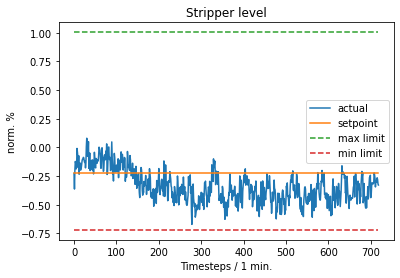

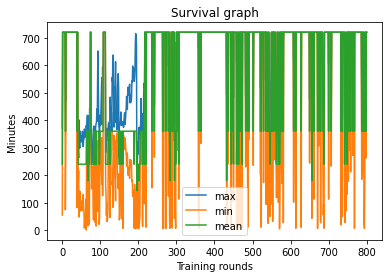

Iteration: 6601,  Mean reward: 669.1883544921875, Mean Entropy: -0.985931396484375, complete_episode_count: 1.0, Gather time: 2.87s, Train time: 19.83s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.11002640426158905 vs. Entropy_factor: -9.859314013738185e-05
Iteration: 6602,  Mean reward: 665.2886352539062, Mean Entropy: -0.9858036041259766, complete_episode_count: 1.0, Gather time: 3.05s, Train time: 19.61s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.7076339721679688 vs. Entropy_factor: -9.858036355581135e-05
Iteration: 6603,  Mean reward: 666.5452270507812, Mean Entropy: -0.9856529235839844, complete_episode_count: 1.0, Gather time: 3.06s, Train time: 19.71s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.3209036886692047 vs. Entropy_factor: -9.856528777163476e-05
Iteration: 6604,  Mean reward: 670.0723266601562, Mean Entropy: -0.9855575561523438, complete_episode_count: 1.0, Gath

Iteration: 6629,  Mean reward: 646.1109008789062, Mean Entropy: -0.9827365875244141, complete_episode_count: 1.0, Gather time: 3.19s, Train time: 19.45s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.3628745973110199 vs. Entropy_factor: -9.827363828662783e-05
Iteration: 6630,  Mean reward: 664.1219482421875, Mean Entropy: -0.9825019836425781, complete_episode_count: 1.0, Gather time: 3.28s, Train time: 19.37s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.6339858770370483 vs. Entropy_factor: -9.825020970311016e-05
Iteration: 6631,  Mean reward: 666.112060546875, Mean Entropy: -0.9824180603027344, complete_episode_count: 1.0, Gather time: 3.17s, Train time: 19.43s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.9184799194335938 vs. Entropy_factor: -9.824179869610816e-05
Iteration: 6632,  Mean reward: 664.6705932617188, Mean Entropy: -0.9823360443115234, complete_episode_count: 1.0, Gather

Iteration: 6657,  Mean reward: 658.5838623046875, Mean Entropy: -0.9786663055419922, complete_episode_count: 1.0, Gather time: 3.18s, Train time: 19.90s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.46256422996520996 vs. Entropy_factor: -9.786662121769041e-05
Iteration: 6658,  Mean reward: 651.7969360351562, Mean Entropy: -0.9785404205322266, complete_episode_count: 1.0, Gather time: 3.10s, Train time: 19.60s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.491196870803833 vs. Entropy_factor: -9.78540483629331e-05
Iteration: 6659,  Mean reward: 660.656005859375, Mean Entropy: -0.9784507751464844, complete_episode_count: 1.0, Gather time: 3.41s, Train time: 19.99s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.5074977874755859 vs. Entropy_factor: -9.784508438315243e-05
Iteration: 6660,  Mean reward: 660.3248291015625, Mean Entropy: -0.9783115386962891, complete_episode_count: 1.0, Gather 

Iteration: 6685,  Mean reward: 658.6195068359375, Mean Entropy: -0.9752960205078125, complete_episode_count: 1.0, Gather time: 3.24s, Train time: 19.67s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.15137997269630432 vs. Entropy_factor: -9.752960613695905e-05
Iteration: 6686,  Mean reward: 658.8532104492188, Mean Entropy: -0.9752578735351562, complete_episode_count: 1.0, Gather time: 3.14s, Train time: 19.77s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.3895087242126465 vs. Entropy_factor: -9.752577898325399e-05
Iteration: 6687,  Mean reward: 657.5811767578125, Mean Entropy: -0.9749927520751953, complete_episode_count: 1.0, Gather time: 3.08s, Train time: 19.84s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -4.360501289367676 vs. Entropy_factor: -9.749927994562313e-05
Iteration: 6688,  Mean reward: 656.4364624023438, Mean Entropy: -0.9749813079833984, complete_episode_count: 1.0, Gather

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


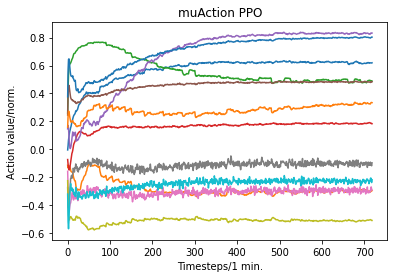

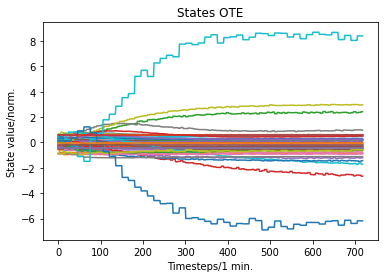

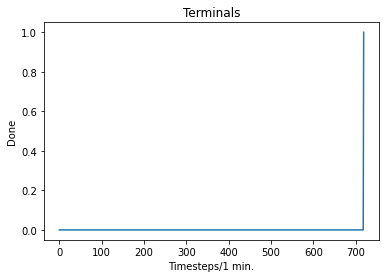

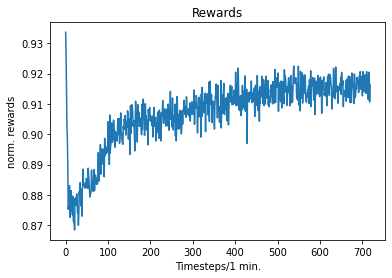

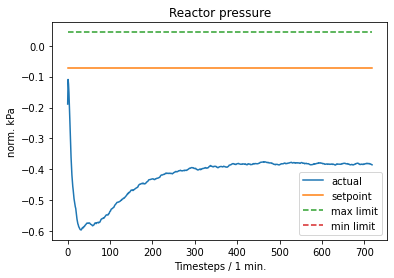

...

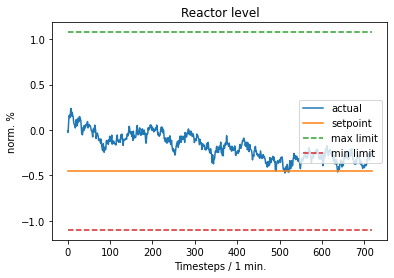

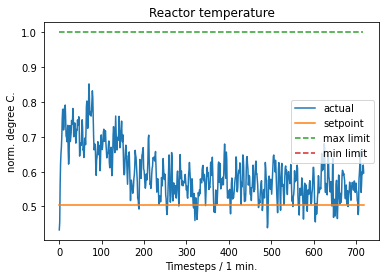

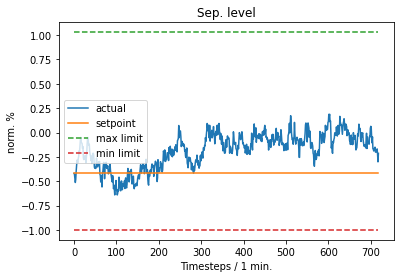

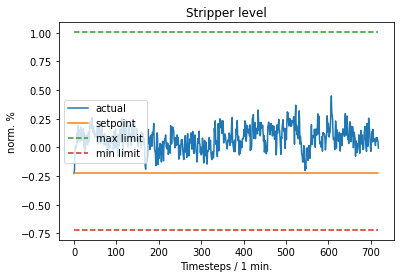

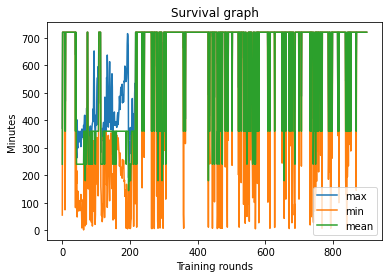

Iteration: 6701,  Mean reward: 645.61669921875, Mean Entropy: -0.9731292724609375, complete_episode_count: 1.0, Gather time: 3.32s, Train time: 20.35s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.8268572092056274 vs. Entropy_factor: -9.731292084325105e-05
Iteration: 6702,  Mean reward: 642.133056640625, Mean Entropy: -0.9730167388916016, complete_episode_count: 1.0, Gather time: 3.13s, Train time: 19.50s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.06146689131855965 vs. Entropy_factor: -9.730167221277952e-05
Iteration: 6703,  Mean reward: 656.1898193359375, Mean Entropy: -0.9731101989746094, complete_episode_count: 1.0, Gather time: 3.10s, Train time: 19.73s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.38579973578453064 vs. Entropy_factor: -9.731100726639852e-05
Iteration: 6704,  Mean reward: 657.2349853515625, Mean Entropy: -0.9729557037353516, complete_episode_count: 1.0, Gathe

Iteration: 6729,  Mean reward: 664.1773071289062, Mean Entropy: -0.9698505401611328, complete_episode_count: 1.0, Gather time: 3.15s, Train time: 19.19s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.3214450478553772 vs. Entropy_factor: -9.69850443652831e-05
Iteration: 6730,  Mean reward: 667.5889892578125, Mean Entropy: -0.9694995880126953, complete_episode_count: 1.0, Gather time: 3.24s, Train time: 19.20s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.811683416366577 vs. Entropy_factor: -9.694996697362512e-05
Iteration: 6731,  Mean reward: 664.6544799804688, Mean Entropy: -0.9693069458007812, complete_episode_count: 1.0, Gather time: 3.05s, Train time: 19.67s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -2.420966863632202 vs. Entropy_factor: -9.693070023786277e-05
Iteration: 6732,  Mean reward: 662.9965209960938, Mean Entropy: -0.9689350128173828, complete_episode_count: 1.0, Gather ti

Iteration: 6757,  Mean reward: 668.8975219726562, Mean Entropy: -0.964569091796875, complete_episode_count: 1.0, Gather time: 3.17s, Train time: 19.35s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 3.404806613922119 vs. Entropy_factor: -9.645690442994237e-05
Iteration: 6758,  Mean reward: 659.431396484375, Mean Entropy: -0.9644927978515625, complete_episode_count: 1.0, Gather time: 3.05s, Train time: 19.79s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.016732554882764816 vs. Entropy_factor: -9.64492792263627e-05
Iteration: 6759,  Mean reward: 666.4100952148438, Mean Entropy: -0.9644184112548828, complete_episode_count: 1.0, Gather time: 2.97s, Train time: 19.10s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -2.808577299118042 vs. Entropy_factor: -9.64418359217234e-05
Iteration: 6760,  Mean reward: 667.1718139648438, Mean Entropy: -0.9643135070800781, complete_episode_count: 1.0, Gather tim

Iteration: 6785,  Mean reward: 654.5277099609375, Mean Entropy: -0.9613418579101562, complete_episode_count: 1.0, Gather time: 3.25s, Train time: 19.61s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.1178621053695679 vs. Entropy_factor: -9.613419388188049e-05
Iteration: 6786,  Mean reward: 649.0462646484375, Mean Entropy: -0.9614067077636719, complete_episode_count: 1.0, Gather time: 3.44s, Train time: 19.42s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.1061520129442215 vs. Entropy_factor: -9.614066948415712e-05
Iteration: 6787,  Mean reward: 658.998046875, Mean Entropy: -0.9611835479736328, complete_episode_count: 1.0, Gather time: 3.11s, Train time: 19.65s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.08934937417507172 vs. Entropy_factor: -9.611836139811203e-05
Iteration: 6788,  Mean reward: 656.9619140625, Mean Entropy: -0.9607639312744141, complete_episode_count: 1.0, Gather time

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


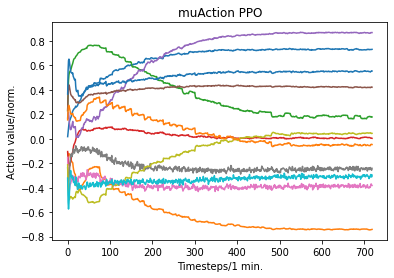

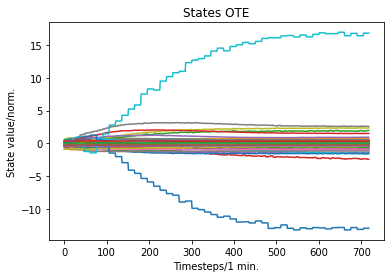

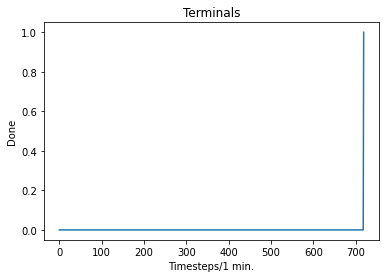

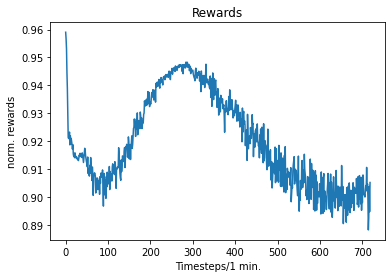

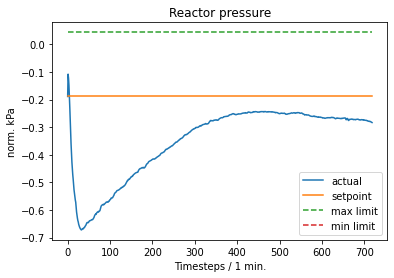

...

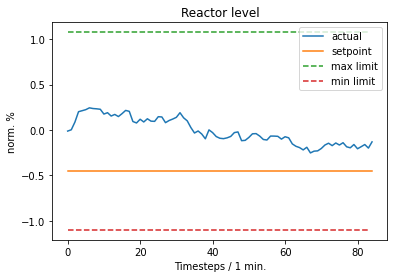

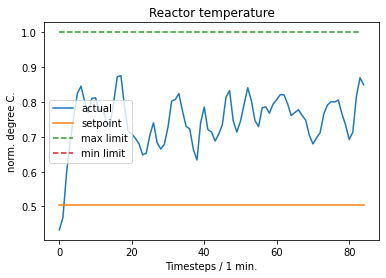

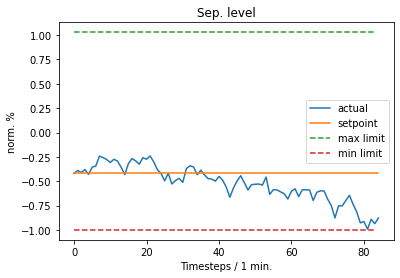

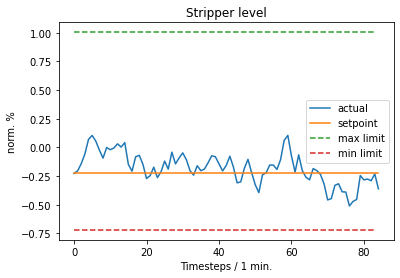

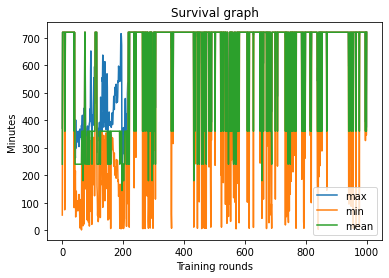

Iteration: 6801,  Mean reward: 650.7891235351562, Mean Entropy: -0.9582366943359375, complete_episode_count: 1.0, Gather time: 3.09s, Train time: 19.79s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.7774074077606201 vs. Entropy_factor: -9.582367056282237e-05
Iteration: 6802,  Mean reward: 652.1699829101562, Mean Entropy: -0.9583301544189453, complete_episode_count: 1.0, Gather time: 3.31s, Train time: 19.60s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.005600547883659601 vs. Entropy_factor: -9.58330201683566e-05
Iteration: 6803,  Mean reward: 642.8904418945312, Mean Entropy: -0.9578037261962891, complete_episode_count: 1.0, Gather time: 3.07s, Train time: 19.92s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.6546406149864197 vs. Entropy_factor: -9.578036406310275e-05
Iteration: 6804,  Mean reward: 645.929443359375, Mean Entropy: -0.9575538635253906, complete_episode_count: 1.0, Gathe

Iteration: 6829,  Mean reward: 634.080078125, Mean Entropy: -0.9552135467529297, complete_episode_count: 1.0, Gather time: 3.26s, Train time: 19.49s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.6244275569915771 vs. Entropy_factor: -9.552134724799544e-05
Iteration: 6830,  Mean reward: 623.7313232421875, Mean Entropy: -0.9552402496337891, complete_episode_count: 1.0, Gather time: 3.06s, Train time: 19.65s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -4.311479568481445 vs. Entropy_factor: -9.552401752443984e-05
Iteration: 6831,  Mean reward: 629.45263671875, Mean Entropy: -0.9551506042480469, complete_episode_count: 1.0, Gather time: 2.99s, Train time: 19.62s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.266005277633667 vs. Entropy_factor: -9.551505354465917e-05
Iteration: 6832,  Mean reward: 639.4317016601562, Mean Entropy: -0.9550247192382812, complete_episode_count: 1.0, Gather time:

Iteration: 6857,  Mean reward: 649.6253051757812, Mean Entropy: -0.9514427185058594, complete_episode_count: 1.0, Gather time: 2.94s, Train time: 18.34s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.0172212366014719 vs. Entropy_factor: -9.514427074464038e-05
Iteration: 6858,  Mean reward: 626.8965454101562, Mean Entropy: -0.9514141082763672, complete_episode_count: 1.0, Gather time: 2.87s, Train time: 17.95s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.740981101989746 vs. Entropy_factor: -9.5141411293298e-05
Iteration: 6859,  Mean reward: 646.5768432617188, Mean Entropy: -0.9512290954589844, complete_episode_count: 1.0, Gather time: 2.82s, Train time: 17.09s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.00486756581813097 vs. Entropy_factor: -9.512290853308514e-05
Iteration: 6860,  Mean reward: 650.582763671875, Mean Entropy: -0.9513893127441406, complete_episode_count: 1.0, Gather ti

Iteration: 6886,  Mean reward: 636.8638916015625, Mean Entropy: -0.9458160400390625, complete_episode_count: 1.0, Gather time: 2.77s, Train time: 17.56s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.436521291732788 vs. Entropy_factor: -9.458160639042035e-05
Iteration: 6887,  Mean reward: 638.12451171875, Mean Entropy: -0.9455833435058594, complete_episode_count: 1.0, Gather time: 2.76s, Train time: 17.45s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.13670209050178528 vs. Entropy_factor: -9.455833787797019e-05
Iteration: 6888,  Mean reward: 651.0422973632812, Mean Entropy: -0.9454135894775391, complete_episode_count: 1.0, Gather time: 2.91s, Train time: 17.83s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.605706810951233 vs. Entropy_factor: -9.454135579289868e-05
Iteration: 6889,  Mean reward: 642.185791015625, Mean Entropy: -0.9454097747802734, complete_episode_count: 1.0, Gather tim

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


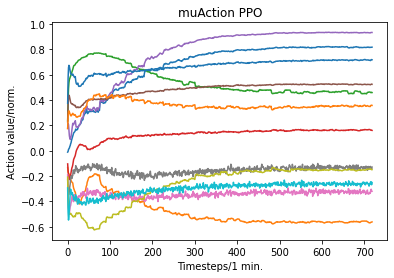

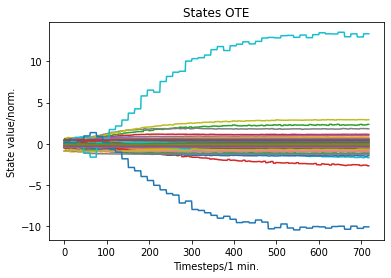

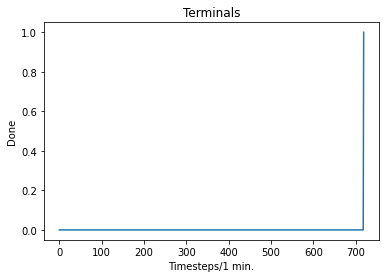

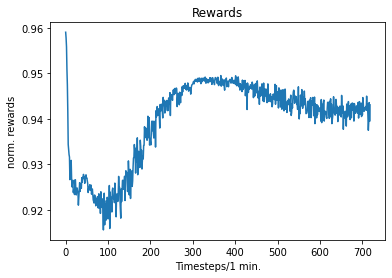

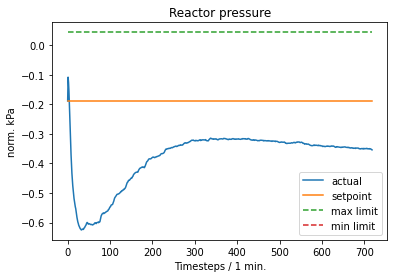

...

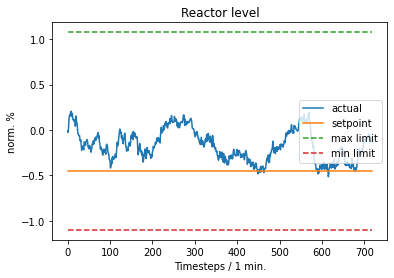

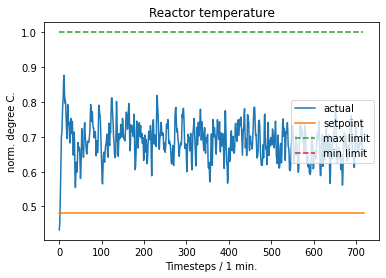

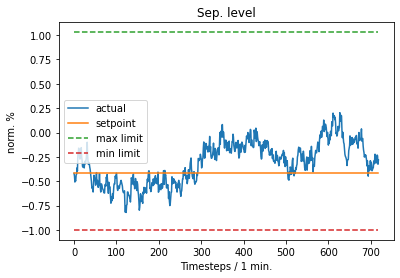

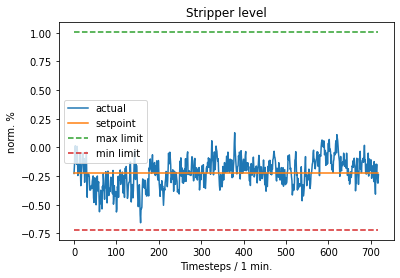

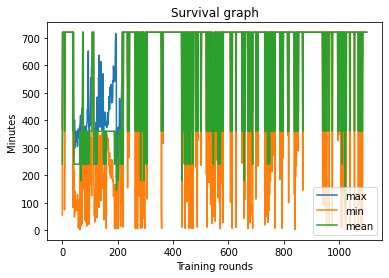

Iteration: 6901,  Mean reward: 671.1369018554688, Mean Entropy: -0.9435138702392578, complete_episode_count: 1.0, Gather time: 2.64s, Train time: 17.77s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.8243510723114014 vs. Entropy_factor: -9.435138053959236e-05
Iteration: 6902,  Mean reward: 666.4462890625, Mean Entropy: -0.9433269500732422, complete_episode_count: 1.0, Gather time: 2.66s, Train time: 17.58s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -6.353420734405518 vs. Entropy_factor: -9.433268860448152e-05
Iteration: 6903,  Mean reward: 660.8489990234375, Mean Entropy: -0.9431095123291016, complete_episode_count: 1.0, Gather time: 2.83s, Train time: 17.61s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.5401527881622314 vs. Entropy_factor: -9.431095531908795e-05
Iteration: 6904,  Mean reward: 567.375244140625, Mean Entropy: -0.9425811767578125, complete_episode_count: 1.0, Gather time

Iteration: 6930,  Mean reward: 313.6598205566406, Mean Entropy: -0.9386425018310547, complete_episode_count: 2.0, Gather time: 2.74s, Train time: 15.32s,Max episode: 618min., Min episode: 19min., Mean episode: 240.00min.PPO_clip: -2.6716842651367188 vs. Entropy_factor: -9.386425517732278e-05
Iteration: 6931,  Mean reward: 545.319580078125, Mean Entropy: -0.9384593963623047, complete_episode_count: 1.0, Gather time: 2.95s, Train time: 17.59s,Max episode: 604min., Min episode: 116min., Mean episode: 360.00min.PPO_clip: 1.5706446170806885 vs. Entropy_factor: -9.384593431605026e-05
Iteration: 6932,  Mean reward: 649.8265991210938, Mean Entropy: -0.9382095336914062, complete_episode_count: 1.0, Gather time: 2.79s, Train time: 17.49s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 3.182426929473877 vs. Entropy_factor: -9.382095595356077e-05
Iteration: 6933,  Mean reward: 530.1394653320312, Mean Entropy: -0.9380149841308594, complete_episode_count: 1.0, Gather ti

Iteration: 6958,  Mean reward: 414.54669189453125, Mean Entropy: -0.9342098236083984, complete_episode_count: 1.0, Gather time: 2.77s, Train time: 17.58s,Max episode: 471min., Min episode: 249min., Mean episode: 360.00min.PPO_clip: -1.0600026845932007 vs. Entropy_factor: -9.342097473563626e-05
Iteration: 6959,  Mean reward: 380.6169128417969, Mean Entropy: -0.9338817596435547, complete_episode_count: 1.0, Gather time: 3.00s, Train time: 17.31s,Max episode: 424min., Min episode: 296min., Mean episode: 360.00min.PPO_clip: -0.022956538945436478 vs. Entropy_factor: -9.338818199466914e-05
Iteration: 6960,  Mean reward: 401.4859619140625, Mean Entropy: -0.9338665008544922, complete_episode_count: 1.0, Gather time: 2.61s, Train time: 17.49s,Max episode: 453min., Min episode: 267min., Mean episode: 360.00min.PPO_clip: -0.6164838075637817 vs. Entropy_factor: -9.338663949165493e-05
Iteration: 6961,  Mean reward: 270.09002685546875, Mean Entropy: -0.9338665008544922, complete_episode_count: 2.0, 

Iteration: 6986,  Mean reward: 649.4496459960938, Mean Entropy: -0.9302692413330078, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.55s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.1644114255905151 vs. Entropy_factor: -9.30269161472097e-05
Iteration: 6987,  Mean reward: 470.5578918457031, Mean Entropy: -0.9299507141113281, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.53s,Max episode: 513min., Min episode: 207min., Mean episode: 360.00min.PPO_clip: -0.2898445427417755 vs. Entropy_factor: -9.299506928073242e-05
Iteration: 6988,  Mean reward: 545.0616455078125, Mean Entropy: -0.9300117492675781, complete_episode_count: 1.0, Gather time: 2.78s, Train time: 17.50s,Max episode: 593min., Min episode: 127min., Mean episode: 360.00min.PPO_clip: 3.250072479248047 vs. Entropy_factor: -9.300117380917072e-05
Iteration: 6989,  Mean reward: 655.0326538085938, Mean Entropy: -0.9302158355712891, complete_episode_count: 1.0, Gather 

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


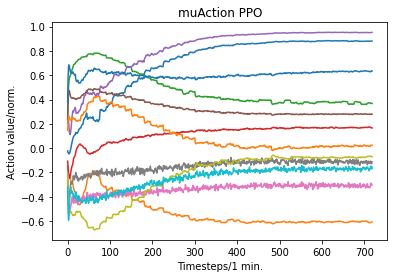

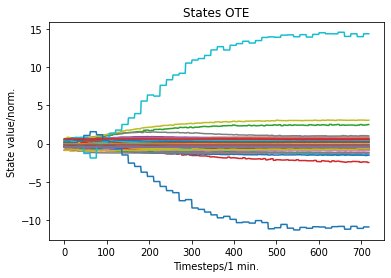

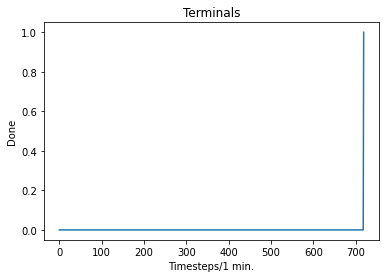

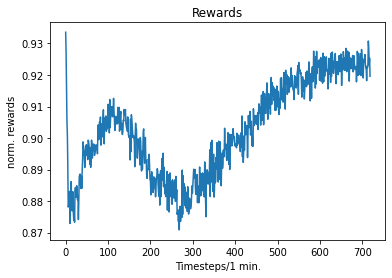

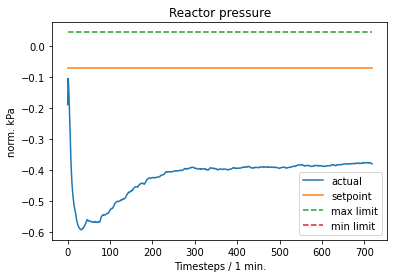

...

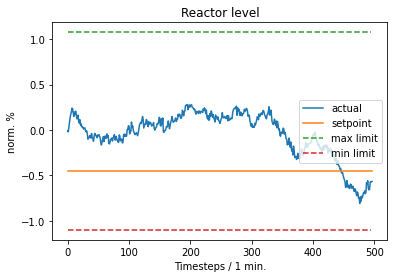

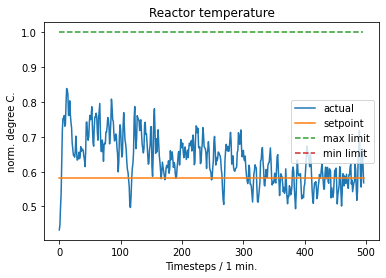

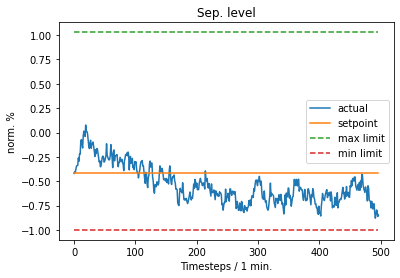

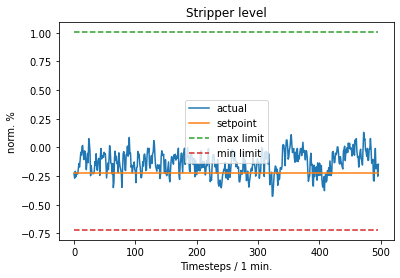

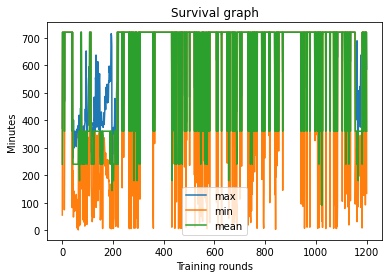

Iteration: 7001,  Mean reward: 498.6909484863281, Mean Entropy: -0.9281501770019531, complete_episode_count: 1.0, Gather time: 2.72s, Train time: 17.40s,Max episode: 550min., Min episode: 170min., Mean episode: 360.00min.PPO_clip: -2.7969470024108887 vs. Entropy_factor: -9.281501843361184e-05
Iteration: 7002,  Mean reward: 388.00738525390625, Mean Entropy: -0.9278049468994141, complete_episode_count: 1.0, Gather time: 2.88s, Train time: 17.28s,Max episode: 437min., Min episode: 283min., Mean episode: 360.00min.PPO_clip: -5.959246635437012 vs. Entropy_factor: -9.278050129069015e-05
Iteration: 7003,  Mean reward: 653.8742065429688, Mean Entropy: -0.9282245635986328, complete_episode_count: 1.0, Gather time: 2.73s, Train time: 17.45s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 3.682605266571045 vs. Entropy_factor: -9.282246173825115e-05
Iteration: 7004,  Mean reward: 645.4949951171875, Mean Entropy: -0.9282073974609375, complete_episode_count: 1.0, Gather

Iteration: 7029,  Mean reward: 665.2078857421875, Mean Entropy: -0.9238357543945312, complete_episode_count: 1.0, Gather time: 2.91s, Train time: 17.49s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.022894572466611862 vs. Entropy_factor: -9.238358325092122e-05
Iteration: 7030,  Mean reward: 662.713134765625, Mean Entropy: -0.9235019683837891, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.50s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.1202717050909996 vs. Entropy_factor: -9.235018660547212e-05
Iteration: 7031,  Mean reward: 625.8866577148438, Mean Entropy: -0.9232845306396484, complete_episode_count: 1.0, Gather time: 2.85s, Train time: 17.37s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.621012806892395 vs. Entropy_factor: -9.232846059603617e-05
Iteration: 7032,  Mean reward: 658.2672729492188, Mean Entropy: -0.9230327606201172, complete_episode_count: 1.0, Gathe

Iteration: 7057,  Mean reward: 576.65185546875, Mean Entropy: -0.9189987182617188, complete_episode_count: 1.0, Gather time: 2.94s, Train time: 17.46s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -3.664771318435669 vs. Entropy_factor: -9.18998775887303e-05
Iteration: 7058,  Mean reward: 559.2268676757812, Mean Entropy: -0.9189548492431641, complete_episode_count: 1.0, Gather time: 2.73s, Train time: 16.87s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.37206318974494934 vs. Entropy_factor: -9.189547563437372e-05
Iteration: 7059,  Mean reward: 565.641845703125, Mean Entropy: -0.9188671112060547, complete_episode_count: 1.0, Gather time: 2.76s, Train time: 17.62s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -2.121654987335205 vs. Entropy_factor: -9.188671538140625e-05
Iteration: 7060,  Mean reward: 444.8483581542969, Mean Entropy: -0.9185676574707031, complete_episode_count: 1.0, Gather tim

Iteration: 7086,  Mean reward: 5.154573917388916, Mean Entropy: -0.9154853820800781, complete_episode_count: 1.0, Gather time: 2.92s, Train time: 17.37s,Max episode: 713min., Min episode: 7min., Mean episode: 360.00min.PPO_clip: 1.907038927078247 vs. Entropy_factor: -9.154853614745662e-05
Iteration: 7087,  Mean reward: 595.6904907226562, Mean Entropy: -0.9151878356933594, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.62s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.3766216039657593 vs. Entropy_factor: -9.151879203272983e-05
Iteration: 7088,  Mean reward: 601.7405395507812, Mean Entropy: -0.9149703979492188, complete_episode_count: 1.0, Gather time: 2.87s, Train time: 17.61s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.39904120564460754 vs. Entropy_factor: -9.149703691946343e-05
Iteration: 7089,  Mean reward: 601.3538208007812, Mean Entropy: -0.914764404296875, complete_episode_count: 1.0, Gather ti

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


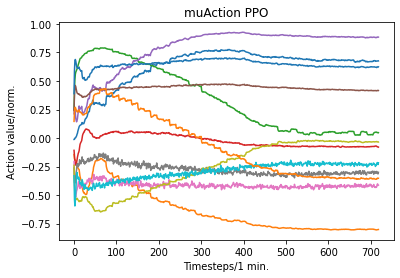

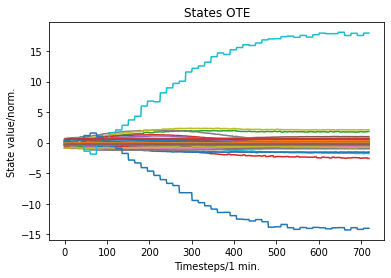

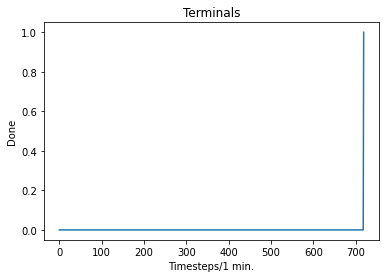

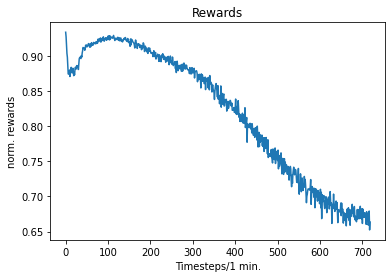

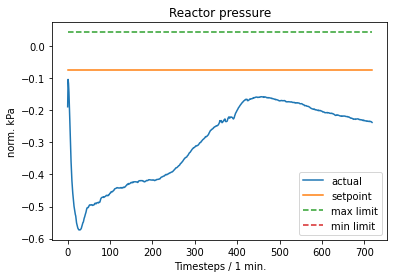

...

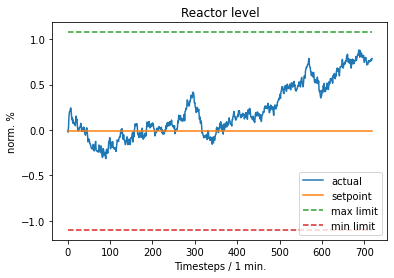

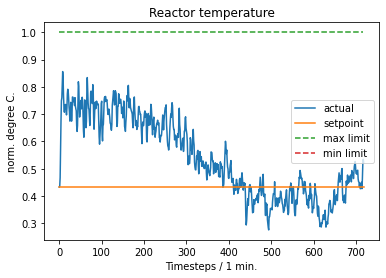

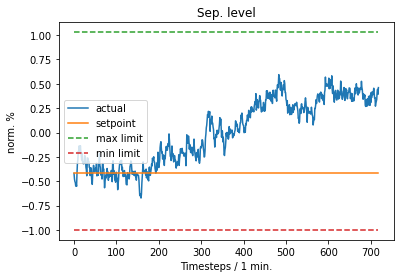

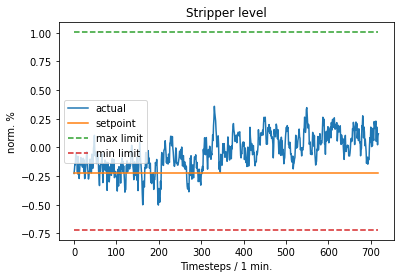

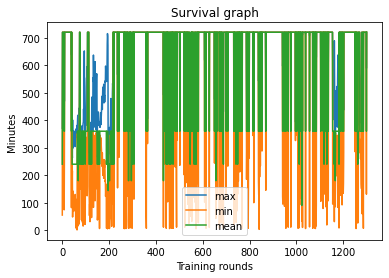

Iteration: 7101,  Mean reward: 611.4129638671875, Mean Entropy: -0.9136104583740234, complete_episode_count: 1.0, Gather time: 2.75s, Train time: 17.55s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.04985618591308594 vs. Entropy_factor: -9.136104927165434e-05
Iteration: 7102,  Mean reward: 614.6154174804688, Mean Entropy: -0.9132900238037109, complete_episode_count: 1.0, Gather time: 2.88s, Train time: 17.50s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.6374222636222839 vs. Entropy_factor: -9.132899140240625e-05
Iteration: 7103,  Mean reward: 4.428391456604004, Mean Entropy: -0.913360595703125, complete_episode_count: 1.0, Gather time: 2.73s, Train time: 17.65s,Max episode: 714min., Min episode: 6min., Mean episode: 360.00min.PPO_clip: -1.0193049907684326 vs. Entropy_factor: -9.133606363320723e-05
Iteration: 7104,  Mean reward: 605.9383544921875, Mean Entropy: -0.9129276275634766, complete_episode_count: 1.0, Gather

Iteration: 7129,  Mean reward: 631.0352783203125, Mean Entropy: -0.9092617034912109, complete_episode_count: 1.0, Gather time: 2.73s, Train time: 17.88s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.12408383190631866 vs. Entropy_factor: -9.092617256101221e-05
Iteration: 7130,  Mean reward: 630.9129638671875, Mean Entropy: -0.9090366363525391, complete_episode_count: 1.0, Gather time: 2.75s, Train time: 17.61s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -4.647149085998535 vs. Entropy_factor: -9.090366074815392e-05
Iteration: 7131,  Mean reward: 267.3359069824219, Mean Entropy: -0.9086875915527344, complete_episode_count: 2.0, Gather time: 2.85s, Train time: 15.36s,Max episode: 490min., Min episode: 102min., Mean episode: 240.00min.PPO_clip: -2.682615041732788 vs. Entropy_factor: -9.086875070352107e-05
Iteration: 7132,  Mean reward: 646.1519775390625, Mean Entropy: -0.9084262847900391, complete_episode_count: 1.0, Gather

Iteration: 7158,  Mean reward: 414.6211242675781, Mean Entropy: -0.9054775238037109, complete_episode_count: 1.0, Gather time: 2.85s, Train time: 17.47s,Max episode: 453min., Min episode: 267min., Mean episode: 360.00min.PPO_clip: -1.1849740743637085 vs. Entropy_factor: -9.054774272954091e-05
Iteration: 7159,  Mean reward: 669.546142578125, Mean Entropy: -0.9051475524902344, complete_episode_count: 1.0, Gather time: 2.85s, Train time: 17.56s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.4920907020568848 vs. Entropy_factor: -9.051476081367582e-05
Iteration: 7160,  Mean reward: 666.9192504882812, Mean Entropy: -0.9041805267333984, complete_episode_count: 1.0, Gather time: 2.79s, Train time: 17.56s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -2.343601703643799 vs. Entropy_factor: -9.041804150911048e-05
Iteration: 7161,  Mean reward: 662.6797485351562, Mean Entropy: -0.9040126800537109, complete_episode_count: 1.0, Gather 

Iteration: 7186,  Mean reward: 663.661865234375, Mean Entropy: -0.9003047943115234, complete_episode_count: 1.0, Gather time: 2.77s, Train time: 17.66s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.4193507134914398 vs. Entropy_factor: -9.003048035083339e-05
Iteration: 7187,  Mean reward: 664.7302856445312, Mean Entropy: -0.9002285003662109, complete_episode_count: 1.0, Gather time: 2.88s, Train time: 17.67s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.39629530906677246 vs. Entropy_factor: -9.002285514725372e-05
Iteration: 7188,  Mean reward: 500.56256103515625, Mean Entropy: -0.9000091552734375, complete_episode_count: 1.0, Gather time: 2.84s, Train time: 17.73s,Max episode: 541min., Min episode: 179min., Mean episode: 360.00min.PPO_clip: -0.4133085310459137 vs. Entropy_factor: -9.000091085908934e-05
Iteration: 7189,  Mean reward: 641.1453857421875, Mean Entropy: -0.8998546600341797, complete_episode_count: 1.0, Gath

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


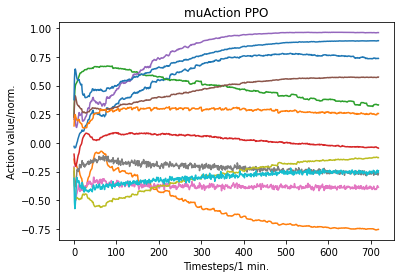

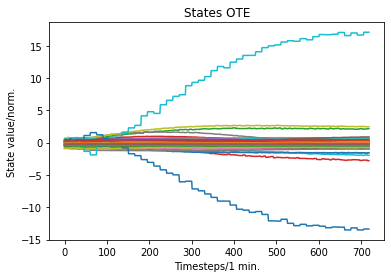

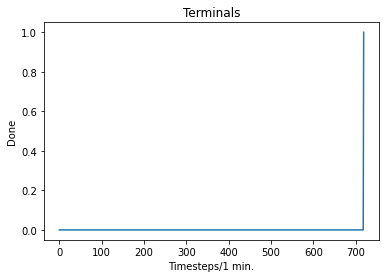

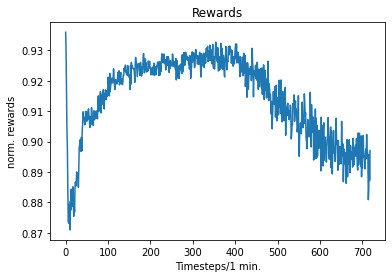

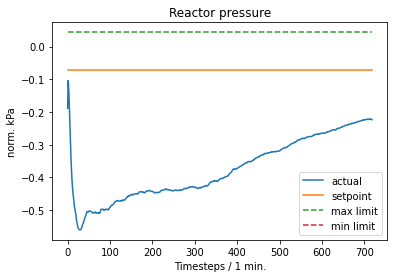

...

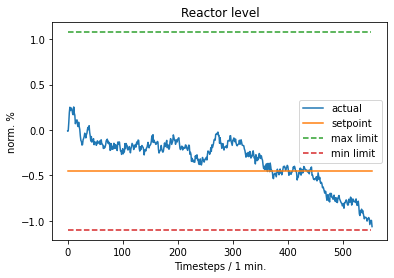

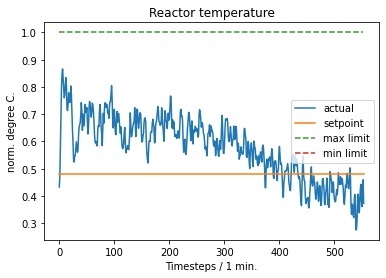

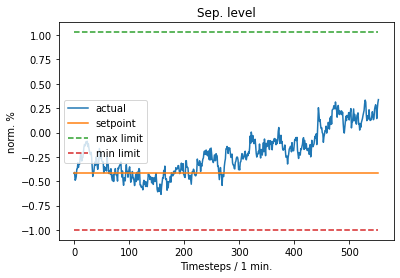

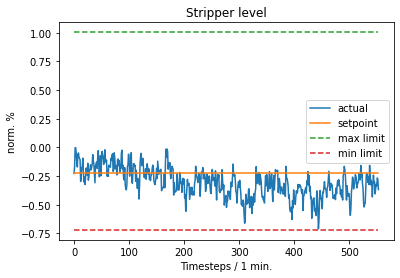

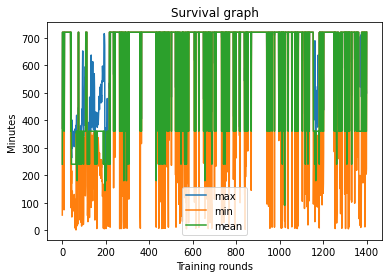

Iteration: 7201,  Mean reward: 652.999755859375, Mean Entropy: -0.897918701171875, complete_episode_count: 1.0, Gather time: 2.61s, Train time: 17.87s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.9708917737007141 vs. Entropy_factor: -8.979185804491863e-05
Iteration: 7202,  Mean reward: 659.8821411132812, Mean Entropy: -0.8979129791259766, complete_episode_count: 1.0, Gather time: 2.56s, Train time: 17.53s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -3.0439138412475586 vs. Entropy_factor: -8.979130507213995e-05
Iteration: 7203,  Mean reward: 636.017822265625, Mean Entropy: -0.8979072570800781, complete_episode_count: 1.0, Gather time: 2.79s, Train time: 17.54s,Max episode: 698min., Min episode: 22min., Mean episode: 360.00min.PPO_clip: -0.20075401663780212 vs. Entropy_factor: -8.979072299553081e-05
Iteration: 7204,  Mean reward: 657.9547119140625, Mean Entropy: -0.89776611328125, complete_episode_count: 1.0, Gather tim

Iteration: 7230,  Mean reward: 491.7398681640625, Mean Entropy: -0.8920173645019531, complete_episode_count: 1.0, Gather time: 2.94s, Train time: 17.81s,Max episode: 533min., Min episode: 187min., Mean episode: 360.00min.PPO_clip: -0.9997187852859497 vs. Entropy_factor: -8.920173422666267e-05
Iteration: 7231,  Mean reward: 673.042236328125, Mean Entropy: -0.8919639587402344, complete_episode_count: 1.0, Gather time: 2.83s, Train time: 17.34s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 6.2345781326293945 vs. Entropy_factor: -8.919638639781624e-05
Iteration: 7232,  Mean reward: 6.977409362792969, Mean Entropy: -0.8919239044189453, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.65s,Max episode: 711min., Min episode: 9min., Mean episode: 360.00min.PPO_clip: 0.3999630808830261 vs. Entropy_factor: -8.919239189708605e-05
Iteration: 7233,  Mean reward: 670.1399536132812, Mean Entropy: -0.8917713165283203, complete_episode_count: 1.0, Gather ti

Iteration: 7258,  Mean reward: 669.701171875, Mean Entropy: -0.8887443542480469, complete_episode_count: 1.0, Gather time: 2.84s, Train time: 17.30s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.05198290944099426 vs. Entropy_factor: -8.887443254934624e-05
Iteration: 7259,  Mean reward: 671.5284423828125, Mean Entropy: -0.8886089324951172, complete_episode_count: 1.0, Gather time: 2.89s, Train time: 17.54s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.19391147792339325 vs. Entropy_factor: -8.886088471626863e-05
Iteration: 7260,  Mean reward: 669.376953125, Mean Entropy: -0.8884639739990234, complete_episode_count: 1.0, Gather time: 2.74s, Train time: 17.52s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.30023613572120667 vs. Entropy_factor: -8.88464055606164e-05
Iteration: 7261,  Mean reward: 668.2142944335938, Mean Entropy: -0.8880138397216797, complete_episode_count: 1.0, Gather time

Iteration: 7286,  Mean reward: 667.894775390625, Mean Entropy: -0.8853931427001953, complete_episode_count: 1.0, Gather time: 2.88s, Train time: 17.52s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.22704482078552246 vs. Entropy_factor: -8.853931649355218e-05
Iteration: 7287,  Mean reward: 652.8641967773438, Mean Entropy: -0.8854598999023438, complete_episode_count: 1.0, Gather time: 2.83s, Train time: 17.49s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.9114547967910767 vs. Entropy_factor: -8.854598127072677e-05
Iteration: 7288,  Mean reward: 662.5213012695312, Mean Entropy: -0.8853988647460938, complete_episode_count: 1.0, Gather time: 2.74s, Train time: 17.58s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.06872839480638504 vs. Entropy_factor: -8.85398912942037e-05
Iteration: 7289,  Mean reward: 660.4434814453125, Mean Entropy: -0.8854408264160156, complete_episode_count: 1.0, Gathe

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


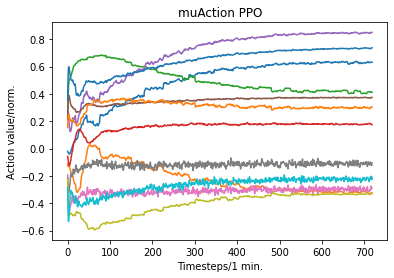

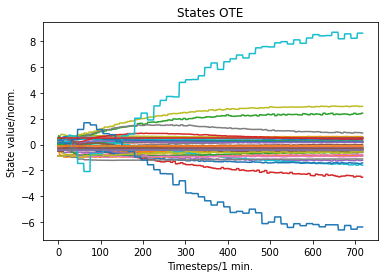

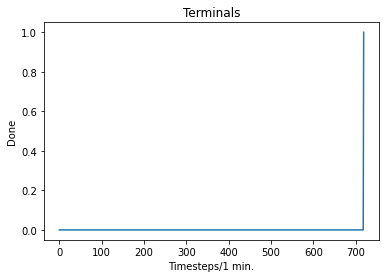

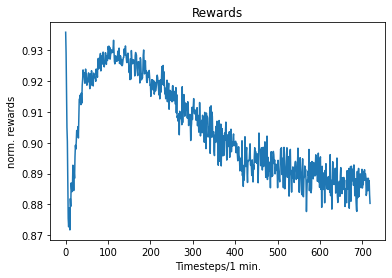

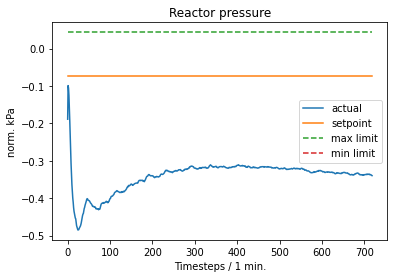

...

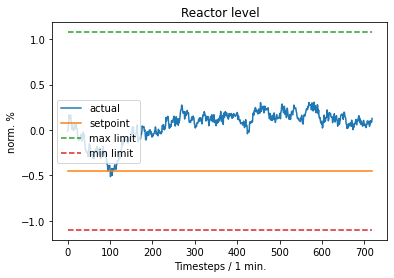

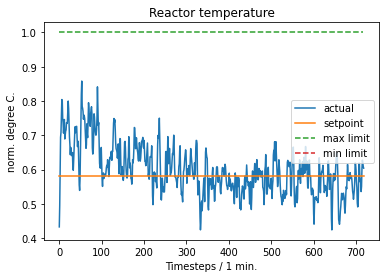

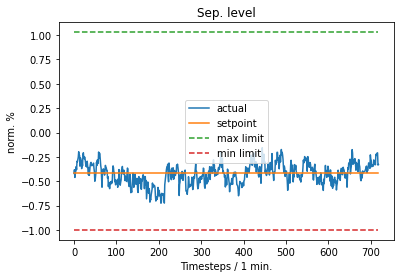

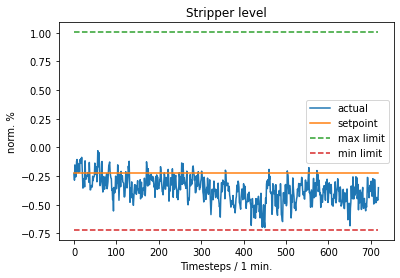

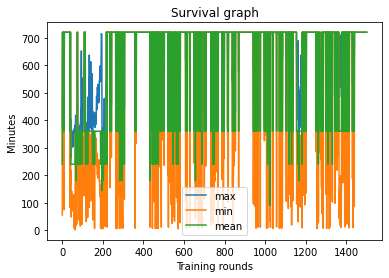

Iteration: 7301,  Mean reward: 654.4201049804688, Mean Entropy: -0.8832263946533203, complete_episode_count: 1.0, Gather time: 2.78s, Train time: 17.51s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.1106441020965576 vs. Entropy_factor: -8.832263119984418e-05
Iteration: 7302,  Mean reward: 679.2523803710938, Mean Entropy: -0.882904052734375, complete_episode_count: 1.0, Gather time: 2.68s, Train time: 17.70s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.9678804278373718 vs. Entropy_factor: -8.829041325952858e-05
Iteration: 7303,  Mean reward: 651.9392700195312, Mean Entropy: -0.8826313018798828, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.59s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.726538062095642 vs. Entropy_factor: -8.826312841847539e-05
Iteration: 7304,  Mean reward: 679.312255859375, Mean Entropy: -0.8825931549072266, complete_episode_count: 1.0, Gather ti

Iteration: 7329,  Mean reward: 646.7093505859375, Mean Entropy: -0.8788185119628906, complete_episode_count: 1.0, Gather time: 2.99s, Train time: 17.53s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.2668907344341278 vs. Entropy_factor: -8.788185368757695e-05
Iteration: 7330,  Mean reward: 677.9442138671875, Mean Entropy: -0.87872314453125, complete_episode_count: 1.0, Gather time: 2.84s, Train time: 17.58s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 3.818298816680908 vs. Entropy_factor: -8.787231490714476e-05
Iteration: 7331,  Mean reward: 647.4572143554688, Mean Entropy: -0.8787479400634766, complete_episode_count: 1.0, Gather time: 2.77s, Train time: 17.45s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -2.916330575942993 vs. Entropy_factor: -8.787478145677596e-05
Iteration: 7332,  Mean reward: 678.6776123046875, Mean Entropy: -0.8788108825683594, complete_episode_count: 1.0, Gather ti

Iteration: 7357,  Mean reward: 672.1195678710938, Mean Entropy: -0.87384033203125, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.44s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -2.1416380405426025 vs. Entropy_factor: -8.73840253916569e-05
Iteration: 7358,  Mean reward: 671.1217041015625, Mean Entropy: -0.8737239837646484, complete_episode_count: 1.0, Gather time: 2.72s, Train time: 17.45s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.41852623224258423 vs. Entropy_factor: -8.737239113543183e-05
Iteration: 7359,  Mean reward: 667.4926147460938, Mean Entropy: -0.8734760284423828, complete_episode_count: 1.0, Gather time: 2.92s, Train time: 17.52s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.12095196545124054 vs. Entropy_factor: -8.734759467188269e-05
Iteration: 7360,  Mean reward: 657.93798828125, Mean Entropy: -0.8736896514892578, complete_episode_count: 1.0, Gather ti

Iteration: 7385,  Mean reward: 678.0926513671875, Mean Entropy: -0.8703060150146484, complete_episode_count: 1.0, Gather time: 2.91s, Train time: 17.31s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.5513332486152649 vs. Entropy_factor: -8.703058847459033e-05
Iteration: 7386,  Mean reward: 671.3533325195312, Mean Entropy: -0.8698978424072266, complete_episode_count: 1.0, Gather time: 2.79s, Train time: 17.45s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.1014954224228859 vs. Entropy_factor: -8.698978490428999e-05
Iteration: 7387,  Mean reward: 669.9149780273438, Mean Entropy: -0.8694343566894531, complete_episode_count: 1.0, Gather time: 2.77s, Train time: 17.60s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.06350906193256378 vs. Entropy_factor: -8.694343705428764e-05
Iteration: 7388,  Mean reward: 668.2457885742188, Mean Entropy: -0.8692378997802734, complete_episode_count: 1.0, Gath

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


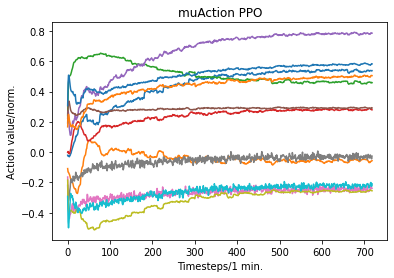

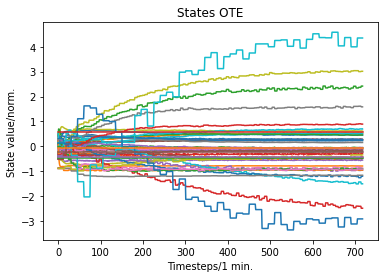

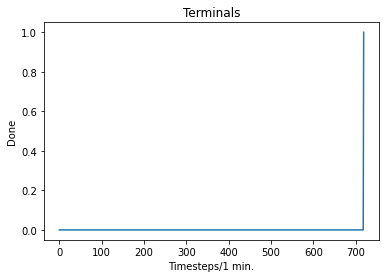

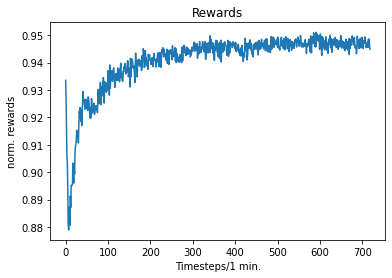

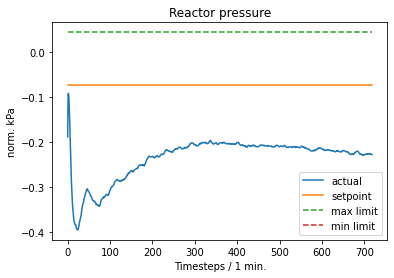

...

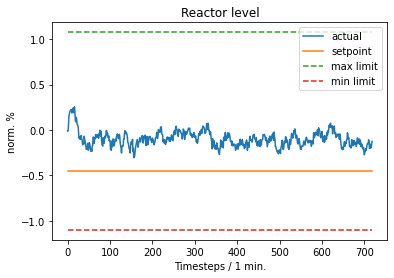

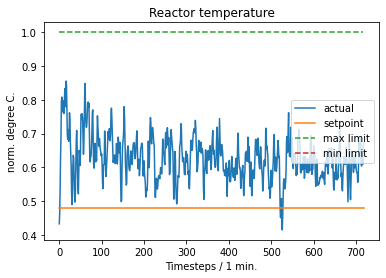

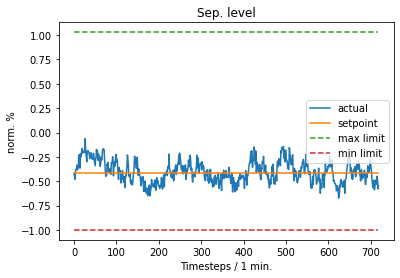

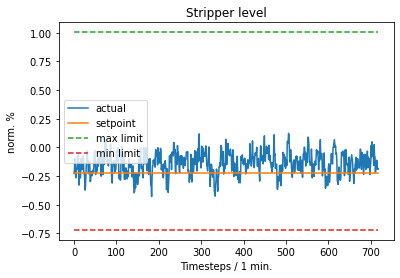

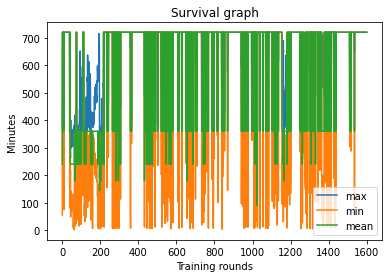

Iteration: 7401,  Mean reward: 674.500244140625, Mean Entropy: -0.8666667938232422, complete_episode_count: 1.0, Gather time: 2.74s, Train time: 17.36s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.7114506363868713 vs. Entropy_factor: -8.666667417855933e-05
Iteration: 7402,  Mean reward: 667.4005126953125, Mean Entropy: -0.8664531707763672, complete_episode_count: 1.0, Gather time: 2.76s, Train time: 17.71s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.6454216241836548 vs. Entropy_factor: -8.664531196700409e-05
Iteration: 7403,  Mean reward: 670.46630859375, Mean Entropy: -0.8663082122802734, complete_episode_count: 1.0, Gather time: 2.93s, Train time: 17.51s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.4514491558074951 vs. Entropy_factor: -8.663081825943664e-05
Iteration: 7404,  Mean reward: 5.236590385437012, Mean Entropy: -0.866119384765625, complete_episode_count: 1.0, Gather ti

Iteration: 7430,  Mean reward: 676.5140991210938, Mean Entropy: -0.8623485565185547, complete_episode_count: 1.0, Gather time: 2.89s, Train time: 17.39s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.5843396186828613 vs. Entropy_factor: -8.623486064607278e-05
Iteration: 7431,  Mean reward: 676.2883911132812, Mean Entropy: -0.8621406555175781, complete_episode_count: 1.0, Gather time: 2.76s, Train time: 17.37s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.08537887781858444 vs. Entropy_factor: -8.621405868325382e-05
Iteration: 7432,  Mean reward: 380.4657897949219, Mean Entropy: -0.8620967864990234, complete_episode_count: 1.0, Gather time: 2.89s, Train time: 17.62s,Max episode: 407min., Min episode: 313min., Mean episode: 360.00min.PPO_clip: -0.2415291965007782 vs. Entropy_factor: -8.620967855677009e-05
Iteration: 7433,  Mean reward: 677.6282958984375, Mean Entropy: -0.8618869781494141, complete_episode_count: 1.0, Gathe

Iteration: 7458,  Mean reward: 53.746421813964844, Mean Entropy: -0.8600559234619141, complete_episode_count: 1.0, Gather time: 2.78s, Train time: 17.25s,Max episode: 660min., Min episode: 60min., Mean episode: 360.00min.PPO_clip: 0.8261456489562988 vs. Entropy_factor: -8.600559522164986e-05
Iteration: 7459,  Mean reward: 670.2799682617188, Mean Entropy: -0.8599624633789062, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.51s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.4145375192165375 vs. Entropy_factor: -8.599623834015802e-05
Iteration: 7460,  Mean reward: 670.751708984375, Mean Entropy: -0.8598785400390625, complete_episode_count: 1.0, Gather time: 2.86s, Train time: 17.35s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.03850548714399338 vs. Entropy_factor: -8.598784916102886e-05
Iteration: 7461,  Mean reward: 655.9935913085938, Mean Entropy: -0.8596229553222656, complete_episode_count: 1.0, Gather 

Iteration: 7486,  Mean reward: 672.5723876953125, Mean Entropy: -0.8564186096191406, complete_episode_count: 1.0, Gather time: 2.84s, Train time: 17.43s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.8332744836807251 vs. Entropy_factor: -8.56418555486016e-05
Iteration: 7487,  Mean reward: 670.8184204101562, Mean Entropy: -0.8563213348388672, complete_episode_count: 1.0, Gather time: 2.76s, Train time: 17.49s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.2106861174106598 vs. Entropy_factor: -8.563213486922905e-05
Iteration: 7488,  Mean reward: 670.8170166015625, Mean Entropy: -0.8563213348388672, complete_episode_count: 1.0, Gather time: 2.83s, Train time: 17.74s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.2349210977554321 vs. Entropy_factor: -8.563213486922905e-05
Iteration: 7489,  Mean reward: 274.0627746582031, Mean Entropy: -0.8562183380126953, complete_episode_count: 1.0, Gather 

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


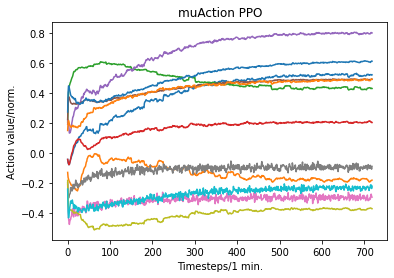

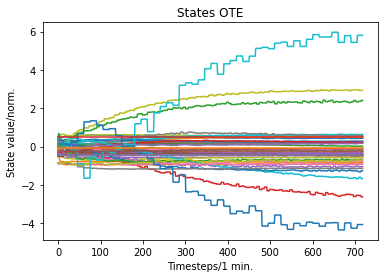

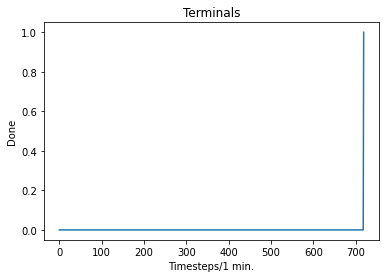

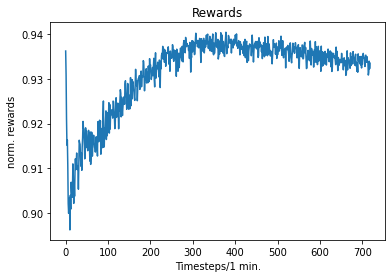

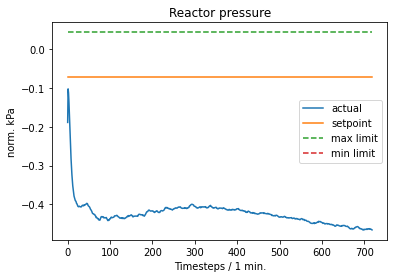

...

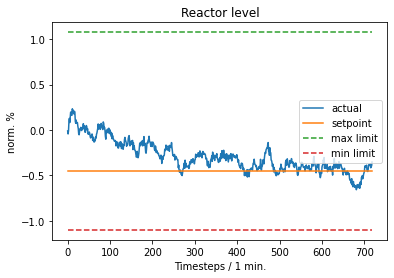

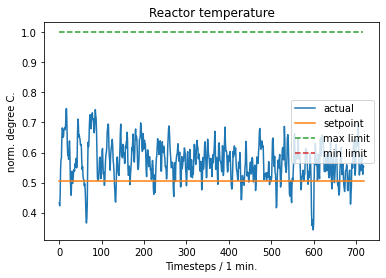

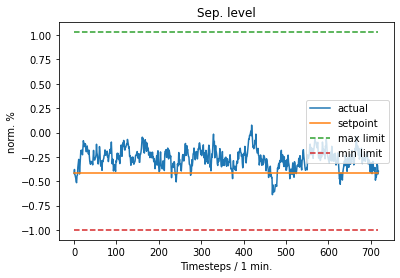

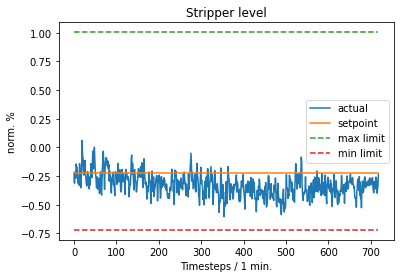

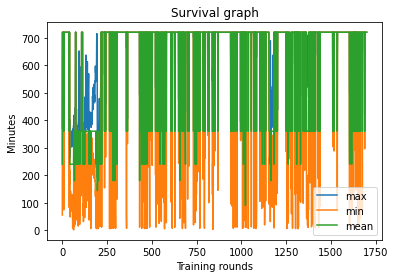

Iteration: 7501,  Mean reward: 665.9654541015625, Mean Entropy: -0.8549747467041016, complete_episode_count: 1.0, Gather time: 2.84s, Train time: 17.26s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.6965364813804626 vs. Entropy_factor: -8.549746416974813e-05
Iteration: 7502,  Mean reward: 665.7752685546875, Mean Entropy: -0.8547286987304688, complete_episode_count: 1.0, Gather time: 2.88s, Train time: 17.39s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.979716956615448 vs. Entropy_factor: -8.547287143301219e-05
Iteration: 7503,  Mean reward: 664.0930786132812, Mean Entropy: -0.8543987274169922, complete_episode_count: 1.0, Gather time: 2.96s, Train time: 17.44s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.4070345461368561 vs. Entropy_factor: -8.543987496523187e-05
Iteration: 7504,  Mean reward: 670.939697265625, Mean Entropy: -0.8542709350585938, complete_episode_count: 1.0, Gather t

Iteration: 7529,  Mean reward: 665.7456665039062, Mean Entropy: -0.8508377075195312, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.74s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.23823948204517365 vs. Entropy_factor: -8.508376777172089e-05
Iteration: 7530,  Mean reward: 666.9371948242188, Mean Entropy: -0.8504600524902344, complete_episode_count: 1.0, Gather time: 2.83s, Train time: 17.46s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.19832079112529755 vs. Entropy_factor: -8.504599827574566e-05
Iteration: 7531,  Mean reward: 667.6979370117188, Mean Entropy: -0.8505229949951172, complete_episode_count: 1.0, Gather time: 2.78s, Train time: 17.41s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.6214321851730347 vs. Entropy_factor: -8.505229197908193e-05
Iteration: 7532,  Mean reward: 665.11328125, Mean Entropy: -0.8503761291503906, complete_episode_count: 1.0, Gather t

Iteration: 7557,  Mean reward: 648.1910400390625, Mean Entropy: -0.8462276458740234, complete_episode_count: 1.0, Gather time: 2.79s, Train time: 17.53s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.43666666746139526 vs. Entropy_factor: -8.462276309728622e-05
Iteration: 7558,  Mean reward: 391.4580993652344, Mean Entropy: -0.8460025787353516, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.37s,Max episode: 432min., Min episode: 288min., Mean episode: 360.00min.PPO_clip: -6.433760166168213 vs. Entropy_factor: -8.460025128442794e-05
Iteration: 7559,  Mean reward: 659.5525512695312, Mean Entropy: -0.8459053039550781, complete_episode_count: 1.0, Gather time: 2.92s, Train time: 17.62s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 4.131927967071533 vs. Entropy_factor: -8.459052332909778e-05
Iteration: 7560,  Mean reward: 666.92822265625, Mean Entropy: -0.8457107543945312, complete_episode_count: 1.0, Gather t

Iteration: 7585,  Mean reward: 668.7725830078125, Mean Entropy: -0.8429317474365234, complete_episode_count: 1.0, Gather time: 2.92s, Train time: 17.62s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.8008655309677124 vs. Entropy_factor: -8.429317676927894e-05
Iteration: 7586,  Mean reward: 666.8448486328125, Mean Entropy: -0.8427677154541016, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.58s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.5815808773040771 vs. Entropy_factor: -8.427676948485896e-05
Iteration: 7587,  Mean reward: 680.2540283203125, Mean Entropy: -0.8425273895263672, complete_episode_count: 1.0, Gather time: 2.77s, Train time: 17.46s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.11895415931940079 vs. Entropy_factor: -8.425273699685931e-05
Iteration: 7588,  Mean reward: 665.302734375, Mean Entropy: -0.84246826171875, complete_episode_count: 1.0, Gather tim

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


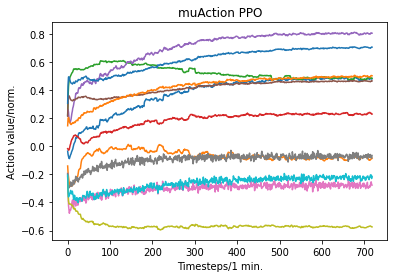

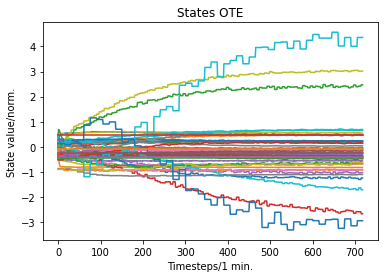

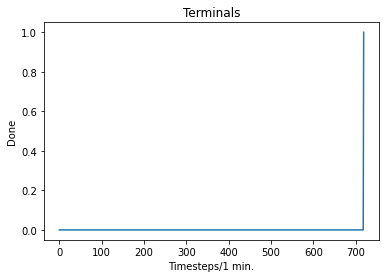

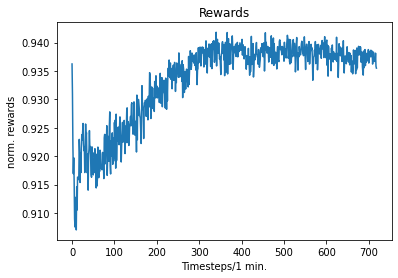

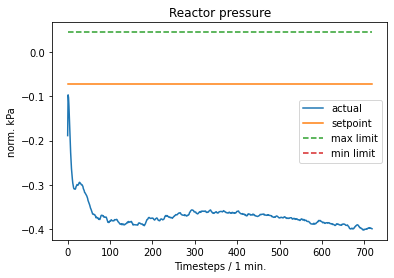

...

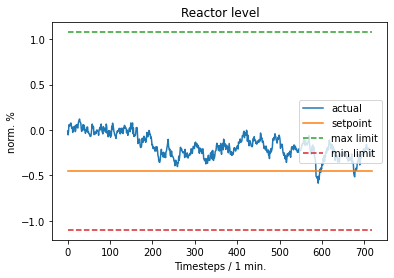

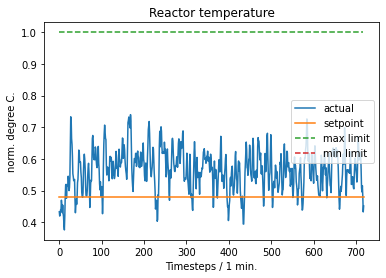

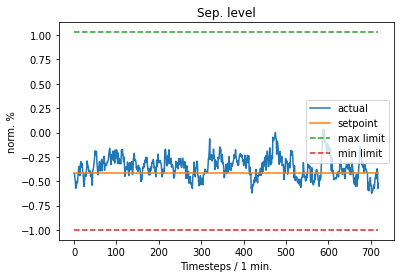

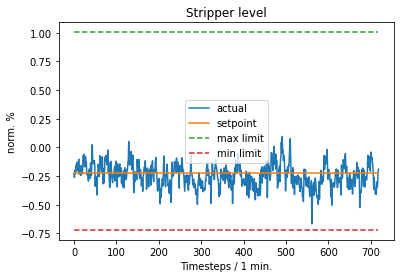

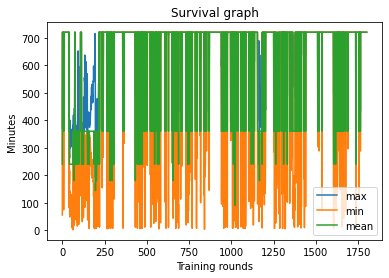

Iteration: 7601,  Mean reward: 670.3843383789062, Mean Entropy: -0.8410758972167969, complete_episode_count: 1.0, Gather time: 2.75s, Train time: 17.32s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.3562109470367432 vs. Entropy_factor: -8.410758164245635e-05
Iteration: 7602,  Mean reward: 669.988037109375, Mean Entropy: -0.8405799865722656, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.58s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.37968987226486206 vs. Entropy_factor: -8.405798871535808e-05
Iteration: 7603,  Mean reward: 667.4203491210938, Mean Entropy: -0.8405342102050781, complete_episode_count: 1.0, Gather time: 2.73s, Train time: 17.50s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.1352646350860596 vs. Entropy_factor: -8.405342668993399e-05
Iteration: 7604,  Mean reward: 681.007080078125, Mean Entropy: -0.840240478515625, complete_episode_count: 1.0, Gather ti

Iteration: 7629,  Mean reward: 667.6298217773438, Mean Entropy: -0.8341770172119141, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.70s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 3.902604579925537 vs. Entropy_factor: -8.341769716935232e-05
Iteration: 7630,  Mean reward: 434.25592041015625, Mean Entropy: -0.8339862823486328, complete_episode_count: 1.0, Gather time: 2.78s, Train time: 17.52s,Max episode: 468min., Min episode: 252min., Mean episode: 360.00min.PPO_clip: -9.818222045898438 vs. Entropy_factor: -8.339863416040316e-05
Iteration: 7631,  Mean reward: 666.6688232421875, Mean Entropy: -0.8338584899902344, complete_episode_count: 1.0, Gather time: 2.76s, Train time: 17.64s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.1854522228240967 vs. Entropy_factor: -8.338585030287504e-05
Iteration: 7632,  Mean reward: 661.8594360351562, Mean Entropy: -0.8336200714111328, complete_episode_count: 1.0, Gather 

Iteration: 7657,  Mean reward: 675.6461181640625, Mean Entropy: -0.8296413421630859, complete_episode_count: 1.0, Gather time: 2.70s, Train time: 17.48s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 4.289377212524414 vs. Entropy_factor: -8.296412852359936e-05
Iteration: 7658,  Mean reward: 667.7525634765625, Mean Entropy: -0.8295021057128906, complete_episode_count: 1.0, Gather time: 2.90s, Train time: 17.61s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -4.716885089874268 vs. Entropy_factor: -8.295021689264104e-05
Iteration: 7659,  Mean reward: 665.5556030273438, Mean Entropy: -0.8293037414550781, complete_episode_count: 1.0, Gather time: 2.83s, Train time: 17.46s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 3.7326622009277344 vs. Entropy_factor: -8.293037535622716e-05
Iteration: 7660,  Mean reward: 672.228759765625, Mean Entropy: -0.8287181854248047, complete_episode_count: 1.0, Gather ti

Iteration: 7685,  Mean reward: 677.4762573242188, Mean Entropy: -0.8264007568359375, complete_episode_count: 1.0, Gather time: 2.87s, Train time: 17.38s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.3130050301551819 vs. Entropy_factor: -8.264007919933647e-05
Iteration: 7686,  Mean reward: 655.69091796875, Mean Entropy: -0.8261280059814453, complete_episode_count: 1.0, Gather time: 2.85s, Train time: 17.51s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.6793535947799683 vs. Entropy_factor: -8.26128016342409e-05
Iteration: 7687,  Mean reward: 677.7208862304688, Mean Entropy: -0.8258876800537109, complete_episode_count: 1.0, Gather time: 2.79s, Train time: 17.49s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.4047386646270752 vs. Entropy_factor: -8.258876187028363e-05
Iteration: 7688,  Mean reward: 653.7459106445312, Mean Entropy: -0.8256874084472656, complete_episode_count: 1.0, Gather t

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


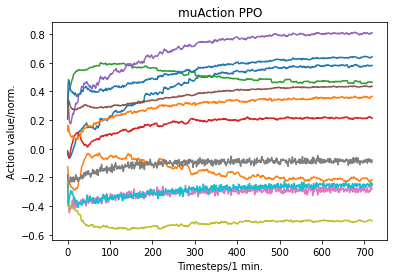

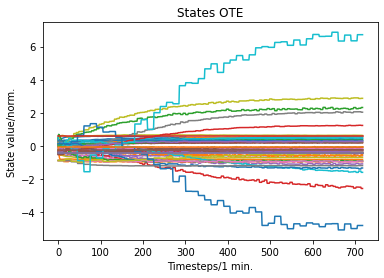

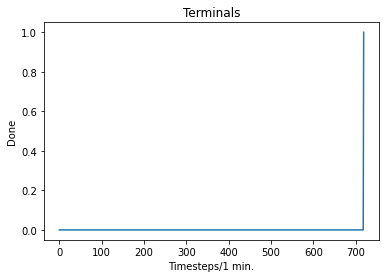

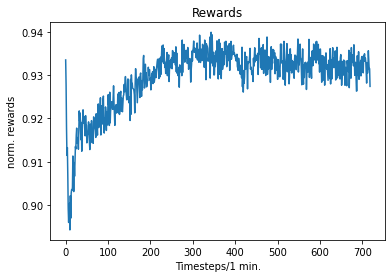

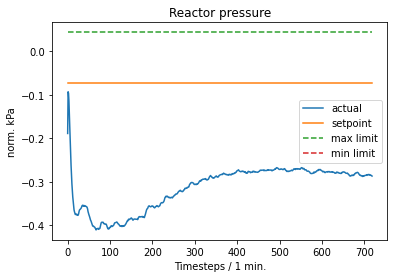

...

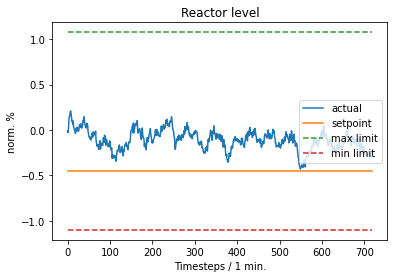

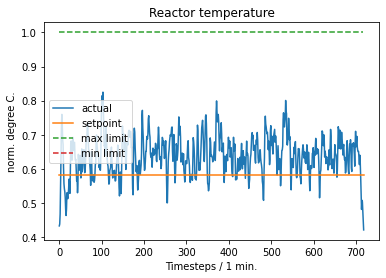

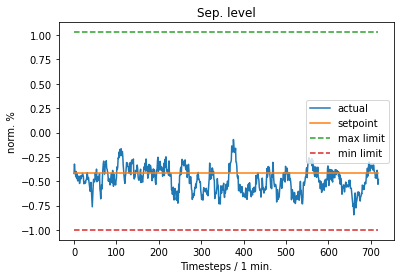

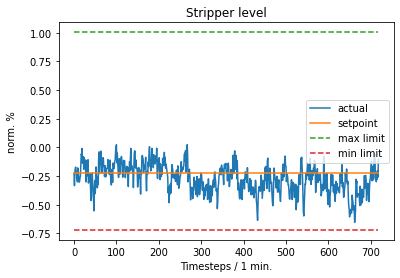

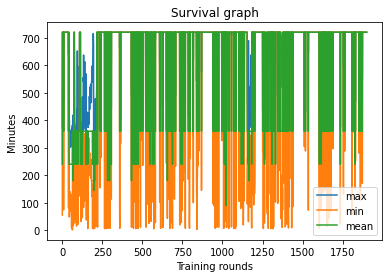

Iteration: 7701,  Mean reward: 669.3577270507812, Mean Entropy: -0.8227767944335938, complete_episode_count: 1.0, Gather time: 2.74s, Train time: 17.46s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.4989979863166809 vs. Entropy_factor: -8.227768557844684e-05
Iteration: 7702,  Mean reward: 668.0208740234375, Mean Entropy: -0.8227710723876953, complete_episode_count: 1.0, Gather time: 2.76s, Train time: 17.45s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.5651886463165283 vs. Entropy_factor: -8.22771035018377e-05
Iteration: 7703,  Mean reward: 664.7702026367188, Mean Entropy: -0.8233718872070312, complete_episode_count: 1.0, Gather time: 2.90s, Train time: 17.42s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.004434585571289 vs. Entropy_factor: -8.233718835981563e-05
Iteration: 7704,  Mean reward: 678.340576171875, Mean Entropy: -0.8231468200683594, complete_episode_count: 1.0, Gather t

Iteration: 7729,  Mean reward: 682.3167114257812, Mean Entropy: -0.8186283111572266, complete_episode_count: 1.0, Gather time: 2.76s, Train time: 17.73s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.0870089530944824 vs. Entropy_factor: -8.186283957911655e-05
Iteration: 7730,  Mean reward: 665.5990600585938, Mean Entropy: -0.8185214996337891, complete_episode_count: 1.0, Gather time: 2.75s, Train time: 17.49s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.8791948556900024 vs. Entropy_factor: -8.18521439214237e-05
Iteration: 7731,  Mean reward: 680.6046752929688, Mean Entropy: -0.818511962890625, complete_episode_count: 1.0, Gather time: 2.94s, Train time: 17.28s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.2364765703678131 vs. Entropy_factor: -8.185119804693386e-05
Iteration: 7732,  Mean reward: 663.6289672851562, Mean Entropy: -0.8184223175048828, complete_episode_count: 1.0, Gather t

Iteration: 7757,  Mean reward: 672.6582641601562, Mean Entropy: -0.8147926330566406, complete_episode_count: 1.0, Gather time: 2.75s, Train time: 17.24s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.35382717847824097 vs. Entropy_factor: -8.147925836965442e-05
Iteration: 7758,  Mean reward: 670.7841796875, Mean Entropy: -0.814697265625, complete_episode_count: 1.0, Gather time: 2.80s, Train time: 17.61s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.9640699625015259 vs. Entropy_factor: -8.146971958922222e-05
Iteration: 7759,  Mean reward: 672.614501953125, Mean Entropy: -0.8145389556884766, complete_episode_count: 1.0, Gather time: 2.76s, Train time: 17.51s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.040253810584545135 vs. Entropy_factor: -8.145388710545376e-05
Iteration: 7760,  Mean reward: 672.1997680664062, Mean Entropy: -0.8145771026611328, complete_episode_count: 1.0, Gather tim

Iteration: 7785,  Mean reward: 18.167802810668945, Mean Entropy: -0.8105030059814453, complete_episode_count: 1.0, Gather time: 2.79s, Train time: 17.28s,Max episode: 699min., Min episode: 21min., Mean episode: 360.00min.PPO_clip: -0.09171687066555023 vs. Entropy_factor: -8.105030428851023e-05
Iteration: 7786,  Mean reward: 662.6739501953125, Mean Entropy: -0.81036376953125, complete_episode_count: 1.0, Gather time: 2.89s, Train time: 17.45s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.6724816560745239 vs. Entropy_factor: -8.103637082967907e-05
Iteration: 7787,  Mean reward: 663.8565673828125, Mean Entropy: -0.8103237152099609, complete_episode_count: 1.0, Gather time: 2.77s, Train time: 17.45s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.9056398272514343 vs. Entropy_factor: -8.103237632894889e-05
Iteration: 7788,  Mean reward: 667.6425170898438, Mean Entropy: -0.8102245330810547, complete_episode_count: 1.0, Gather 

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


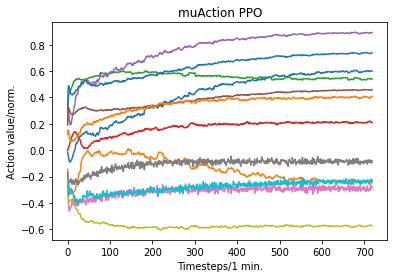

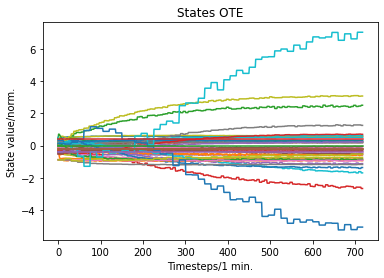

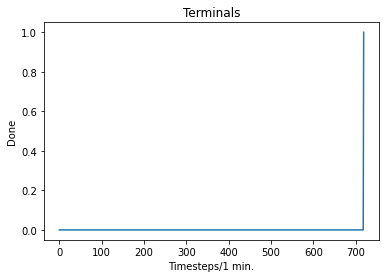

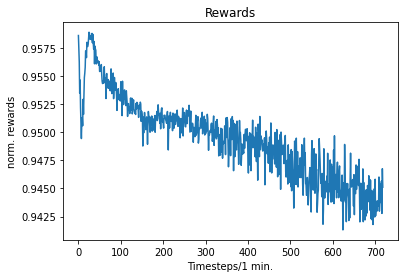

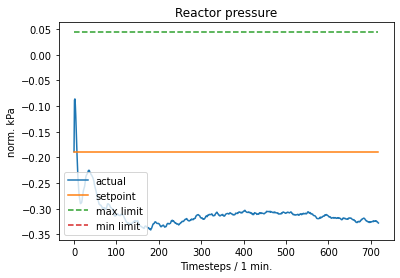

...

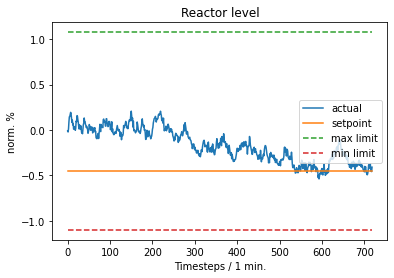

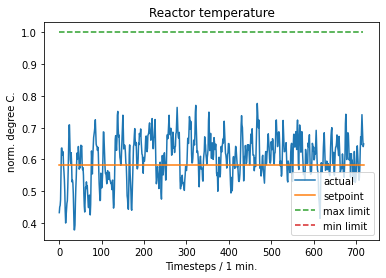

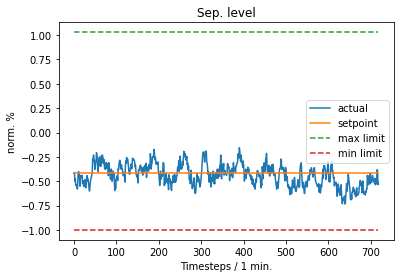

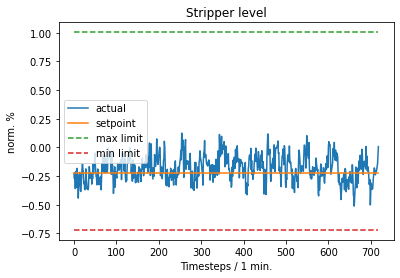

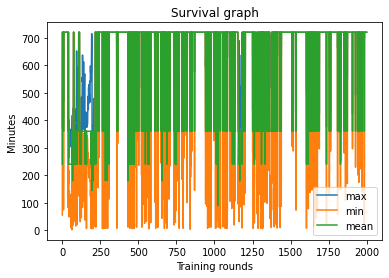

Iteration: 7801,  Mean reward: 670.3241577148438, Mean Entropy: -0.8092918395996094, complete_episode_count: 1.0, Gather time: 2.89s, Train time: 17.44s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.974295437335968 vs. Entropy_factor: -8.092918869806454e-05
Iteration: 7802,  Mean reward: 670.048583984375, Mean Entropy: -0.8090686798095703, complete_episode_count: 1.0, Gather time: 2.78s, Train time: 17.72s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.18288272619247437 vs. Entropy_factor: -8.090685878414661e-05
Iteration: 7803,  Mean reward: 667.2303466796875, Mean Entropy: -0.8090782165527344, complete_episode_count: 1.0, Gather time: 2.74s, Train time: 17.53s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.35785189270973206 vs. Entropy_factor: -8.09078264865093e-05
Iteration: 7804,  Mean reward: 671.921630859375, Mean Entropy: -0.8092460632324219, complete_episode_count: 1.0, Gather 

Iteration: 7830,  Mean reward: 468.954345703125, Mean Entropy: -0.8051643371582031, complete_episode_count: 1.0, Gather time: 2.87s, Train time: 17.59s,Max episode: 503min., Min episode: 217min., Mean episode: 360.00min.PPO_clip: -3.035536527633667 vs. Entropy_factor: -8.051643817452714e-05
Iteration: 7831,  Mean reward: 557.4000854492188, Mean Entropy: -0.8050022125244141, complete_episode_count: 1.0, Gather time: 2.74s, Train time: 17.47s,Max episode: 601min., Min episode: 119min., Mean episode: 360.00min.PPO_clip: 1.5102410316467285 vs. Entropy_factor: -8.050021278904751e-05
Iteration: 7832,  Mean reward: 539.3837890625, Mean Entropy: -0.8048305511474609, complete_episode_count: 1.0, Gather time: 2.67s, Train time: 17.37s,Max episode: 579min., Min episode: 141min., Mean episode: 360.00min.PPO_clip: 0.05984633043408394 vs. Entropy_factor: -8.048304880503565e-05
Iteration: 7833,  Mean reward: 670.0800170898438, Mean Entropy: -0.8048725128173828, complete_episode_count: 1.0, Gather tim

Iteration: 7858,  Mean reward: 506.169677734375, Mean Entropy: -0.8014087677001953, complete_episode_count: 1.0, Gather time: 2.78s, Train time: 17.40s,Max episode: 549min., Min episode: 171min., Mean episode: 360.00min.PPO_clip: 2.050182819366455 vs. Entropy_factor: -8.014088234631345e-05
Iteration: 7859,  Mean reward: 297.904296875, Mean Entropy: -0.8011703491210938, complete_episode_count: 1.0, Gather time: 2.72s, Train time: 17.54s,Max episode: 397min., Min episode: 323min., Mean episode: 360.00min.PPO_clip: -0.6526350378990173 vs. Entropy_factor: -8.011703175725415e-05
Iteration: 7860,  Mean reward: 663.6207885742188, Mean Entropy: -0.8011589050292969, complete_episode_count: 1.0, Gather time: 2.85s, Train time: 17.46s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 5.130367755889893 vs. Entropy_factor: -8.011588215595111e-05
Iteration: 7861,  Mean reward: 660.8707275390625, Mean Entropy: -0.8010196685791016, complete_episode_count: 1.0, Gather time: 

Iteration: 7886,  Mean reward: 373.0108642578125, Mean Entropy: -0.7965202331542969, complete_episode_count: 1.0, Gather time: 2.80s, Train time: 17.39s,Max episode: 403min., Min episode: 317min., Mean episode: 360.00min.PPO_clip: -0.18855762481689453 vs. Entropy_factor: -7.965201075421646e-05
Iteration: 7887,  Mean reward: 657.4347534179688, Mean Entropy: -0.7965450286865234, complete_episode_count: 1.0, Gather time: 2.91s, Train time: 17.65s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.528879165649414 vs. Entropy_factor: -7.965449913172051e-05
Iteration: 7888,  Mean reward: 659.8258056640625, Mean Entropy: -0.7962913513183594, complete_episode_count: 1.0, Gather time: 2.72s, Train time: 17.66s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.141567662358284 vs. Entropy_factor: -7.962913514347747e-05
Iteration: 7889,  Mean reward: 599.7577514648438, Mean Entropy: -0.7962760925292969, complete_episode_count: 1.0, Gather 

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


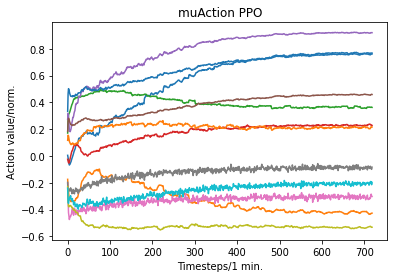

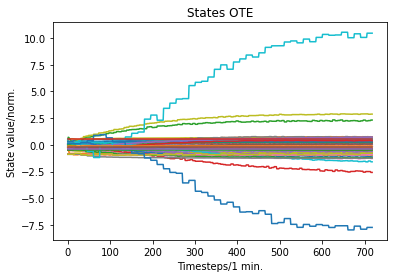

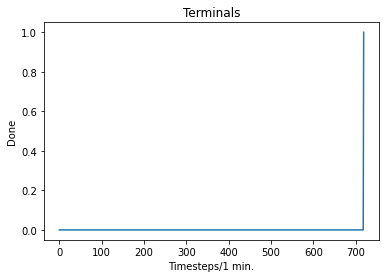

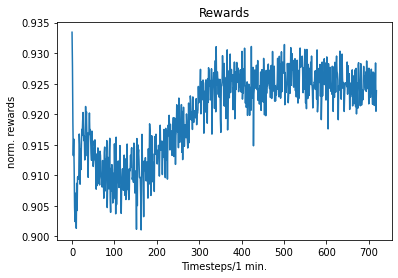

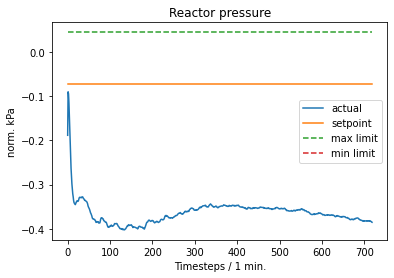

...

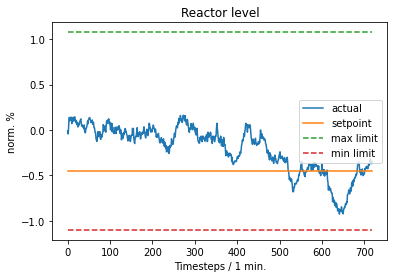

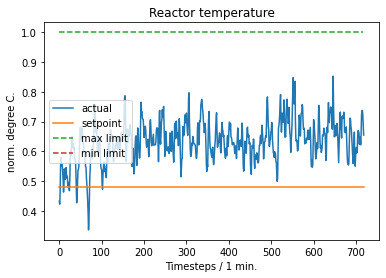

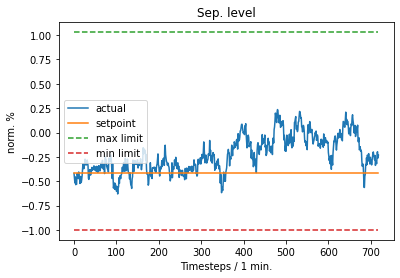

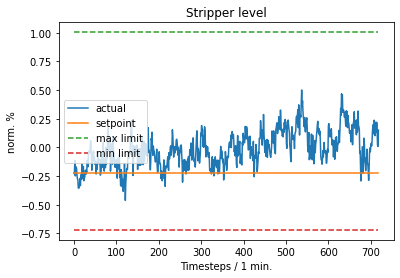

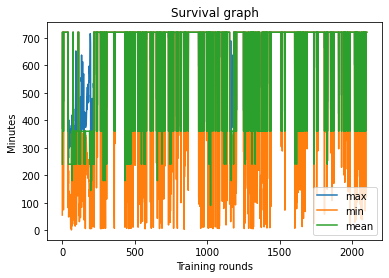

Iteration: 7901,  Mean reward: 669.9591064453125, Mean Entropy: -0.7935619354248047, complete_episode_count: 1.0, Gather time: 2.85s, Train time: 17.40s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.715358555316925 vs. Entropy_factor: -7.935619214549661e-05
Iteration: 7902,  Mean reward: 670.6917724609375, Mean Entropy: -0.7935352325439453, complete_episode_count: 1.0, Gather time: 2.74s, Train time: 17.40s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.7813194990158081 vs. Entropy_factor: -7.93535218690522e-05
Iteration: 7903,  Mean reward: 654.961181640625, Mean Entropy: -0.7933235168457031, complete_episode_count: 1.0, Gather time: 2.85s, Train time: 17.38s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.14275404810905457 vs. Entropy_factor: -7.933234155643731e-05
Iteration: 7904,  Mean reward: 659.5979614257812, Mean Entropy: -0.7932415008544922, complete_episode_count: 1.0, Gather t

Iteration: 7929,  Mean reward: 658.2337646484375, Mean Entropy: -0.7889747619628906, complete_episode_count: 1.0, Gather time: 2.82s, Train time: 17.64s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.9692845344543457 vs. Entropy_factor: -7.889746484579518e-05
Iteration: 7930,  Mean reward: 646.7727661132812, Mean Entropy: -0.7890987396240234, complete_episode_count: 1.0, Gather time: 2.92s, Train time: 17.35s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.071283258497715 vs. Entropy_factor: -7.890986307756975e-05
Iteration: 7931,  Mean reward: 640.9817504882812, Mean Entropy: -0.788909912109375, complete_episode_count: 1.0, Gather time: 2.71s, Train time: 17.47s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.30483484268188477 vs. Entropy_factor: -7.889098924351856e-05
Iteration: 7932,  Mean reward: 646.8978271484375, Mean Entropy: -0.7883796691894531, complete_episode_count: 1.0, Gather

Iteration: 7957,  Mean reward: 656.74560546875, Mean Entropy: -0.78399658203125, complete_episode_count: 1.0, Gather time: 2.80s, Train time: 17.12s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.14043183624744415 vs. Entropy_factor: -7.839965837774798e-05
Iteration: 7958,  Mean reward: 653.1182250976562, Mean Entropy: -0.7838859558105469, complete_episode_count: 1.0, Gather time: 2.56s, Train time: 17.65s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.5369712114334106 vs. Entropy_factor: -7.838859892217442e-05
Iteration: 7959,  Mean reward: 647.8331909179688, Mean Entropy: -0.7840156555175781, complete_episode_count: 1.0, Gather time: 2.73s, Train time: 17.48s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.1965431123971939 vs. Entropy_factor: -7.840157195460051e-05
Iteration: 7960,  Mean reward: 657.30859375, Mean Entropy: -0.7837600708007812, complete_episode_count: 1.0, Gather time: 2.

Iteration: 7985,  Mean reward: 666.7988891601562, Mean Entropy: -0.7810955047607422, complete_episode_count: 1.0, Gather time: 2.63s, Train time: 17.64s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -2.839003562927246 vs. Entropy_factor: -7.810955139575526e-05
Iteration: 7986,  Mean reward: 669.1141967773438, Mean Entropy: -0.7808570861816406, complete_episode_count: 1.0, Gather time: 2.61s, Train time: 17.39s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 4.218894004821777 vs. Entropy_factor: -7.808570080669597e-05
Iteration: 7987,  Mean reward: 665.79541015625, Mean Entropy: -0.7808914184570312, complete_episode_count: 1.0, Gather time: 2.90s, Train time: 17.39s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -8.089872360229492 vs. Entropy_factor: -7.808913505868986e-05
Iteration: 7988,  Mean reward: 625.5342407226562, Mean Entropy: -0.7808704376220703, complete_episode_count: 1.0, Gather tim

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


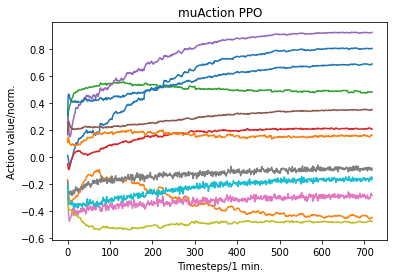

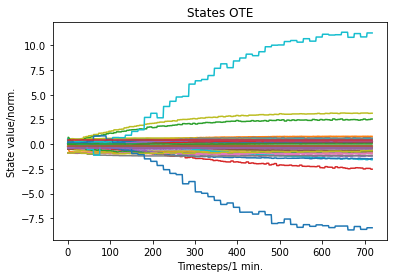

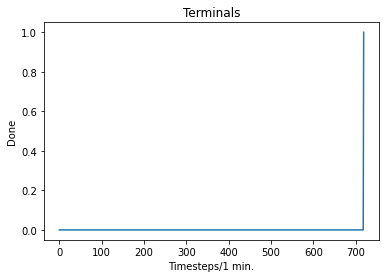

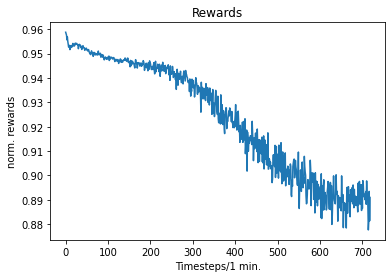

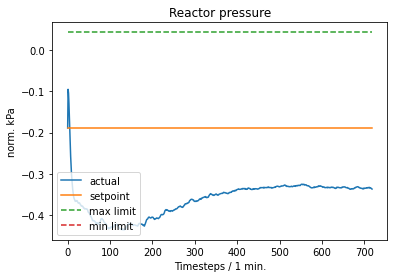

...

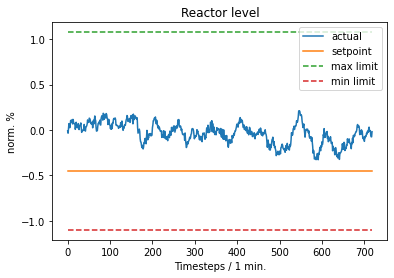

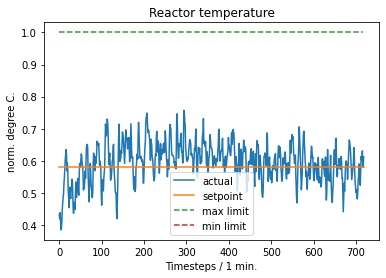

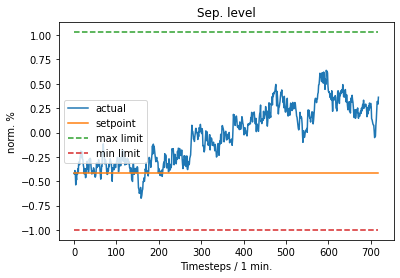

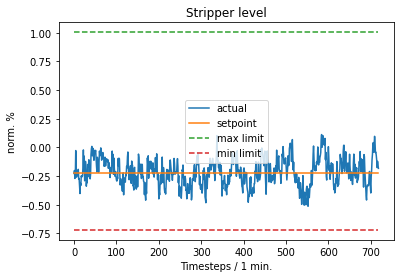

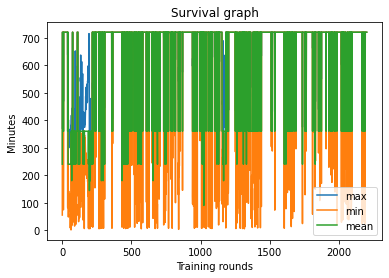

Iteration: 8001,  Mean reward: 634.8872680664062, Mean Entropy: -0.7804851531982422, complete_episode_count: 1.0, Gather time: 2.87s, Train time: 17.40s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.5569116473197937 vs. Entropy_factor: -7.804850611137226e-05
Iteration: 8002,  Mean reward: 634.0476684570312, Mean Entropy: -0.7804336547851562, complete_episode_count: 1.0, Gather time: 2.80s, Train time: 17.57s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.10302837938070297 vs. Entropy_factor: -7.804336928529665e-05
Iteration: 8003,  Mean reward: 662.646240234375, Mean Entropy: -0.7802906036376953, complete_episode_count: 1.0, Gather time: 2.72s, Train time: 17.39s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.6693329811096191 vs. Entropy_factor: -7.802905747666955e-05
Iteration: 8004,  Mean reward: 637.15478515625, Mean Entropy: -0.7799625396728516, complete_episode_count: 1.0, Gather 

Iteration: 8029,  Mean reward: 643.9766235351562, Mean Entropy: -0.7771034240722656, complete_episode_count: 1.0, Gather time: 2.94s, Train time: 17.60s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.8127827644348145 vs. Entropy_factor: -7.771034870529547e-05
Iteration: 8030,  Mean reward: 666.1851806640625, Mean Entropy: -0.7768478393554688, complete_episode_count: 1.0, Gather time: 2.84s, Train time: 17.46s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.5675140619277954 vs. Entropy_factor: -7.768477371428162e-05
Iteration: 8031,  Mean reward: 630.1932373046875, Mean Entropy: -0.7763385772705078, complete_episode_count: 1.0, Gather time: 2.70s, Train time: 17.43s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.13445159792900085 vs. Entropy_factor: -7.763386383885518e-05
Iteration: 8032,  Mean reward: 634.9464111328125, Mean Entropy: -0.7759723663330078, complete_episode_count: 1.0, Gathe

Iteration: 8057,  Mean reward: 639.8344116210938, Mean Entropy: -0.7723922729492188, complete_episode_count: 1.0, Gather time: 2.59s, Train time: 17.19s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.028770511969923973 vs. Entropy_factor: -7.72392304497771e-05
Iteration: 8058,  Mean reward: 647.5223999023438, Mean Entropy: -0.7724094390869141, complete_episode_count: 1.0, Gather time: 2.86s, Train time: 17.56s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.40624111890792847 vs. Entropy_factor: -7.724093302385882e-05
Iteration: 8059,  Mean reward: 670.052978515625, Mean Entropy: -0.7724151611328125, complete_episode_count: 1.0, Gather time: 2.83s, Train time: 17.64s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.2673306465148926 vs. Entropy_factor: -7.724151510046795e-05
Iteration: 8060,  Mean reward: 662.1168823242188, Mean Entropy: -0.7723865509033203, complete_episode_count: 1.0, Gathe

Iteration: 8085,  Mean reward: 652.02001953125, Mean Entropy: -0.767974853515625, complete_episode_count: 1.0, Gather time: 2.87s, Train time: 17.43s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.970605492591858 vs. Entropy_factor: -7.679749251110479e-05
Iteration: 8086,  Mean reward: 643.470947265625, Mean Entropy: -0.7678871154785156, complete_episode_count: 1.0, Gather time: 2.79s, Train time: 17.55s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -6.104907512664795 vs. Entropy_factor: -7.678871043026447e-05
Iteration: 8087,  Mean reward: 648.1939697265625, Mean Entropy: -0.7677822113037109, complete_episode_count: 1.0, Gather time: 2.74s, Train time: 17.65s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.7186119556427002 vs. Entropy_factor: -7.677822577534243e-05
Iteration: 8088,  Mean reward: 649.29736328125, Mean Entropy: -0.7676868438720703, complete_episode_count: 1.0, Gather time: 2

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


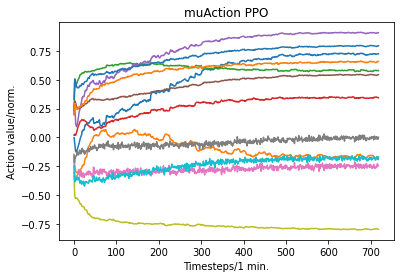

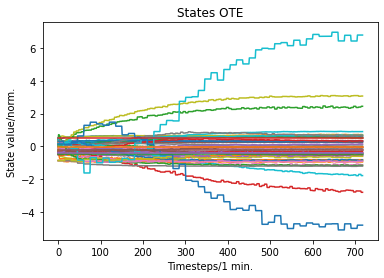

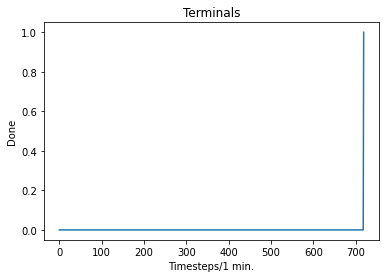

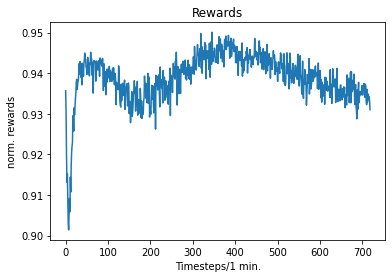

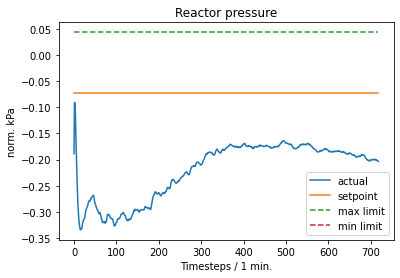

...

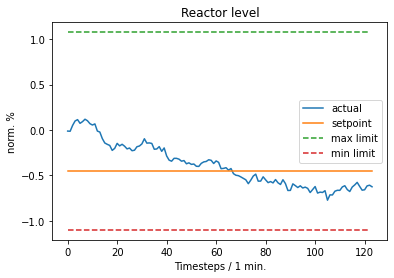

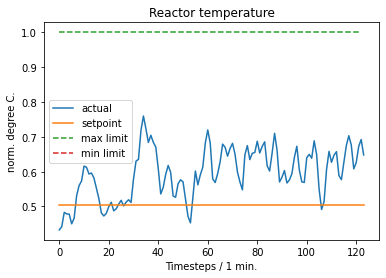

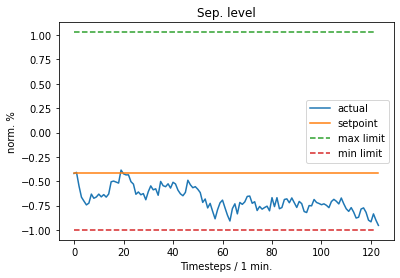

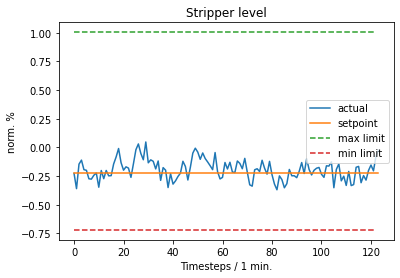

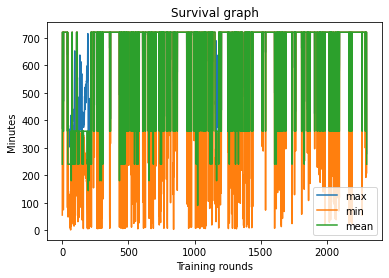

Iteration: 8101,  Mean reward: 292.0911865234375, Mean Entropy: -0.7659797668457031, complete_episode_count: 2.0, Gather time: 2.95s, Train time: 15.26s,Max episode: 419min., Min episode: 95min., Mean episode: 240.00min.PPO_clip: -2.1785888671875 vs. Entropy_factor: -7.659797120140865e-05
Iteration: 8102,  Mean reward: 223.31280517578125, Mean Entropy: -0.7657318115234375, complete_episode_count: 3.0, Gather time: 2.76s, Train time: 15.35s,Max episode: 336min., Min episode: 1min., Mean episode: 180.00min.PPO_clip: -0.3024068772792816 vs. Entropy_factor: -7.657317473785952e-05
Iteration: 8103,  Mean reward: 282.6170349121094, Mean Entropy: -0.7657146453857422, complete_episode_count: 2.0, Gather time: 2.53s, Train time: 15.44s,Max episode: 470min., Min episode: 114min., Mean episode: 240.00min.PPO_clip: 4.700623512268066 vs. Entropy_factor: -7.65714721637778e-05
Iteration: 8104,  Mean reward: 669.7877197265625, Mean Entropy: -0.7658882141113281, complete_episode_count: 1.0, Gather time:

Iteration: 8130,  Mean reward: 632.783203125, Mean Entropy: -0.7628650665283203, complete_episode_count: 1.0, Gather time: 2.95s, Train time: 17.45s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.7940889000892639 vs. Entropy_factor: -7.628650200786069e-05
Iteration: 8131,  Mean reward: 668.7115478515625, Mean Entropy: -0.7628803253173828, complete_episode_count: 1.0, Gather time: 2.90s, Train time: 17.52s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.8186936378479004 vs. Entropy_factor: -7.628802268300205e-05
Iteration: 8132,  Mean reward: 641.573974609375, Mean Entropy: -0.7626972198486328, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.34s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.2556644678115845 vs. Entropy_factor: -7.626972364960238e-05
Iteration: 8133,  Mean reward: 644.896728515625, Mean Entropy: -0.7625255584716797, complete_episode_count: 1.0, Gather time

Iteration: 8159,  Mean reward: 634.0473022460938, Mean Entropy: -0.7586441040039062, complete_episode_count: 1.0, Gather time: 2.77s, Train time: 17.46s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.17325572669506073 vs. Entropy_factor: -7.58644164307043e-05
Iteration: 8160,  Mean reward: 647.20361328125, Mean Entropy: -0.7585067749023438, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.39s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.5849321484565735 vs. Entropy_factor: -7.585067942272872e-05
Iteration: 8161,  Mean reward: 669.4974365234375, Mean Entropy: -0.7586402893066406, complete_episode_count: 1.0, Gather time: 2.98s, Train time: 17.41s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 4.045884609222412 vs. Entropy_factor: -7.586402352899313e-05
Iteration: 8162,  Mean reward: 623.7847900390625, Mean Entropy: -0.7583351135253906, complete_episode_count: 1.0, Gather ti

Iteration: 8187,  Mean reward: 657.918212890625, Mean Entropy: -0.7528667449951172, complete_episode_count: 1.0, Gather time: 3.36s, Train time: 20.18s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.6013408303260803 vs. Entropy_factor: -7.528666901635006e-05
Iteration: 8188,  Mean reward: 643.7512817382812, Mean Entropy: -0.7527523040771484, complete_episode_count: 1.0, Gather time: 3.26s, Train time: 20.34s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -4.268729209899902 vs. Entropy_factor: -7.527523848693818e-05
Iteration: 8189,  Mean reward: 0.903578519821167, Mean Entropy: -0.7526435852050781, complete_episode_count: 1.0, Gather time: 3.52s, Train time: 19.58s,Max episode: 718min., Min episode: 2min., Mean episode: 360.00min.PPO_clip: 3.5238189697265625 vs. Entropy_factor: -7.526436093030497e-05
Iteration: 8190,  Mean reward: 675.1681518554688, Mean Entropy: -0.7522087097167969, complete_episode_count: 1.0, Gather tim

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


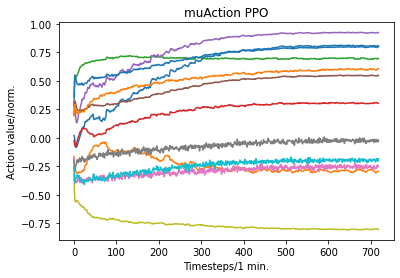

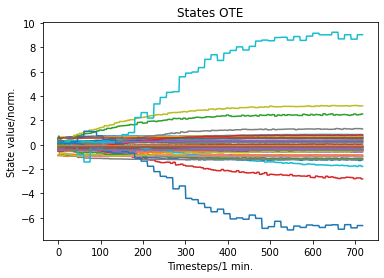

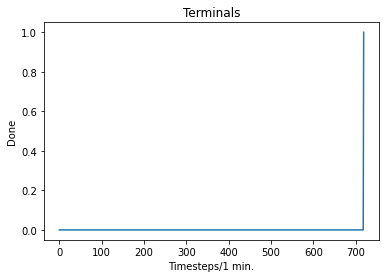

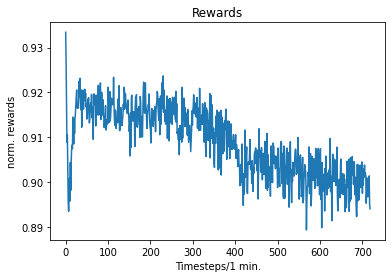

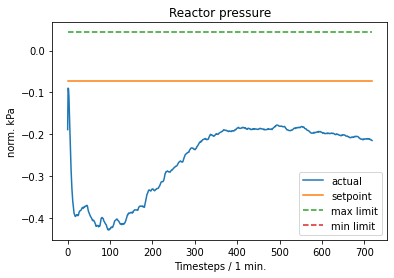

...

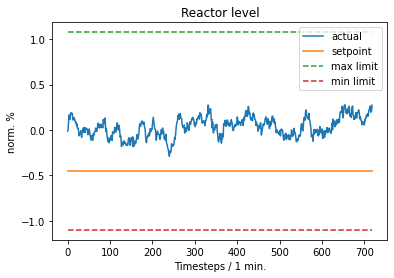

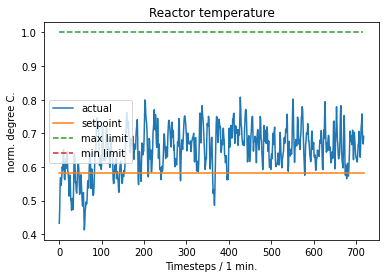

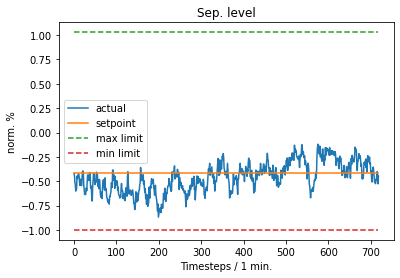

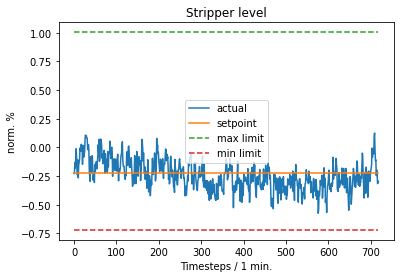

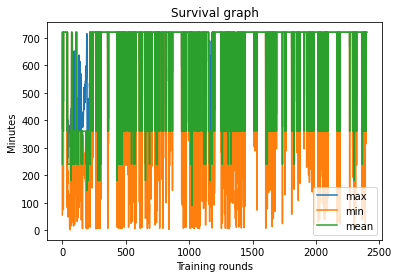

Iteration: 8201,  Mean reward: 656.69091796875, Mean Entropy: -0.7514533996582031, complete_episode_count: 1.0, Gather time: 3.16s, Train time: 20.35s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -5.486150741577148 vs. Entropy_factor: -7.514534081565216e-05
Iteration: 8202,  Mean reward: 661.1917724609375, Mean Entropy: -0.7513065338134766, complete_episode_count: 1.0, Gather time: 3.99s, Train time: 17.78s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.9314829111099243 vs. Entropy_factor: -7.513065793318674e-05
Iteration: 8203,  Mean reward: 654.9554443359375, Mean Entropy: -0.7510128021240234, complete_episode_count: 1.0, Gather time: 3.02s, Train time: 20.87s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.058398403227329254 vs. Entropy_factor: -7.510127761634067e-05
Iteration: 8204,  Mean reward: 401.3395080566406, Mean Entropy: -0.7507724761962891, complete_episode_count: 1.0, Gather 

Iteration: 8229,  Mean reward: 628.421630859375, Mean Entropy: -0.7486801147460938, complete_episode_count: 1.0, Gather time: 2.79s, Train time: 17.90s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.12099821865558624 vs. Entropy_factor: -7.486801769118756e-05
Iteration: 8230,  Mean reward: 631.0537719726562, Mean Entropy: -0.7485523223876953, complete_episode_count: 1.0, Gather time: 2.83s, Train time: 17.59s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.5230389833450317 vs. Entropy_factor: -7.485523383365944e-05
Iteration: 8231,  Mean reward: 620.817138671875, Mean Entropy: -0.7483081817626953, complete_episode_count: 1.0, Gather time: 2.74s, Train time: 17.91s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.05991480499505997 vs. Entropy_factor: -7.483082299586385e-05
Iteration: 8232,  Mean reward: 631.7617797851562, Mean Entropy: -0.7481594085693359, complete_episode_count: 1.0, Gather 

Iteration: 8257,  Mean reward: 628.8097534179688, Mean Entropy: -0.7443943023681641, complete_episode_count: 1.0, Gather time: 2.76s, Train time: 17.95s,Max episode: 681min., Min episode: 39min., Mean episode: 360.00min.PPO_clip: -0.16958682239055634 vs. Entropy_factor: -7.44394346838817e-05
Iteration: 8258,  Mean reward: 482.5513916015625, Mean Entropy: -0.7441654205322266, complete_episode_count: 1.0, Gather time: 2.78s, Train time: 17.85s,Max episode: 520min., Min episode: 200min., Mean episode: 360.00min.PPO_clip: -2.4492571353912354 vs. Entropy_factor: -7.441652996931225e-05
Iteration: 8259,  Mean reward: 661.6749877929688, Mean Entropy: -0.744049072265625, complete_episode_count: 1.0, Gather time: 2.61s, Train time: 16.97s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 8.476078033447266 vs. Entropy_factor: -7.440489571308717e-05
Iteration: 8260,  Mean reward: 646.1126708984375, Mean Entropy: -0.7439060211181641, complete_episode_count: 1.0, Gather t

Iteration: 8285,  Mean reward: 673.0001220703125, Mean Entropy: -0.7424297332763672, complete_episode_count: 1.0, Gather time: 3.19s, Train time: 17.62s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.20059415698051453 vs. Entropy_factor: -7.42429620004259e-05
Iteration: 8286,  Mean reward: 681.1350708007812, Mean Entropy: -0.7422542572021484, complete_episode_count: 1.0, Gather time: 2.83s, Train time: 17.98s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.11285729706287384 vs. Entropy_factor: -7.422542694257572e-05
Iteration: 8287,  Mean reward: 675.9600219726562, Mean Entropy: -0.742218017578125, complete_episode_count: 1.0, Gather time: 2.88s, Train time: 17.80s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.5795382261276245 vs. Entropy_factor: -7.422180351568386e-05
Iteration: 8288,  Mean reward: 570.4650268554688, Mean Entropy: -0.7422542572021484, complete_episode_count: 1.0, Gather

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


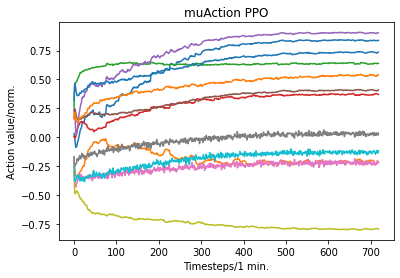

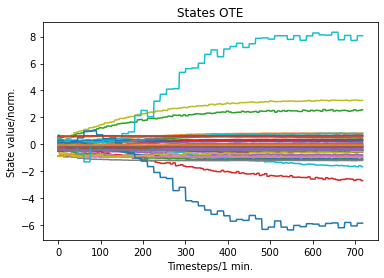

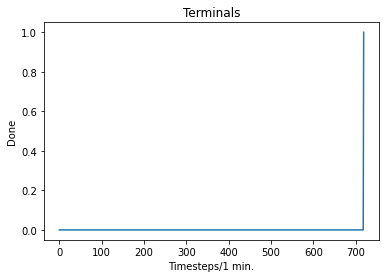

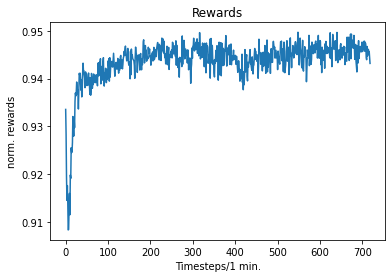

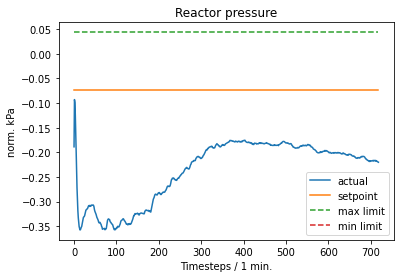

...

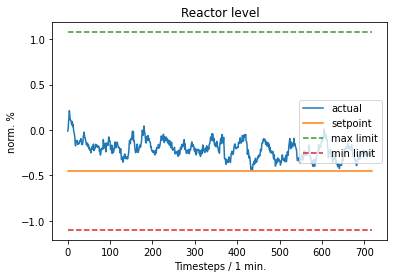

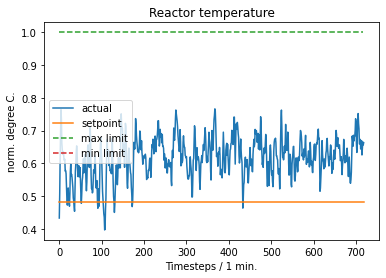

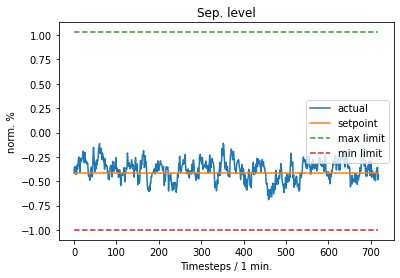

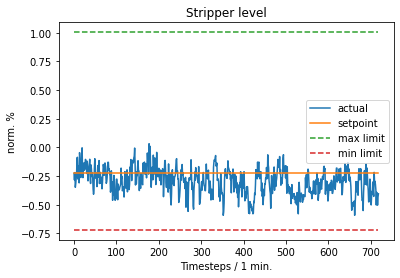

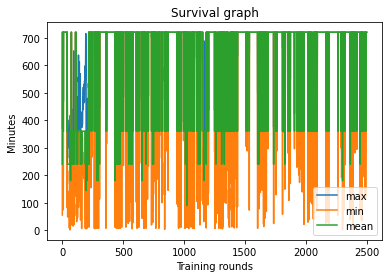

Iteration: 8301,  Mean reward: 676.3462524414062, Mean Entropy: -0.7404537200927734, complete_episode_count: 1.0, Gather time: 2.79s, Train time: 17.45s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.259127140045166 vs. Entropy_factor: -7.404537609545514e-05
Iteration: 8302,  Mean reward: 678.752197265625, Mean Entropy: -0.7404327392578125, complete_episode_count: 1.0, Gather time: 2.94s, Train time: 17.58s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.2482716292142868 vs. Entropy_factor: -7.404328061966226e-05
Iteration: 8303,  Mean reward: 672.2839965820312, Mean Entropy: -0.7403602600097656, complete_episode_count: 1.0, Gather time: 2.67s, Train time: 18.09s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.2552531063556671 vs. Entropy_factor: -7.40360192139633e-05
Iteration: 8304,  Mean reward: 673.6260375976562, Mean Entropy: -0.7400169372558594, complete_episode_count: 1.0, Gather ti

Iteration: 8329,  Mean reward: 672.8633422851562, Mean Entropy: -0.7357521057128906, complete_episode_count: 1.0, Gather time: 2.83s, Train time: 18.13s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.01018527615815401 vs. Entropy_factor: -7.357520371442661e-05
Iteration: 8330,  Mean reward: 675.2066040039062, Mean Entropy: -0.7353363037109375, complete_episode_count: 1.0, Gather time: 2.72s, Train time: 17.72s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.3156774342060089 vs. Entropy_factor: -7.353362889261916e-05
Iteration: 8331,  Mean reward: 672.5087280273438, Mean Entropy: -0.7350959777832031, complete_episode_count: 1.0, Gather time: 2.71s, Train time: 17.75s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.3077085614204407 vs. Entropy_factor: -7.35095891286619e-05
Iteration: 8332,  Mean reward: 666.219482421875, Mean Entropy: -0.7351322174072266, complete_episode_count: 1.0, Gather 

Iteration: 8357,  Mean reward: 673.4030151367188, Mean Entropy: -0.7304763793945312, complete_episode_count: 1.0, Gather time: 2.99s, Train time: 17.58s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.006856816820800304 vs. Entropy_factor: -7.30476385797374e-05
Iteration: 8358,  Mean reward: 668.8077392578125, Mean Entropy: -0.7301101684570312, complete_episode_count: 1.0, Gather time: 2.70s, Train time: 17.94s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.2799617648124695 vs. Entropy_factor: -7.301101868506521e-05
Iteration: 8359,  Mean reward: 669.0814819335938, Mean Entropy: -0.7300643920898438, complete_episode_count: 1.0, Gather time: 2.74s, Train time: 16.96s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.7565006017684937 vs. Entropy_factor: -7.300643483176827e-05
Iteration: 8360,  Mean reward: 677.1607666015625, Mean Entropy: -0.7297096252441406, complete_episode_count: 1.0, Gathe

Iteration: 8385,  Mean reward: 669.888427734375, Mean Entropy: -0.727264404296875, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.64s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 3.351750135421753 vs. Entropy_factor: -7.272644870681688e-05
Iteration: 8386,  Mean reward: 674.2943115234375, Mean Entropy: -0.7272510528564453, complete_episode_count: 1.0, Gather time: 2.69s, Train time: 18.10s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.2589423656463623 vs. Entropy_factor: -7.272510993061587e-05
Iteration: 8387,  Mean reward: 673.0006103515625, Mean Entropy: -0.7271137237548828, complete_episode_count: 1.0, Gather time: 2.75s, Train time: 17.97s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.3601226210594177 vs. Entropy_factor: -7.27113729226403e-05
Iteration: 8388,  Mean reward: 665.5711059570312, Mean Entropy: -0.7268199920654297, complete_episode_count: 1.0, Gather tim

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


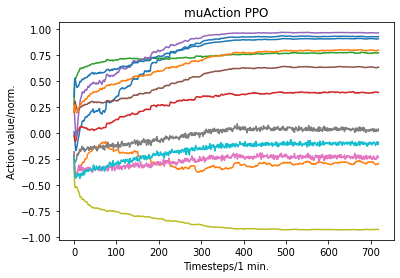

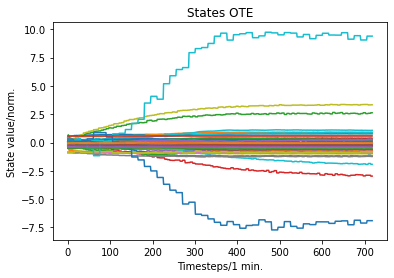

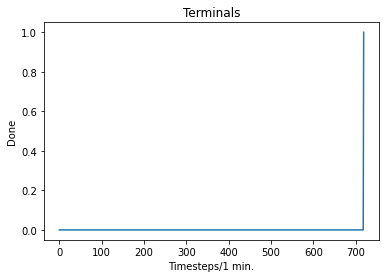

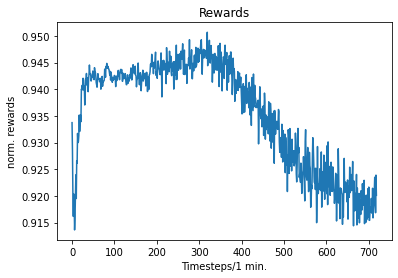

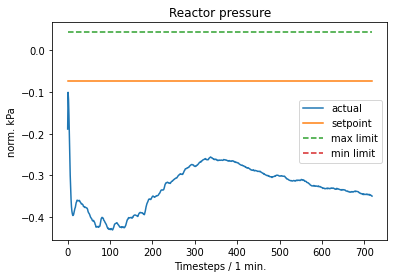

...

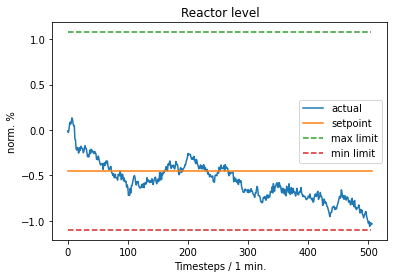

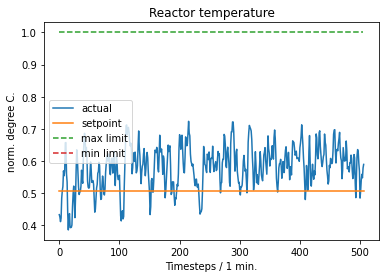

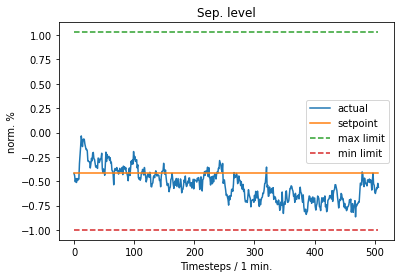

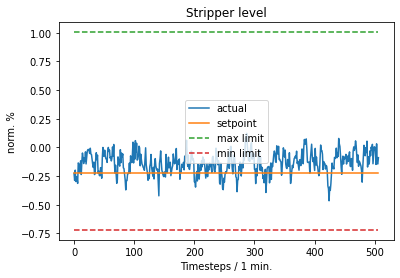

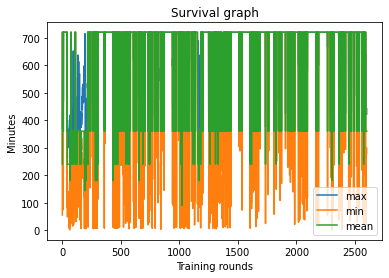

Iteration: 8401,  Mean reward: 529.7965087890625, Mean Entropy: -0.7249088287353516, complete_episode_count: 1.0, Gather time: 2.83s, Train time: 17.67s,Max episode: 573min., Min episode: 147min., Mean episode: 360.00min.PPO_clip: 2.2622406482696533 vs. Entropy_factor: -7.249088230310008e-05
Iteration: 8402,  Mean reward: 449.7126159667969, Mean Entropy: -0.7245006561279297, complete_episode_count: 1.0, Gather time: 2.96s, Train time: 17.48s,Max episode: 485min., Min episode: 235min., Mean episode: 360.00min.PPO_clip: -0.13548338413238525 vs. Entropy_factor: -7.245007145684212e-05
Iteration: 8403,  Mean reward: 580.8582763671875, Mean Entropy: -0.7244720458984375, complete_episode_count: 1.0, Gather time: 2.90s, Train time: 17.82s,Max episode: 625min., Min episode: 95min., Mean episode: 360.00min.PPO_clip: 1.6405713558197021 vs. Entropy_factor: -7.244721200549975e-05
Iteration: 8404,  Mean reward: 390.5067138671875, Mean Entropy: -0.7245540618896484, complete_episode_count: 1.0, Gather

Iteration: 8429,  Mean reward: 48.822784423828125, Mean Entropy: -0.7209072113037109, complete_episode_count: 1.0, Gather time: 2.88s, Train time: 17.77s,Max episode: 666min., Min episode: 54min., Mean episode: 360.00min.PPO_clip: 0.3427578806877136 vs. Entropy_factor: -7.209071918623522e-05
Iteration: 8430,  Mean reward: 674.6432495117188, Mean Entropy: -0.7206954956054688, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.65s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.8247349262237549 vs. Entropy_factor: -7.206953887362033e-05
Iteration: 8431,  Mean reward: 672.762451171875, Mean Entropy: -0.720550537109375, complete_episode_count: 1.0, Gather time: 2.88s, Train time: 17.38s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.7293447256088257 vs. Entropy_factor: -7.205504516605288e-05
Iteration: 8432,  Mean reward: 678.01123046875, Mean Entropy: -0.7200870513916016, complete_episode_count: 1.0, Gather tim

Iteration: 8457,  Mean reward: 656.5159301757812, Mean Entropy: -0.7159214019775391, complete_episode_count: 1.0, Gather time: 3.00s, Train time: 17.99s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -2.2703311443328857 vs. Entropy_factor: -7.159214874263853e-05
Iteration: 8458,  Mean reward: 662.9827880859375, Mean Entropy: -0.7154922485351562, complete_episode_count: 1.0, Gather time: 2.77s, Train time: 17.82s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.1403968185186386 vs. Entropy_factor: -7.154921331675723e-05
Iteration: 8459,  Mean reward: 659.7681274414062, Mean Entropy: -0.7152938842773438, complete_episode_count: 1.0, Gather time: 2.90s, Train time: 17.60s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.631329894065857 vs. Entropy_factor: -7.15293936082162e-05
Iteration: 8460,  Mean reward: 29.810272216796875, Mean Entropy: -0.7153263092041016, complete_episode_count: 1.0, Gather

Iteration: 8486,  Mean reward: 656.40087890625, Mean Entropy: -0.7097187042236328, complete_episode_count: 1.0, Gather time: 2.98s, Train time: 18.77s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.020316744223237038 vs. Entropy_factor: -7.097185880411416e-05
Iteration: 8487,  Mean reward: 653.8235473632812, Mean Entropy: -0.7096748352050781, complete_episode_count: 1.0, Gather time: 3.04s, Train time: 21.40s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.43149957060813904 vs. Entropy_factor: -7.096747867763042e-05
Iteration: 8488,  Mean reward: 658.2421264648438, Mean Entropy: -0.7098331451416016, complete_episode_count: 1.0, Gather time: 3.91s, Train time: 19.63s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.277529001235962 vs. Entropy_factor: -7.098331116139889e-05
Iteration: 8489,  Mean reward: 667.2335205078125, Mean Entropy: -0.709564208984375, complete_episode_count: 1.0, Gather 

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


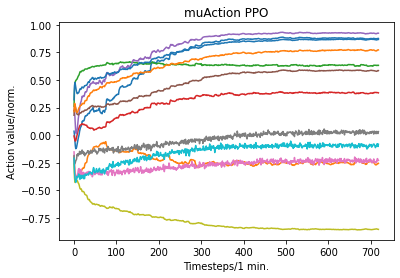

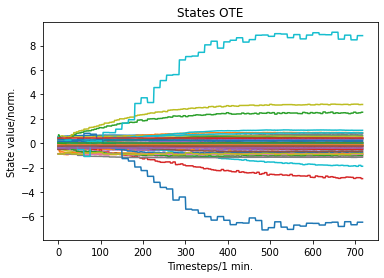

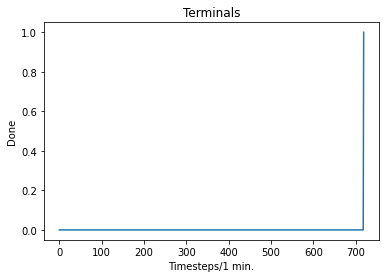

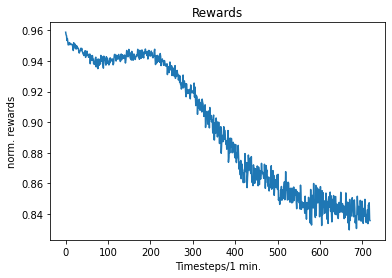

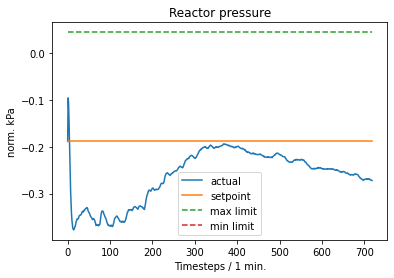

...

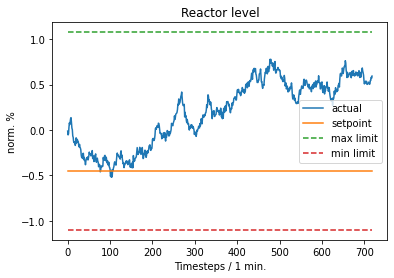

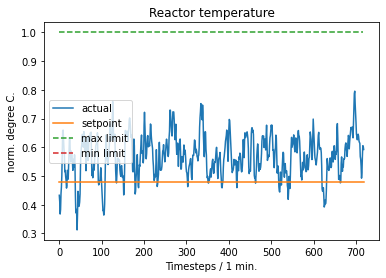

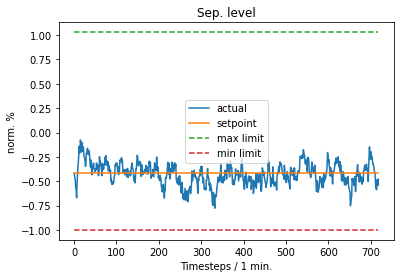

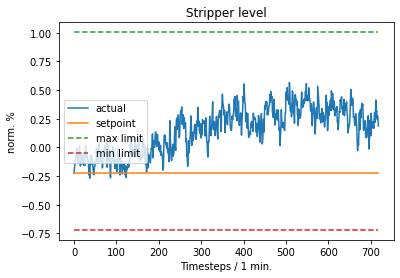

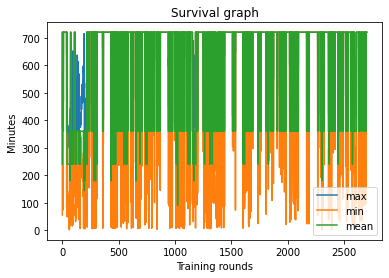

Iteration: 8501,  Mean reward: 652.164306640625, Mean Entropy: -0.7073650360107422, complete_episode_count: 1.0, Gather time: 2.39s, Train time: 15.15s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.6519252061843872 vs. Entropy_factor: -7.073650340316817e-05
Iteration: 8502,  Mean reward: 624.5559692382812, Mean Entropy: -0.7072315216064453, complete_episode_count: 1.0, Gather time: 2.60s, Train time: 16.15s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.17225798964500427 vs. Entropy_factor: -7.072314474498853e-05
Iteration: 8503,  Mean reward: 630.1264038085938, Mean Entropy: -0.7071285247802734, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 19.11s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.3223850429058075 vs. Entropy_factor: -7.071285654092208e-05
Iteration: 8504,  Mean reward: 630.3184204101562, Mean Entropy: -0.7068099975585938, complete_episode_count: 1.0, Gather

Iteration: 8529,  Mean reward: 602.5215454101562, Mean Entropy: -0.7036781311035156, complete_episode_count: 1.0, Gather time: 2.78s, Train time: 17.87s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.4427874684333801 vs. Entropy_factor: -7.036781607894227e-05
Iteration: 8530,  Mean reward: 614.3607177734375, Mean Entropy: -0.7035560607910156, complete_episode_count: 1.0, Gather time: 2.90s, Train time: 17.88s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.042641520500183 vs. Entropy_factor: -7.035560702206567e-05
Iteration: 8531,  Mean reward: 625.1298217773438, Mean Entropy: -0.7033920288085938, complete_episode_count: 1.0, Gather time: 2.89s, Train time: 17.62s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.5925801992416382 vs. Entropy_factor: -7.033919246168807e-05
Iteration: 8532,  Mean reward: 630.637451171875, Mean Entropy: -0.7033557891845703, complete_episode_count: 1.0, Gather 

Iteration: 8557,  Mean reward: 629.768310546875, Mean Entropy: -0.7006587982177734, complete_episode_count: 1.0, Gather time: 2.71s, Train time: 17.54s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.417525053024292 vs. Entropy_factor: -7.00658856658265e-05
Iteration: 8558,  Mean reward: 637.6943359375, Mean Entropy: -0.7005023956298828, complete_episode_count: 1.0, Gather time: 2.85s, Train time: 17.62s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.6961084008216858 vs. Entropy_factor: -7.005023508099839e-05
Iteration: 8559,  Mean reward: 633.1644897460938, Mean Entropy: -0.7001590728759766, complete_episode_count: 1.0, Gather time: 2.85s, Train time: 17.68s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.34644395112991333 vs. Entropy_factor: -7.001590711297467e-05
Iteration: 8560,  Mean reward: 620.4061889648438, Mean Entropy: -0.7003765106201172, complete_episode_count: 1.0, Gather tim

Iteration: 8585,  Mean reward: 652.0986938476562, Mean Entropy: -0.6975593566894531, complete_episode_count: 1.0, Gather time: 2.73s, Train time: 17.61s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.3012330532073975 vs. Entropy_factor: -6.97559371474199e-05
Iteration: 8586,  Mean reward: 657.8468017578125, Mean Entropy: -0.6976985931396484, complete_episode_count: 1.0, Gather time: 2.84s, Train time: 17.69s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.07677529007196426 vs. Entropy_factor: -6.976985605433583e-05
Iteration: 8587,  Mean reward: 667.31982421875, Mean Entropy: -0.6973819732666016, complete_episode_count: 1.0, Gather time: 2.77s, Train time: 17.57s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.4222118854522705 vs. Entropy_factor: -6.973819836275652e-05
Iteration: 8588,  Mean reward: 668.8170166015625, Mean Entropy: -0.6970539093017578, complete_episode_count: 1.0, Gather ti

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


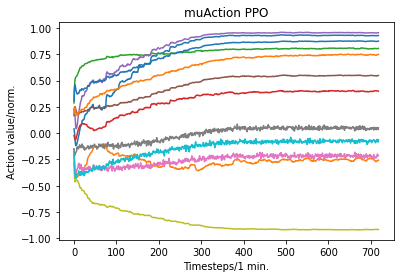

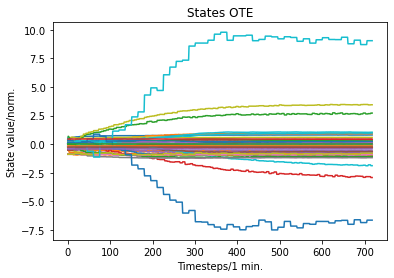

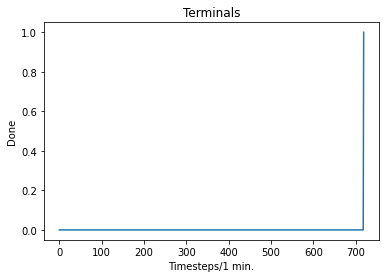

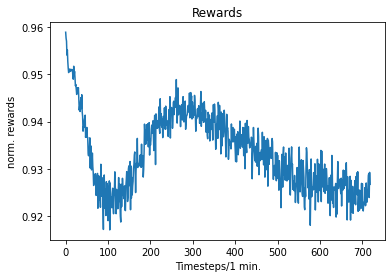

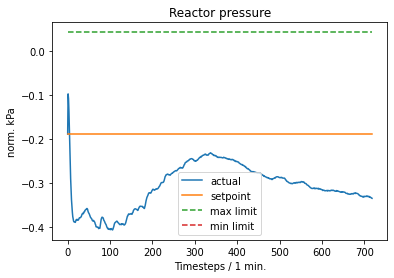

...

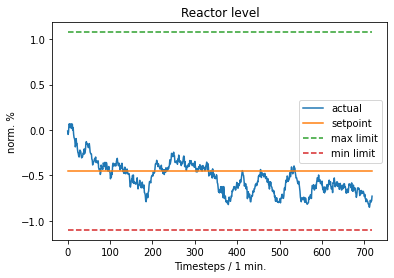

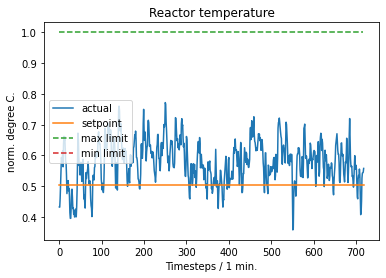

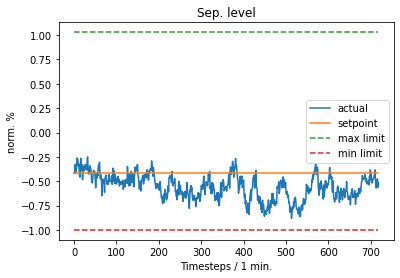

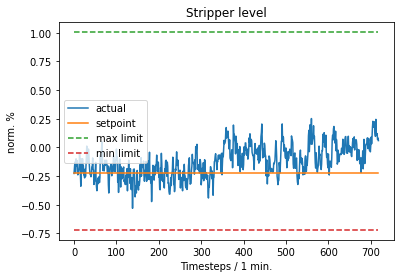

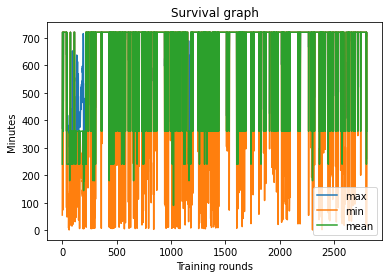

Iteration: 8601,  Mean reward: 674.58544921875, Mean Entropy: -0.6943931579589844, complete_episode_count: 1.0, Gather time: 2.80s, Train time: 17.25s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.4829428195953369 vs. Entropy_factor: -6.943930929992348e-05
Iteration: 8602,  Mean reward: 675.0498046875, Mean Entropy: -0.6943073272705078, complete_episode_count: 1.0, Gather time: 2.87s, Train time: 17.41s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.24839799106121063 vs. Entropy_factor: -6.943073094589636e-05
Iteration: 8603,  Mean reward: 664.8185424804688, Mean Entropy: -0.6941719055175781, complete_episode_count: 1.0, Gather time: 2.80s, Train time: 17.37s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.6804405450820923 vs. Entropy_factor: -6.941718311281875e-05
Iteration: 8604,  Mean reward: 675.5635986328125, Mean Entropy: -0.6939945220947266, complete_episode_count: 1.0, Gather tim

Iteration: 8629,  Mean reward: 669.5529174804688, Mean Entropy: -0.6911945343017578, complete_episode_count: 1.0, Gather time: 2.80s, Train time: 17.66s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.3959399163722992 vs. Entropy_factor: -6.911945092724636e-05
Iteration: 8630,  Mean reward: 283.4281311035156, Mean Entropy: -0.6910381317138672, complete_episode_count: 1.0, Gather time: 2.93s, Train time: 17.60s,Max episode: 414min., Min episode: 306min., Mean episode: 360.00min.PPO_clip: -0.17336401343345642 vs. Entropy_factor: -6.910380761837587e-05
Iteration: 8631,  Mean reward: 670.2784423828125, Mean Entropy: -0.6909141540527344, complete_episode_count: 1.0, Gather time: 2.73s, Train time: 17.49s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.6241281032562256 vs. Entropy_factor: -6.909142393851653e-05
Iteration: 8632,  Mean reward: 666.7611083984375, Mean Entropy: -0.6906852722167969, complete_episode_count: 1.0, Gath

Iteration: 8657,  Mean reward: 656.05029296875, Mean Entropy: -0.6866340637207031, complete_episode_count: 1.0, Gather time: 2.79s, Train time: 17.78s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.4100069999694824 vs. Entropy_factor: -6.866339390398934e-05
Iteration: 8658,  Mean reward: 663.500244140625, Mean Entropy: -0.6866912841796875, complete_episode_count: 1.0, Gather time: 2.79s, Train time: 18.63s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.3154900074005127 vs. Entropy_factor: -6.866913463454694e-05
Iteration: 8659,  Mean reward: 660.1940307617188, Mean Entropy: -0.6865749359130859, complete_episode_count: 1.0, Gather time: 2.93s, Train time: 17.62s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.018688777461647987 vs. Entropy_factor: -6.865750037832186e-05
Iteration: 8660,  Mean reward: 661.635498046875, Mean Entropy: -0.6863174438476562, complete_episode_count: 1.0, Gather 

Iteration: 8685,  Mean reward: 654.8196411132812, Mean Entropy: -0.6823577880859375, complete_episode_count: 1.0, Gather time: 3.10s, Train time: 19.13s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.916153609752655 vs. Entropy_factor: -6.823578587500378e-05
Iteration: 8686,  Mean reward: 669.5880126953125, Mean Entropy: -0.6819629669189453, complete_episode_count: 1.0, Gather time: 3.28s, Train time: 18.92s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.2551700472831726 vs. Entropy_factor: -6.819628470111638e-05
Iteration: 8687,  Mean reward: 677.7432861328125, Mean Entropy: -0.6819858551025391, complete_episode_count: 1.0, Gather time: 3.21s, Train time: 21.09s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.27862468361854553 vs. Entropy_factor: -6.819859117968008e-05
Iteration: 8688,  Mean reward: 676.3602294921875, Mean Entropy: -0.6821746826171875, complete_episode_count: 1.0, Gathe

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


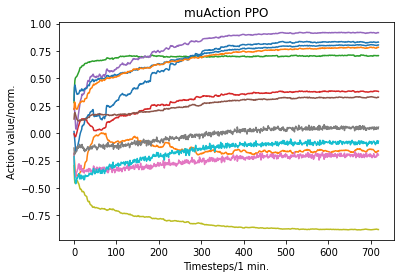

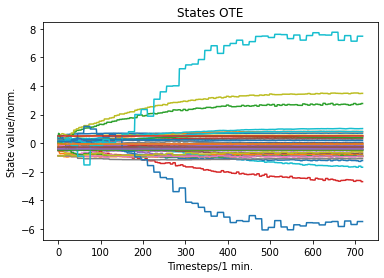

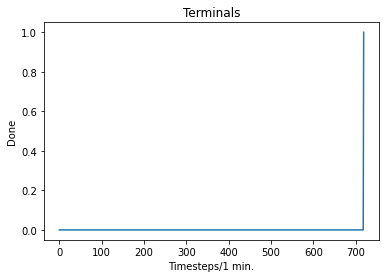

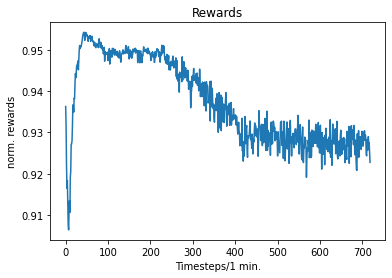

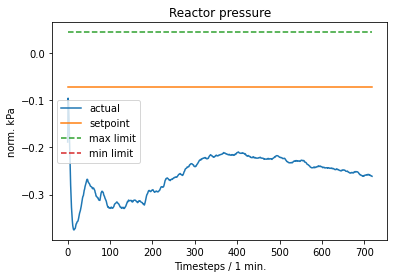

...

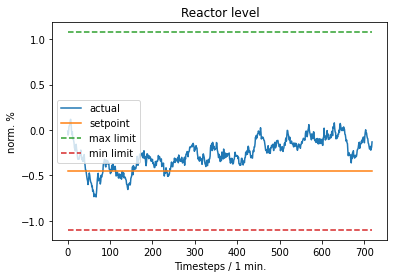

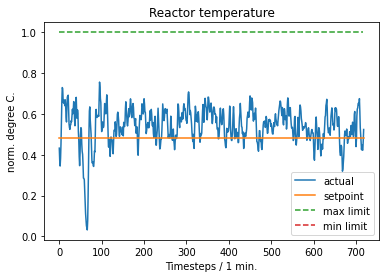

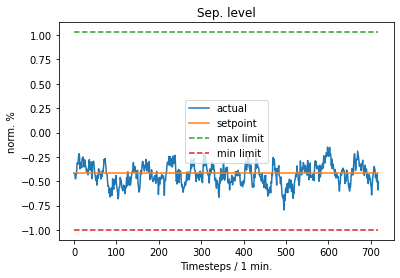

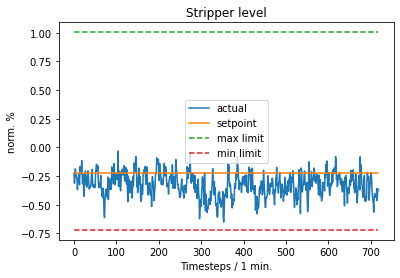

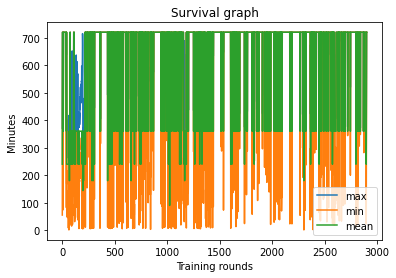

Iteration: 8701,  Mean reward: 674.1146850585938, Mean Entropy: -0.6813888549804688, complete_episode_count: 1.0, Gather time: 2.87s, Train time: 18.14s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.17285069823265076 vs. Entropy_factor: -6.813888467149809e-05
Iteration: 8702,  Mean reward: 677.8810424804688, Mean Entropy: -0.6813774108886719, complete_episode_count: 1.0, Gather time: 2.59s, Train time: 17.68s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.3205971419811249 vs. Entropy_factor: -6.813774962211028e-05
Iteration: 8703,  Mean reward: 676.255859375, Mean Entropy: -0.6810874938964844, complete_episode_count: 1.0, Gather time: 2.66s, Train time: 18.62s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.0312429666519165 vs. Entropy_factor: -6.810874037910253e-05
Iteration: 8704,  Mean reward: 674.9957275390625, Mean Entropy: -0.6808815002441406, complete_episode_count: 1.0, Gather t

Iteration: 8729,  Mean reward: 681.8984375, Mean Entropy: -0.6776275634765625, complete_episode_count: 1.0, Gather time: 2.92s, Train time: 18.26s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.15927714109420776 vs. Entropy_factor: -6.776274676667526e-05
Iteration: 8730,  Mean reward: 659.3450927734375, Mean Entropy: -0.6773853302001953, complete_episode_count: 1.0, Gather time: 2.78s, Train time: 17.85s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.21544794738292694 vs. Entropy_factor: -6.773853237973526e-05
Iteration: 8731,  Mean reward: 680.8984375, Mean Entropy: -0.6772022247314453, complete_episode_count: 1.0, Gather time: 3.00s, Train time: 17.56s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.0905563086271286 vs. Entropy_factor: -6.772021151846275e-05
Iteration: 8732,  Mean reward: 680.636962890625, Mean Entropy: -0.6770210266113281, complete_episode_count: 1.0, Gather time: 2.7

Iteration: 8757,  Mean reward: 670.74462890625, Mean Entropy: -0.6738071441650391, complete_episode_count: 1.0, Gather time: 2.73s, Train time: 17.47s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.4772396087646484 vs. Entropy_factor: -6.738071533618495e-05
Iteration: 8758,  Mean reward: 672.9080810546875, Mean Entropy: -0.6737518310546875, complete_episode_count: 1.0, Gather time: 2.87s, Train time: 17.81s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.1624692976474762 vs. Entropy_factor: -6.737518560839817e-05
Iteration: 8759,  Mean reward: 675.982421875, Mean Entropy: -0.6736240386962891, complete_episode_count: 1.0, Gather time: 2.87s, Train time: 17.88s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.14585921168327332 vs. Entropy_factor: -6.736239447491243e-05
Iteration: 8760,  Mean reward: 677.3198852539062, Mean Entropy: -0.6738128662109375, complete_episode_count: 1.0, Gather time:

Iteration: 8785,  Mean reward: 676.4961547851562, Mean Entropy: -0.6683216094970703, complete_episode_count: 1.0, Gather time: 2.82s, Train time: 17.71s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.248908519744873 vs. Entropy_factor: -6.683216633973643e-05
Iteration: 8786,  Mean reward: 677.3394165039062, Mean Entropy: -0.6683139801025391, complete_episode_count: 1.0, Gather time: 2.79s, Train time: 17.44s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.04161505028605461 vs. Entropy_factor: -6.683140236418694e-05
Iteration: 8787,  Mean reward: 679.1395874023438, Mean Entropy: -0.6680946350097656, complete_episode_count: 1.0, Gather time: 2.93s, Train time: 17.57s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.10935095697641373 vs. Entropy_factor: -6.680946535198018e-05
Iteration: 8788,  Mean reward: 677.09033203125, Mean Entropy: -0.6679840087890625, complete_episode_count: 1.0, Gather 

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


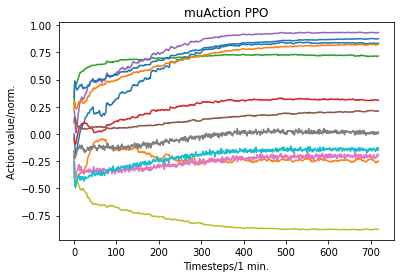

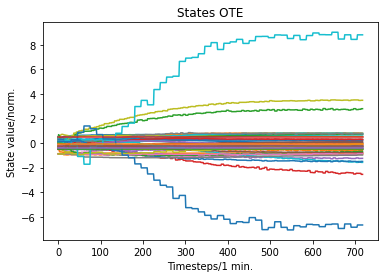

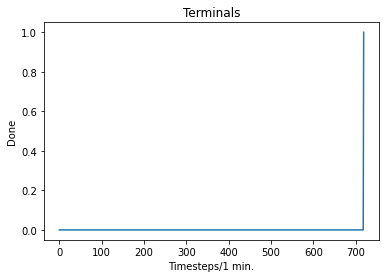

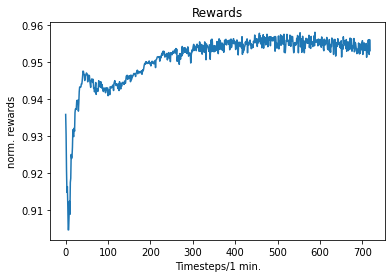

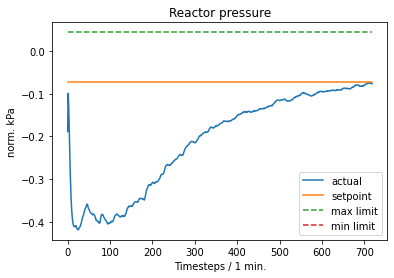

...

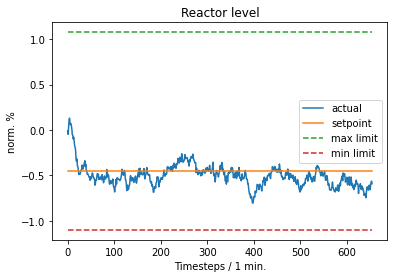

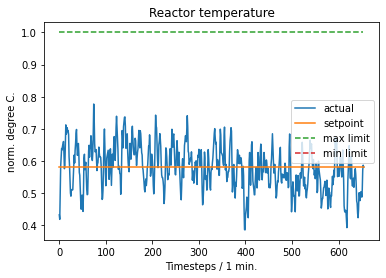

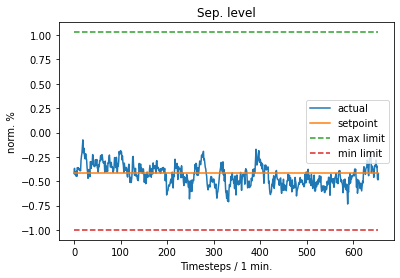

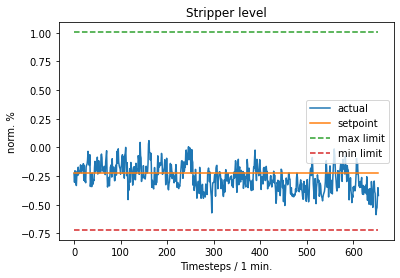

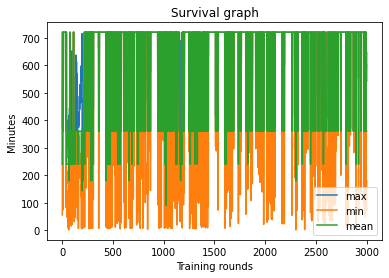

Iteration: 8801,  Mean reward: 670.8409423828125, Mean Entropy: -0.6653518676757812, complete_episode_count: 1.0, Gather time: 2.87s, Train time: 17.59s,Max episode: 710min., Min episode: 10min., Mean episode: 360.00min.PPO_clip: 4.352842330932617 vs. Entropy_factor: -6.653519085375592e-05
Iteration: 8802,  Mean reward: 681.5162963867188, Mean Entropy: -0.665252685546875, complete_episode_count: 1.0, Gather time: 2.96s, Train time: 17.75s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.18216688930988312 vs. Entropy_factor: -6.652525917161256e-05
Iteration: 8803,  Mean reward: 680.1064453125, Mean Entropy: -0.6652374267578125, complete_episode_count: 1.0, Gather time: 2.68s, Train time: 17.48s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.0292247533798218 vs. Entropy_factor: -6.65237384964712e-05
Iteration: 8804,  Mean reward: 543.8180541992188, Mean Entropy: -0.6648101806640625, complete_episode_count: 1.0, Gather time: 

Iteration: 8829,  Mean reward: 566.5562133789062, Mean Entropy: -0.6622447967529297, complete_episode_count: 1.0, Gather time: 2.79s, Train time: 17.56s,Max episode: 603min., Min episode: 117min., Mean episode: 360.00min.PPO_clip: 0.7993606925010681 vs. Entropy_factor: -6.622447835979983e-05
Iteration: 8830,  Mean reward: 606.2362060546875, Mean Entropy: -0.6621723175048828, complete_episode_count: 1.0, Gather time: 2.79s, Train time: 17.65s,Max episode: 646min., Min episode: 74min., Mean episode: 360.00min.PPO_clip: -1.2114641666412354 vs. Entropy_factor: -6.621722423005849e-05
Iteration: 8831,  Mean reward: 580.8642578125, Mean Entropy: -0.6619338989257812, complete_episode_count: 1.0, Gather time: 2.95s, Train time: 17.70s,Max episode: 621min., Min episode: 99min., Mean episode: 360.00min.PPO_clip: -3.1466028690338135 vs. Entropy_factor: -6.619339546887204e-05
Iteration: 8832,  Mean reward: 634.7205810546875, Mean Entropy: -0.6619834899902344, complete_episode_count: 1.0, Gather tim

Iteration: 8857,  Mean reward: 680.07421875, Mean Entropy: -0.6578693389892578, complete_episode_count: 1.0, Gather time: 2.85s, Train time: 17.73s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.16145920753479004 vs. Entropy_factor: -6.57869313727133e-05
Iteration: 8858,  Mean reward: 675.206298828125, Mean Entropy: -0.6577262878417969, complete_episode_count: 1.0, Gather time: 2.82s, Train time: 17.76s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.07844821363687515 vs. Entropy_factor: -6.577262684004381e-05
Iteration: 8859,  Mean reward: 671.1845703125, Mean Entropy: -0.6576366424560547, complete_episode_count: 1.0, Gather time: 2.89s, Train time: 17.75s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.18336288630962372 vs. Entropy_factor: -6.576366286026314e-05
Iteration: 8860,  Mean reward: 681.8499145507812, Mean Entropy: -0.657684326171875, complete_episode_count: 1.0, Gather time: 2.

Iteration: 8885,  Mean reward: 670.39404296875, Mean Entropy: -0.6547794342041016, complete_episode_count: 1.0, Gather time: 2.84s, Train time: 18.09s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -2.38093900680542 vs. Entropy_factor: -6.547793600475416e-05
Iteration: 8886,  Mean reward: 666.3021850585938, Mean Entropy: -0.6546707153320312, complete_episode_count: 1.0, Gather time: 2.78s, Train time: 19.49s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.18852244317531586 vs. Entropy_factor: -6.54670802759938e-05
Iteration: 8887,  Mean reward: 666.3577270507812, Mean Entropy: -0.6547508239746094, complete_episode_count: 1.0, Gather time: 3.54s, Train time: 18.16s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 1.2997605800628662 vs. Entropy_factor: -6.547507655341178e-05
Iteration: 8888,  Mean reward: 665.7509765625, Mean Entropy: -0.6547222137451172, complete_episode_count: 1.0, Gather time:

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


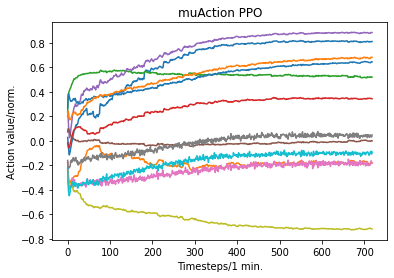

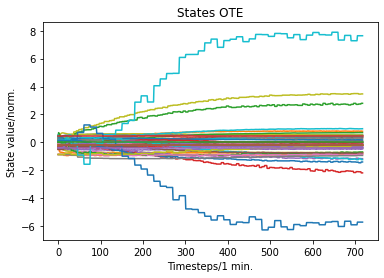

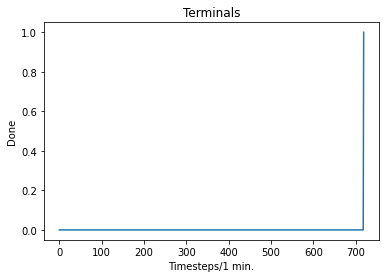

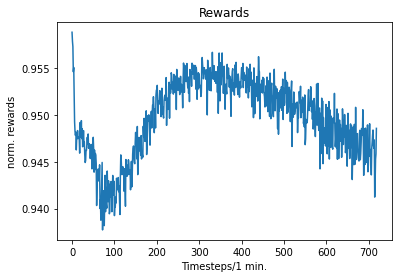

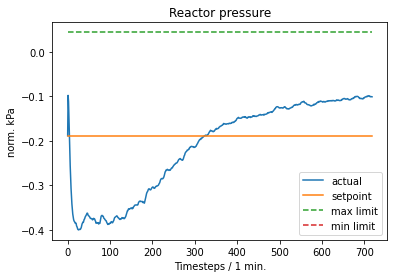

...

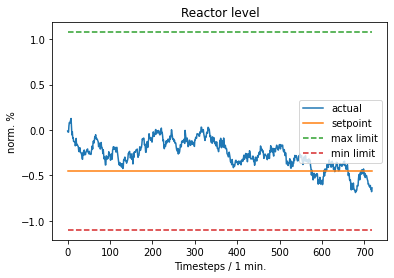

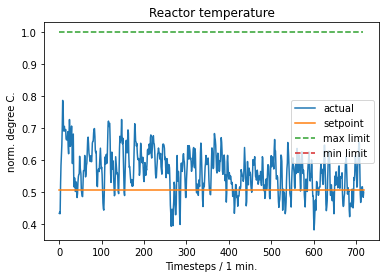

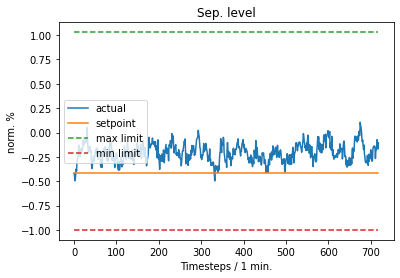

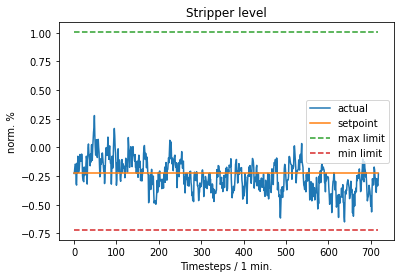

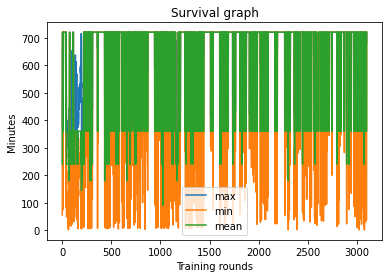

Iteration: 8901,  Mean reward: 673.2610473632812, Mean Entropy: -0.6524791717529297, complete_episode_count: 1.0, Gather time: 2.74s, Train time: 18.30s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.32933229207992554 vs. Entropy_factor: -6.524792115669698e-05
Iteration: 8902,  Mean reward: 666.9592895507812, Mean Entropy: -0.6524887084960938, complete_episode_count: 1.0, Gather time: 2.76s, Train time: 17.68s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.06068366765975952 vs. Entropy_factor: -6.524886703118682e-05
Iteration: 8903,  Mean reward: 673.1315307617188, Mean Entropy: -0.6523952484130859, complete_episode_count: 1.0, Gather time: 2.85s, Train time: 17.62s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.07505451142787933 vs. Entropy_factor: -6.52395174256526e-05
Iteration: 8904,  Mean reward: 679.5078125, Mean Entropy: -0.6521949768066406, complete_episode_count: 1.0, Gather t

Iteration: 8929,  Mean reward: 667.6832275390625, Mean Entropy: -0.6490840911865234, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 17.85s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 4.27717399597168 vs. Entropy_factor: -6.490841042250395e-05
Iteration: 8930,  Mean reward: 676.9652709960938, Mean Entropy: -0.6490459442138672, complete_episode_count: 1.0, Gather time: 2.79s, Train time: 17.55s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.9018291234970093 vs. Entropy_factor: -6.490458326879889e-05
Iteration: 8931,  Mean reward: 673.1505737304688, Mean Entropy: -0.6489982604980469, complete_episode_count: 1.0, Gather time: 3.09s, Train time: 18.08s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.5298947095870972 vs. Entropy_factor: -6.48998175165616e-05
Iteration: 8932,  Mean reward: 673.7720947265625, Mean Entropy: -0.6490592956542969, complete_episode_count: 1.0, Gather ti

Iteration: 8957,  Mean reward: 516.09619140625, Mean Entropy: -0.6455783843994141, complete_episode_count: 1.0, Gather time: 3.11s, Train time: 17.80s,Max episode: 567min., Min episode: 153min., Mean episode: 360.00min.PPO_clip: -0.21448293328285217 vs. Entropy_factor: -6.455783295677975e-05
Iteration: 8958,  Mean reward: 496.6500549316406, Mean Entropy: -0.6452903747558594, complete_episode_count: 1.0, Gather time: 2.80s, Train time: 17.84s,Max episode: 534min., Min episode: 186min., Mean episode: 360.00min.PPO_clip: 0.15863940119743347 vs. Entropy_factor: -6.45290274405852e-05
Iteration: 8959,  Mean reward: 525.1243896484375, Mean Entropy: -0.6451911926269531, complete_episode_count: 1.0, Gather time: 2.90s, Train time: 17.99s,Max episode: 568min., Min episode: 152min., Mean episode: 360.00min.PPO_clip: 1.9429900646209717 vs. Entropy_factor: -6.451911758631468e-05
Iteration: 8960,  Mean reward: 597.3447265625, Mean Entropy: -0.6451358795166016, complete_episode_count: 1.0, Gather tim

Iteration: 8985,  Mean reward: 485.402099609375, Mean Entropy: -0.6439304351806641, complete_episode_count: 1.0, Gather time: 3.39s, Train time: 17.85s,Max episode: 522min., Min episode: 198min., Mean episode: 360.00min.PPO_clip: -0.15353509783744812 vs. Entropy_factor: -6.439303979277611e-05
Iteration: 8986,  Mean reward: 473.16705322265625, Mean Entropy: -0.6438694000244141, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 18.45s,Max episode: 508min., Min episode: 212min., Mean episode: 360.00min.PPO_clip: 0.139987513422966 vs. Entropy_factor: -6.438693526433781e-05
Iteration: 8987,  Mean reward: 482.8416748046875, Mean Entropy: -0.6436519622802734, complete_episode_count: 1.0, Gather time: 2.83s, Train time: 18.50s,Max episode: 520min., Min episode: 200min., Mean episode: 360.00min.PPO_clip: -0.31743210554122925 vs. Entropy_factor: -6.436520197894424e-05
Iteration: 8988,  Mean reward: 535.2578125, Mean Entropy: -0.6438426971435547, complete_episode_count: 1.0, Gather tim

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


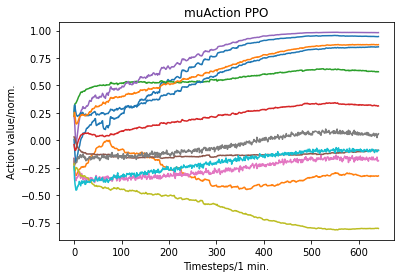

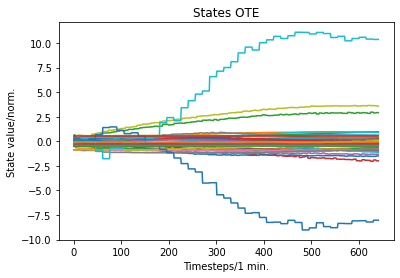

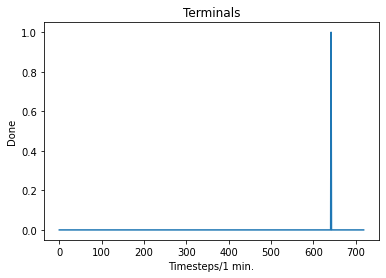

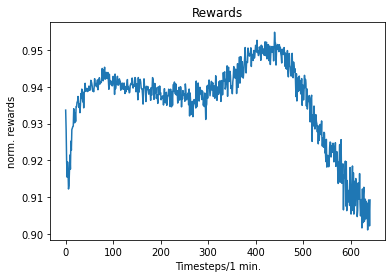

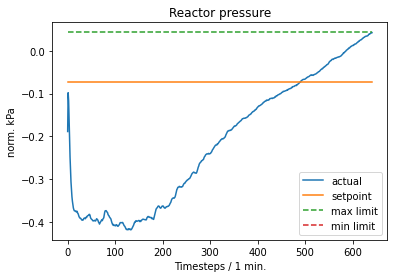

...

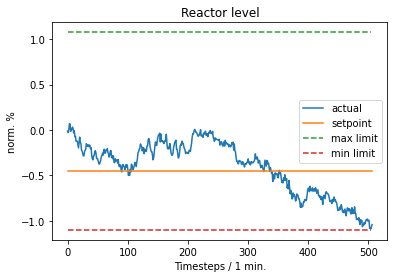

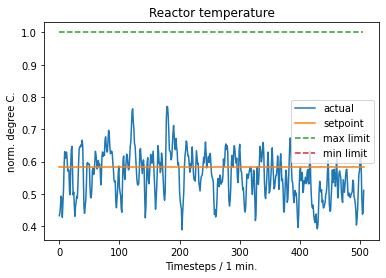

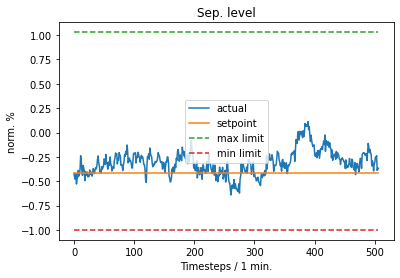

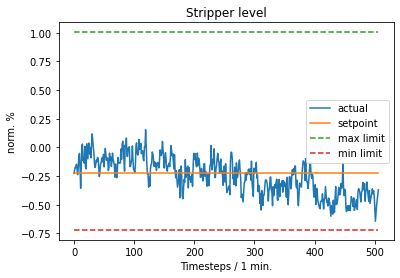

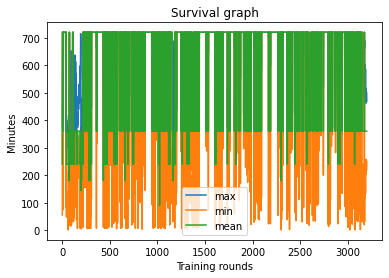

Iteration: 9001,  Mean reward: 399.88714599609375, Mean Entropy: -0.6424961090087891, complete_episode_count: 1.0, Gather time: 2.80s, Train time: 18.46s,Max episode: 428min., Min episode: 292min., Mean episode: 360.00min.PPO_clip: -0.9925500154495239 vs. Entropy_factor: -6.424960884032771e-05
Iteration: 9002,  Mean reward: 419.38177490234375, Mean Entropy: -0.642333984375, complete_episode_count: 1.0, Gather time: 2.91s, Train time: 18.33s,Max episode: 448min., Min episode: 272min., Mean episode: 360.00min.PPO_clip: -0.08313844352960587 vs. Entropy_factor: -6.42333907308057e-05
Iteration: 9003,  Mean reward: 484.4366760253906, Mean Entropy: -0.6421375274658203, complete_episode_count: 1.0, Gather time: 3.28s, Train time: 17.81s,Max episode: 522min., Min episode: 198min., Mean episode: 360.00min.PPO_clip: 2.0538182258605957 vs. Entropy_factor: -6.421375292120501e-05
Iteration: 9004,  Mean reward: 320.7958679199219, Mean Entropy: -0.6415481567382812, complete_episode_count: 1.0, Gather 

Iteration: 9029,  Mean reward: 353.5224304199219, Mean Entropy: -0.6389617919921875, complete_episode_count: 1.0, Gather time: 2.78s, Train time: 18.12s,Max episode: 400min., Min episode: 320min., Mean episode: 360.00min.PPO_clip: -0.47758322954177856 vs. Entropy_factor: -6.389617919921875e-05
Iteration: 9030,  Mean reward: 308.78216552734375, Mean Entropy: -0.6386222839355469, complete_episode_count: 2.0, Gather time: 3.39s, Train time: 15.64s,Max episode: 351min., Min episode: 30min., Mean episode: 240.00min.PPO_clip: -4.212802886962891 vs. Entropy_factor: -6.386223685694858e-05
Iteration: 9031,  Mean reward: 320.72235107421875, Mean Entropy: -0.6384906768798828, complete_episode_count: 1.0, Gather time: 2.99s, Train time: 18.94s,Max episode: 363min., Min episode: 357min., Mean episode: 360.00min.PPO_clip: 0.38104429841041565 vs. Entropy_factor: -6.384907464962453e-05
Iteration: 9032,  Mean reward: 218.93093872070312, Mean Entropy: -0.6380748748779297, complete_episode_count: 2.0, Ga

Iteration: 9057,  Mean reward: 413.2350769042969, Mean Entropy: -0.6360511779785156, complete_episode_count: 1.0, Gather time: 3.37s, Train time: 18.28s,Max episode: 457min., Min episode: 263min., Mean episode: 360.00min.PPO_clip: -0.6774958968162537 vs. Entropy_factor: -6.360512634273618e-05
Iteration: 9058,  Mean reward: 470.81182861328125, Mean Entropy: -0.6361179351806641, complete_episode_count: 1.0, Gather time: 2.92s, Train time: 18.58s,Max episode: 513min., Min episode: 207min., Mean episode: 360.00min.PPO_clip: 1.4467231035232544 vs. Entropy_factor: -6.361178384395316e-05
Iteration: 9059,  Mean reward: 401.0655822753906, Mean Entropy: -0.6360683441162109, complete_episode_count: 1.0, Gather time: 3.05s, Train time: 18.80s,Max episode: 436min., Min episode: 284min., Mean episode: 360.00min.PPO_clip: -0.08493225276470184 vs. Entropy_factor: -6.360683619277552e-05
Iteration: 9060,  Mean reward: 423.6875, Mean Entropy: -0.6361141204833984, complete_episode_count: 1.0, Gather time:

Iteration: 9086,  Mean reward: 349.75067138671875, Mean Entropy: -0.6331825256347656, complete_episode_count: 1.0, Gather time: 3.00s, Train time: 18.73s,Max episode: 378min., Min episode: 342min., Mean episode: 360.00min.PPO_clip: -0.04344118386507034 vs. Entropy_factor: -6.331824260996655e-05
Iteration: 9087,  Mean reward: 410.1766357421875, Mean Entropy: -0.6332435607910156, complete_episode_count: 1.0, Gather time: 2.98s, Train time: 18.57s,Max episode: 447min., Min episode: 273min., Mean episode: 360.00min.PPO_clip: 2.333705425262451 vs. Entropy_factor: -6.332435441436246e-05
Iteration: 9088,  Mean reward: 372.70751953125, Mean Entropy: -0.6330890655517578, complete_episode_count: 1.0, Gather time: 2.82s, Train time: 18.21s,Max episode: 406min., Min episode: 314min., Mean episode: 360.00min.PPO_clip: -2.871102809906006 vs. Entropy_factor: -6.330891483230516e-05
Iteration: 9089,  Mean reward: 330.8583984375, Mean Entropy: -0.6329059600830078, complete_episode_count: 2.0, Gather tim

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


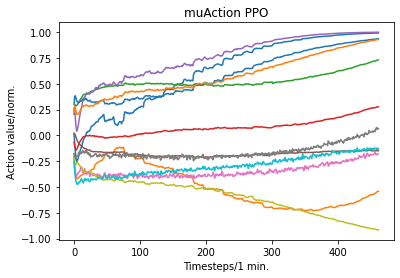

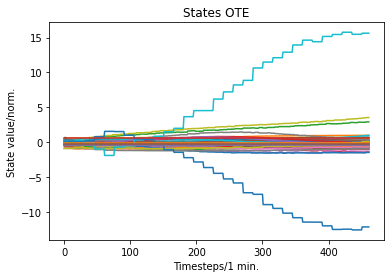

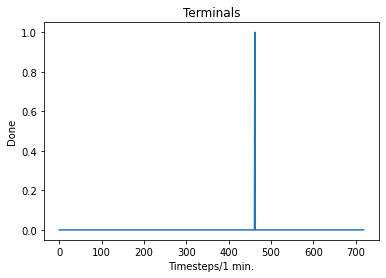

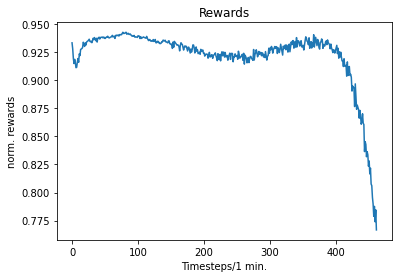

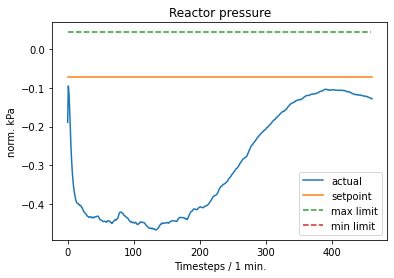

...

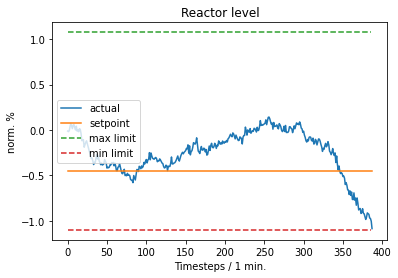

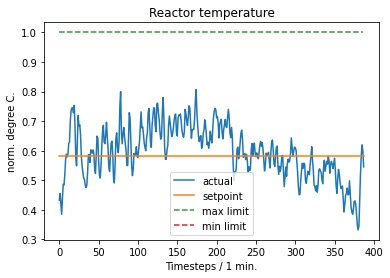

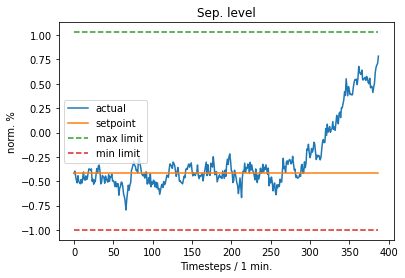

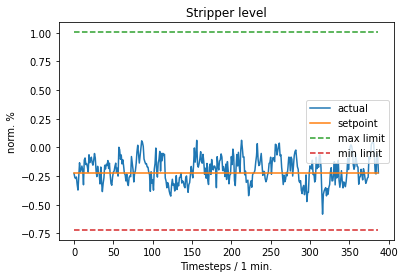

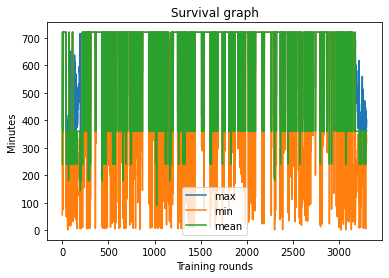

Iteration: 9101,  Mean reward: 360.67352294921875, Mean Entropy: -0.6313629150390625, complete_episode_count: 1.0, Gather time: 2.83s, Train time: 18.38s,Max episode: 393min., Min episode: 327min., Mean episode: 360.00min.PPO_clip: -0.47916775941848755 vs. Entropy_factor: -6.313628546195105e-05
Iteration: 9102,  Mean reward: 346.99322509765625, Mean Entropy: -0.6311626434326172, complete_episode_count: 1.0, Gather time: 2.91s, Train time: 18.38s,Max episode: 380min., Min episode: 340min., Mean episode: 360.00min.PPO_clip: -0.40774279832839966 vs. Entropy_factor: -6.311626202659681e-05
Iteration: 9103,  Mean reward: 356.4395751953125, Mean Entropy: -0.6311931610107422, complete_episode_count: 1.0, Gather time: 2.98s, Train time: 17.92s,Max episode: 387min., Min episode: 333min., Mean episode: 360.00min.PPO_clip: -0.08258219063282013 vs. Entropy_factor: -6.311932520475239e-05
Iteration: 9104,  Mean reward: 350.87890625, Mean Entropy: -0.6310081481933594, complete_episode_count: 1.0, Gath

Iteration: 9129,  Mean reward: 353.7815246582031, Mean Entropy: -0.6256942749023438, complete_episode_count: 1.0, Gather time: 3.32s, Train time: 18.00s,Max episode: 382min., Min episode: 338min., Mean episode: 360.00min.PPO_clip: -0.8264934420585632 vs. Entropy_factor: -6.256941560423002e-05
Iteration: 9130,  Mean reward: 371.1297912597656, Mean Entropy: -0.6254940032958984, complete_episode_count: 1.0, Gather time: 2.91s, Train time: 18.70s,Max episode: 398min., Min episode: 322min., Mean episode: 360.00min.PPO_clip: -0.06815586239099503 vs. Entropy_factor: -6.254939216887578e-05
Iteration: 9131,  Mean reward: 334.209716796875, Mean Entropy: -0.6252765655517578, complete_episode_count: 2.0, Gather time: 2.95s, Train time: 15.84s,Max episode: 367min., Min episode: 3min., Mean episode: 240.00min.PPO_clip: -0.9351162910461426 vs. Entropy_factor: -6.25276516075246e-05
Iteration: 9132,  Mean reward: 394.9489440917969, Mean Entropy: -0.6251487731933594, complete_episode_count: 1.0, Gather 

Iteration: 9157,  Mean reward: 417.5522766113281, Mean Entropy: -0.6212253570556641, complete_episode_count: 1.0, Gather time: 2.89s, Train time: 18.23s,Max episode: 454min., Min episode: 266min., Mean episode: 360.00min.PPO_clip: -1.3862836360931396 vs. Entropy_factor: -6.212253356352448e-05
Iteration: 9158,  Mean reward: 467.71844482421875, Mean Entropy: -0.6212310791015625, complete_episode_count: 1.0, Gather time: 3.08s, Train time: 18.26s,Max episode: 513min., Min episode: 207min., Mean episode: 360.00min.PPO_clip: 1.9951120615005493 vs. Entropy_factor: -6.2123108364176e-05
Iteration: 9159,  Mean reward: 432.8185119628906, Mean Entropy: -0.6209793090820312, complete_episode_count: 1.0, Gather time: 2.92s, Train time: 18.26s,Max episode: 473min., Min episode: 247min., Mean episode: 360.00min.PPO_clip: -0.39821651577949524 vs. Entropy_factor: -6.20979189989157e-05
Iteration: 9160,  Mean reward: 438.892333984375, Mean Entropy: -0.6210136413574219, complete_episode_count: 1.0, Gather 

Iteration: 9185,  Mean reward: 488.3706359863281, Mean Entropy: -0.6193752288818359, complete_episode_count: 1.0, Gather time: 3.58s, Train time: 20.35s,Max episode: 567min., Min episode: 153min., Mean episode: 360.00min.PPO_clip: 2.4114136695861816 vs. Entropy_factor: -6.193751323735341e-05
Iteration: 9186,  Mean reward: 379.1832275390625, Mean Entropy: -0.6194953918457031, complete_episode_count: 1.0, Gather time: 3.42s, Train time: 22.91s,Max episode: 422min., Min episode: 298min., Mean episode: 360.00min.PPO_clip: -0.05075802281498909 vs. Entropy_factor: -6.194954039528966e-05
Iteration: 9187,  Mean reward: 378.0728759765625, Mean Entropy: -0.6193828582763672, complete_episode_count: 1.0, Gather time: 3.37s, Train time: 20.97s,Max episode: 425min., Min episode: 295min., Mean episode: 360.00min.PPO_clip: 0.06525369733572006 vs. Entropy_factor: -6.193829176481813e-05
Iteration: 9188,  Mean reward: 455.12152099609375, Mean Entropy: -0.6195774078369141, complete_episode_count: 1.0, Gat

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


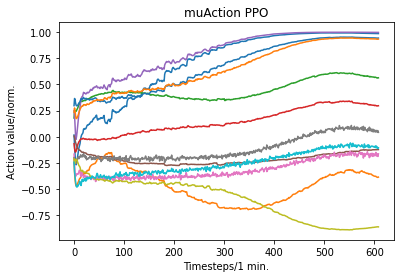

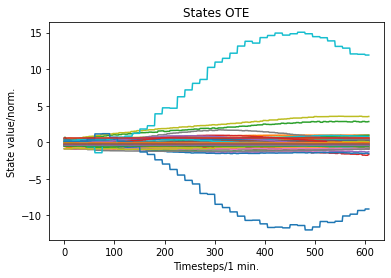

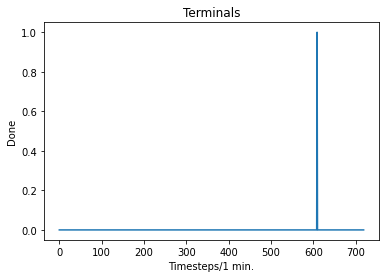

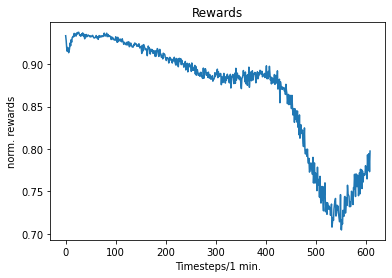

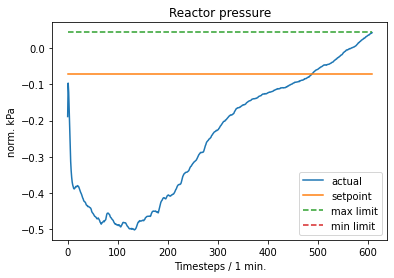

...

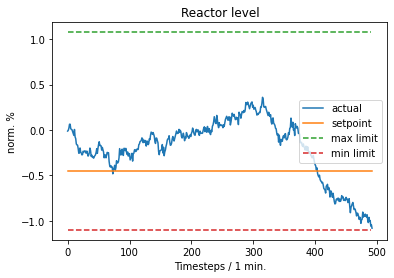

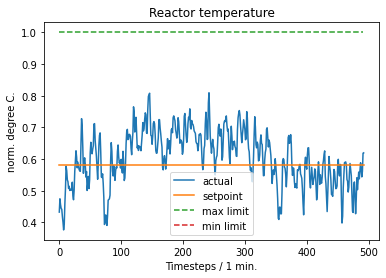

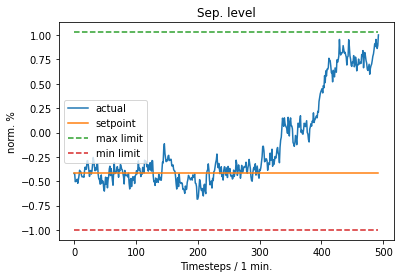

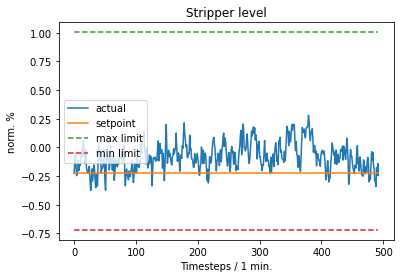

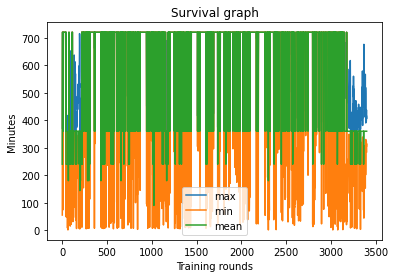

Iteration: 9201,  Mean reward: 386.09222412109375, Mean Entropy: -0.6192417144775391, complete_episode_count: 1.0, Gather time: 2.97s, Train time: 18.95s,Max episode: 432min., Min episode: 288min., Mean episode: 360.00min.PPO_clip: 0.1759118288755417 vs. Entropy_factor: -6.1924169131089e-05
Iteration: 9202,  Mean reward: 402.6006164550781, Mean Entropy: -0.6192131042480469, complete_episode_count: 1.0, Gather time: 3.15s, Train time: 18.63s,Max episode: 458min., Min episode: 262min., Mean episode: 360.00min.PPO_clip: 0.6629477739334106 vs. Entropy_factor: -6.192130967974663e-05
Iteration: 9203,  Mean reward: 412.56268310546875, Mean Entropy: -0.6192588806152344, complete_episode_count: 1.0, Gather time: 3.17s, Train time: 18.93s,Max episode: 473min., Min episode: 247min., Mean episode: 360.00min.PPO_clip: -0.17835633456707 vs. Entropy_factor: -6.192589353304356e-05
Iteration: 9204,  Mean reward: 419.63720703125, Mean Entropy: -0.6189899444580078, complete_episode_count: 1.0, Gather tim

Iteration: 9229,  Mean reward: 386.96063232421875, Mean Entropy: -0.6167926788330078, complete_episode_count: 1.0, Gather time: 3.43s, Train time: 18.82s,Max episode: 423min., Min episode: 297min., Mean episode: 360.00min.PPO_clip: -0.19222019612789154 vs. Entropy_factor: -6.167927494971082e-05
Iteration: 9230,  Mean reward: 426.6197509765625, Mean Entropy: -0.6168231964111328, complete_episode_count: 1.0, Gather time: 3.03s, Train time: 18.87s,Max episode: 466min., Min episode: 254min., Mean episode: 360.00min.PPO_clip: 0.12709073722362518 vs. Entropy_factor: -6.168231629999354e-05
Iteration: 9231,  Mean reward: 430.0995788574219, Mean Entropy: -0.6168003082275391, complete_episode_count: 1.0, Gather time: 3.02s, Train time: 19.36s,Max episode: 474min., Min episode: 246min., Mean episode: 360.00min.PPO_clip: 0.1109982505440712 vs. Entropy_factor: -6.168003164930269e-05
Iteration: 9232,  Mean reward: 411.2890930175781, Mean Entropy: -0.6167182922363281, complete_episode_count: 1.0, Gat

Iteration: 9257,  Mean reward: 431.0863952636719, Mean Entropy: -0.6144237518310547, complete_episode_count: 1.0, Gather time: 2.74s, Train time: 19.52s,Max episode: 462min., Min episode: 258min., Mean episode: 360.00min.PPO_clip: 0.31101614236831665 vs. Entropy_factor: -6.144237704575062e-05
Iteration: 9258,  Mean reward: 444.29864501953125, Mean Entropy: -0.6143608093261719, complete_episode_count: 1.0, Gather time: 2.91s, Train time: 18.87s,Max episode: 476min., Min episode: 244min., Mean episode: 360.00min.PPO_clip: 0.5419954061508179 vs. Entropy_factor: -6.143608334241435e-05
Iteration: 9259,  Mean reward: 446.7637023925781, Mean Entropy: -0.6142330169677734, complete_episode_count: 1.0, Gather time: 3.36s, Train time: 18.88s,Max episode: 485min., Min episode: 235min., Mean episode: 360.00min.PPO_clip: 0.3036351501941681 vs. Entropy_factor: -6.142329220892861e-05
Iteration: 9260,  Mean reward: 467.9842529296875, Mean Entropy: -0.6142578125, complete_episode_count: 1.0, Gather time

Iteration: 9285,  Mean reward: 453.51800537109375, Mean Entropy: -0.6099224090576172, complete_episode_count: 1.0, Gather time: 3.45s, Train time: 18.82s,Max episode: 497min., Min episode: 223min., Mean episode: 360.00min.PPO_clip: -0.08543867617845535 vs. Entropy_factor: -6.099223901401274e-05
Iteration: 9286,  Mean reward: 448.8902282714844, Mean Entropy: -0.6099529266357422, complete_episode_count: 1.0, Gather time: 2.97s, Train time: 19.07s,Max episode: 492min., Min episode: 228min., Mean episode: 360.00min.PPO_clip: 0.6356335878372192 vs. Entropy_factor: -6.099529127823189e-05
Iteration: 9287,  Mean reward: 431.0137939453125, Mean Entropy: -0.6100349426269531, complete_episode_count: 1.0, Gather time: 3.04s, Train time: 19.23s,Max episode: 475min., Min episode: 245min., Mean episode: 360.00min.PPO_clip: -0.2071937620639801 vs. Entropy_factor: -6.1003491282463074e-05
Iteration: 9288,  Mean reward: 406.0223388671875, Mean Entropy: -0.6100120544433594, complete_episode_count: 1.0, Ga

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


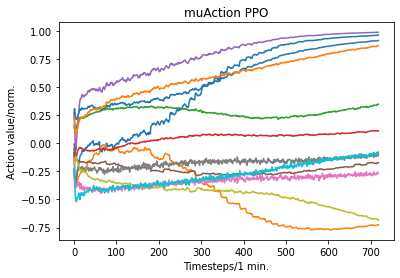

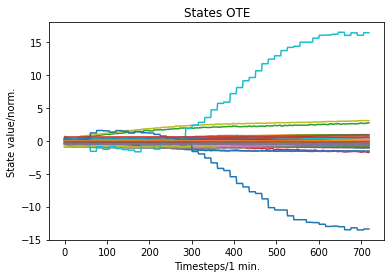

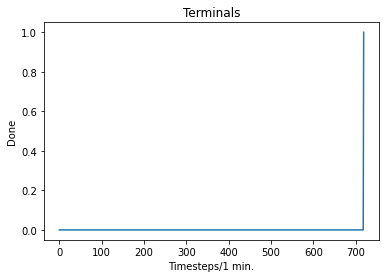

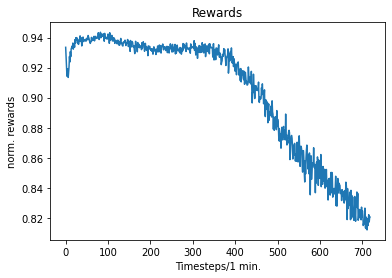

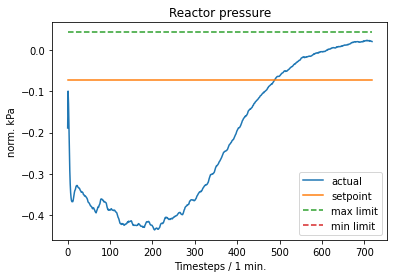

...

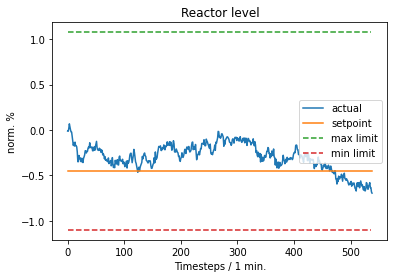

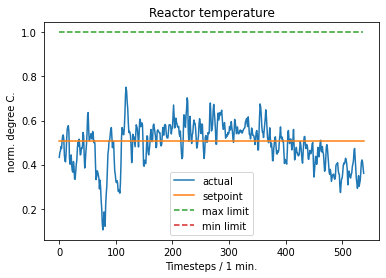

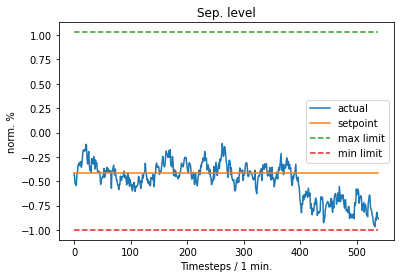

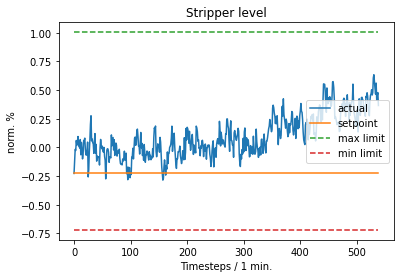

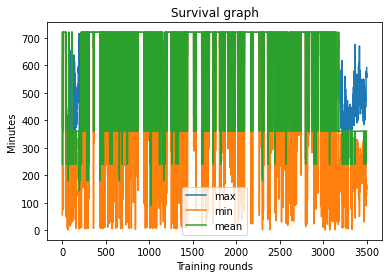

Iteration: 9301,  Mean reward: 461.43865966796875, Mean Entropy: -0.6079826354980469, complete_episode_count: 1.0, Gather time: 2.85s, Train time: 19.19s,Max episode: 500min., Min episode: 220min., Mean episode: 360.00min.PPO_clip: 0.04623798280954361 vs. Entropy_factor: -6.07982583460398e-05
Iteration: 9302,  Mean reward: 420.37939453125, Mean Entropy: -0.6080245971679688, complete_episode_count: 1.0, Gather time: 3.09s, Train time: 19.42s,Max episode: 453min., Min episode: 267min., Mean episode: 360.00min.PPO_clip: 0.2309207022190094 vs. Entropy_factor: -6.080244929762557e-05
Iteration: 9303,  Mean reward: 462.7916259765625, Mean Entropy: -0.6082572937011719, complete_episode_count: 1.0, Gather time: 2.82s, Train time: 19.47s,Max episode: 506min., Min episode: 214min., Mean episode: 360.00min.PPO_clip: -1.0932164192199707 vs. Entropy_factor: -6.082573236199096e-05
Iteration: 9304,  Mean reward: 484.331298828125, Mean Entropy: -0.6081905364990234, complete_episode_count: 1.0, Gather t

Iteration: 9329,  Mean reward: 467.91693115234375, Mean Entropy: -0.6055564880371094, complete_episode_count: 1.0, Gather time: 3.61s, Train time: 18.91s,Max episode: 497min., Min episode: 223min., Mean episode: 360.00min.PPO_clip: -2.181551694869995 vs. Entropy_factor: -6.055564881535247e-05
Iteration: 9330,  Mean reward: 552.4207153320312, Mean Entropy: -0.6053104400634766, complete_episode_count: 1.0, Gather time: 3.09s, Train time: 19.22s,Max episode: 599min., Min episode: 121min., Mean episode: 360.00min.PPO_clip: 2.78002667427063 vs. Entropy_factor: -6.05310415267013e-05
Iteration: 9331,  Mean reward: 110.56246948242188, Mean Entropy: -0.6046772003173828, complete_episode_count: 1.0, Gather time: 3.02s, Train time: 19.40s,Max episode: 601min., Min episode: 119min., Mean episode: 360.00min.PPO_clip: 0.6327590942382812 vs. Entropy_factor: -6.046772614354268e-05
Iteration: 9332,  Mean reward: 519.0128173828125, Mean Entropy: -0.60455322265625, complete_episode_count: 1.0, Gather tim

Iteration: 9357,  Mean reward: 601.6189575195312, Mean Entropy: -0.6020679473876953, complete_episode_count: 1.0, Gather time: 3.15s, Train time: 19.21s,Max episode: 641min., Min episode: 79min., Mean episode: 360.00min.PPO_clip: 0.16620346903800964 vs. Entropy_factor: -6.020679575158283e-05
Iteration: 9358,  Mean reward: 582.6945190429688, Mean Entropy: -0.6021690368652344, complete_episode_count: 1.0, Gather time: 3.10s, Train time: 19.56s,Max episode: 621min., Min episode: 99min., Mean episode: 360.00min.PPO_clip: 0.6459077596664429 vs. Entropy_factor: -6.021689478075132e-05
Iteration: 9359,  Mean reward: 536.2108154296875, Mean Entropy: -0.6020183563232422, complete_episode_count: 1.0, Gather time: 3.06s, Train time: 18.74s,Max episode: 573min., Min episode: 147min., Mean episode: 360.00min.PPO_clip: -0.5163734555244446 vs. Entropy_factor: -6.020183354848996e-05
Iteration: 9360,  Mean reward: 647.1491088867188, Mean Entropy: -0.6019287109375, complete_episode_count: 1.0, Gather tim

Iteration: 9385,  Mean reward: 663.884033203125, Mean Entropy: -0.5989608764648438, complete_episode_count: 1.0, Gather time: 2.84s, Train time: 19.40s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.4166906476020813 vs. Entropy_factor: -5.989608325762674e-05
Iteration: 9386,  Mean reward: 355.7555236816406, Mean Entropy: -0.5984764099121094, complete_episode_count: 1.0, Gather time: 3.15s, Train time: 19.52s,Max episode: 385min., Min episode: 335min., Mean episode: 360.00min.PPO_clip: -3.4634575843811035 vs. Entropy_factor: -5.984763993183151e-05
Iteration: 9387,  Mean reward: 334.3316650390625, Mean Entropy: -0.5985374450683594, complete_episode_count: 1.0, Gather time: 2.90s, Train time: 19.58s,Max episode: 373min., Min episode: 347min., Mean episode: 360.00min.PPO_clip: -0.09199647605419159 vs. Entropy_factor: -5.985375173622742e-05
Iteration: 9388,  Mean reward: 281.773681640625, Mean Entropy: -0.5983409881591797, complete_episode_count: 1.0, Gathe

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


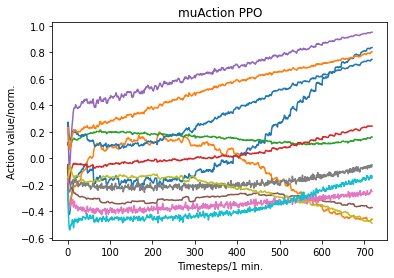

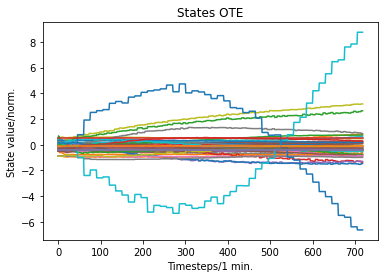

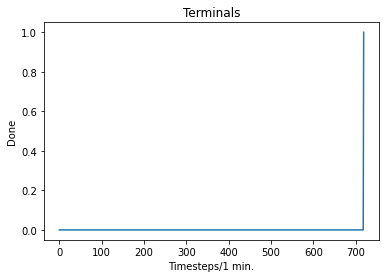

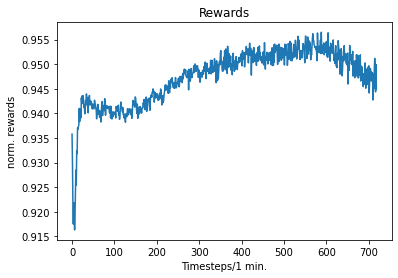

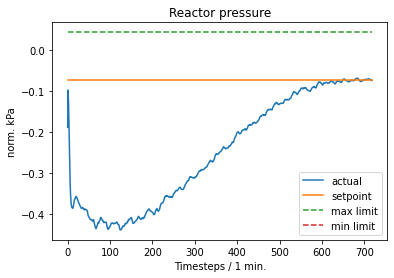

...

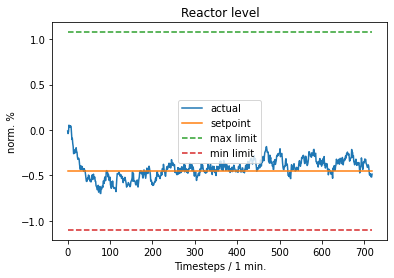

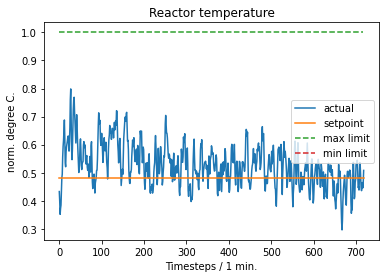

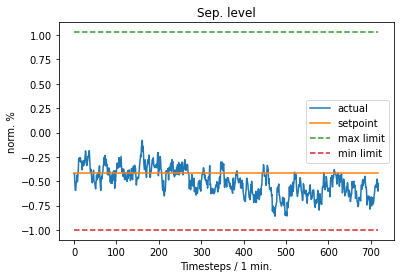

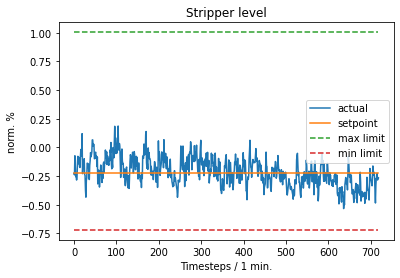

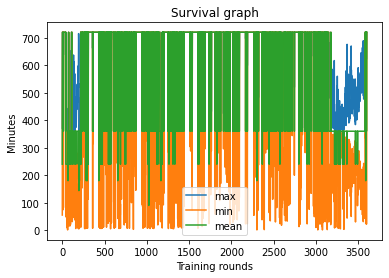

Iteration: 9401,  Mean reward: 603.1259765625, Mean Entropy: -0.5962028503417969, complete_episode_count: 1.0, Gather time: 2.99s, Train time: 19.18s,Max episode: 639min., Min episode: 81min., Mean episode: 360.00min.PPO_clip: -6.5305962562561035 vs. Entropy_factor: -5.962028444628231e-05
Iteration: 9402,  Mean reward: 610.26953125, Mean Entropy: -0.5960102081298828, complete_episode_count: 1.0, Gather time: 3.04s, Train time: 18.99s,Max episode: 647min., Min episode: 73min., Mean episode: 360.00min.PPO_clip: 0.20763273537158966 vs. Entropy_factor: -5.9601017710519955e-05
Iteration: 9403,  Mean reward: 676.5563354492188, Mean Entropy: -0.5959873199462891, complete_episode_count: 1.0, Gather time: 2.99s, Train time: 18.68s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.09423341602087021 vs. Entropy_factor: -5.9598729421850294e-05
Iteration: 9404,  Mean reward: 678.7500610351562, Mean Entropy: -0.5958595275878906, complete_episode_count: 1.0, Gather time:

Iteration: 9429,  Mean reward: 660.7537841796875, Mean Entropy: -0.5928688049316406, complete_episode_count: 1.0, Gather time: 2.98s, Train time: 18.77s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.15417583286762238 vs. Entropy_factor: -5.928688187850639e-05
Iteration: 9430,  Mean reward: 659.7171630859375, Mean Entropy: -0.5928726196289062, complete_episode_count: 1.0, Gather time: 3.08s, Train time: 19.15s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -1.1782441139221191 vs. Entropy_factor: -5.928726022830233e-05
Iteration: 9431,  Mean reward: 658.8131103515625, Mean Entropy: -0.5926418304443359, complete_episode_count: 1.0, Gather time: 2.98s, Train time: 19.28s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.3333454132080078 vs. Entropy_factor: -5.926418089075014e-05
Iteration: 9432,  Mean reward: 431.2013244628906, Mean Entropy: -0.5922641754150391, complete_episode_count: 1.0, Gath

Iteration: 9457,  Mean reward: 672.3285522460938, Mean Entropy: -0.5897979736328125, complete_episode_count: 1.0, Gather time: 2.88s, Train time: 19.20s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.13773213326931 vs. Entropy_factor: -5.8979792811442167e-05
Iteration: 9458,  Mean reward: 671.6023559570312, Mean Entropy: -0.5897560119628906, complete_episode_count: 1.0, Gather time: 3.15s, Train time: 19.29s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.564215898513794 vs. Entropy_factor: -5.89756018598564e-05
Iteration: 9459,  Mean reward: 671.6827392578125, Mean Entropy: -0.5896835327148438, complete_episode_count: 1.0, Gather time: 2.98s, Train time: 18.85s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.49103981256484985 vs. Entropy_factor: -5.896835500607267e-05
Iteration: 9460,  Mean reward: 601.4685668945312, Mean Entropy: -0.5894870758056641, complete_episode_count: 1.0, Gather 

Iteration: 9485,  Mean reward: 665.1337280273438, Mean Entropy: -0.5860385894775391, complete_episode_count: 1.0, Gather time: 2.99s, Train time: 19.56s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 2.460129737854004 vs. Entropy_factor: -5.860385863343254e-05
Iteration: 9486,  Mean reward: 664.9736938476562, Mean Entropy: -0.5861415863037109, complete_episode_count: 1.0, Gather time: 3.03s, Train time: 18.47s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -2.4987716674804688 vs. Entropy_factor: -5.861416138941422e-05
Iteration: 9487,  Mean reward: 670.527099609375, Mean Entropy: -0.5860309600830078, complete_episode_count: 1.0, Gather time: 3.42s, Train time: 18.90s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.5087664127349854 vs. Entropy_factor: -5.860310193384066e-05
Iteration: 9488,  Mean reward: 670.3070678710938, Mean Entropy: -0.5859088897705078, complete_episode_count: 1.0, Gather t

/home/eric/Documents/Master/env/lib/python3.8/site-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)


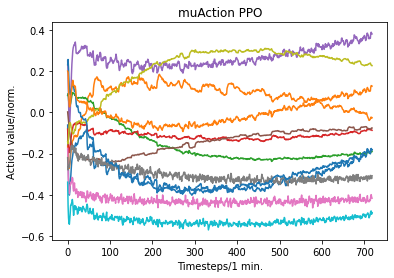

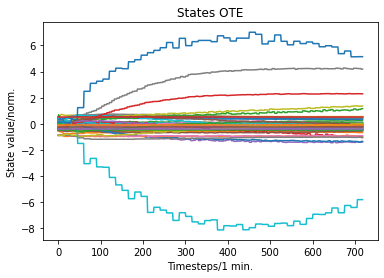

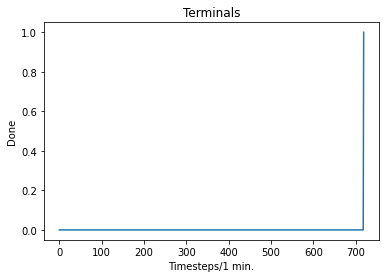

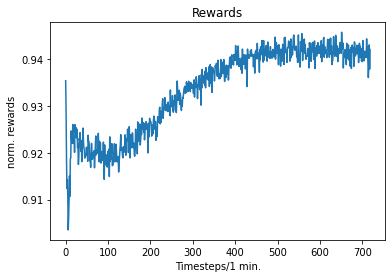

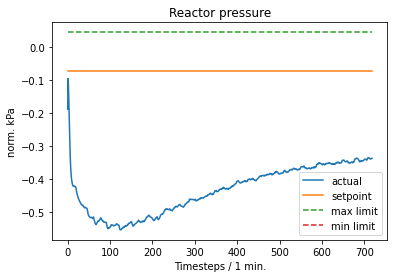

...

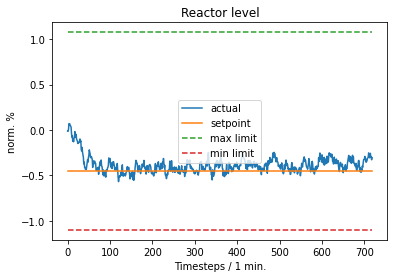

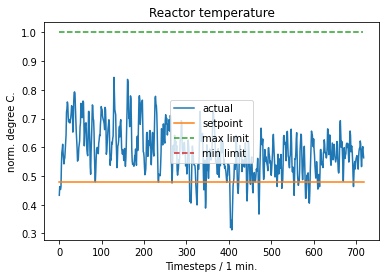

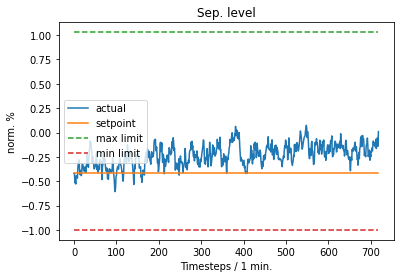

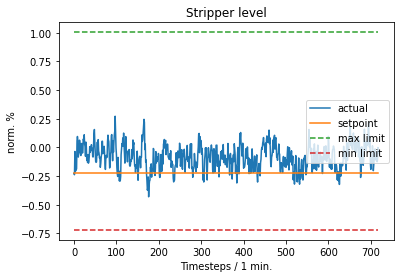

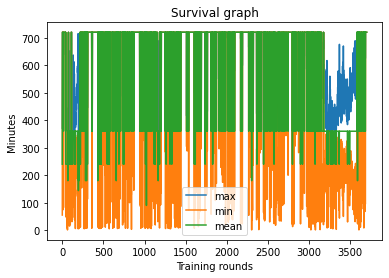

Iteration: 9501,  Mean reward: 660.5122680664062, Mean Entropy: -0.5834751129150391, complete_episode_count: 1.0, Gather time: 2.97s, Train time: 19.35s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: 0.1376437097787857 vs. Entropy_factor: -5.834751209476963e-05
Iteration: 9502,  Mean reward: 662.7608642578125, Mean Entropy: -0.5833778381347656, complete_episode_count: 1.0, Gather time: 2.86s, Train time: 19.15s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.9559108018875122 vs. Entropy_factor: -5.833779141539708e-05
Iteration: 9503,  Mean reward: 657.042724609375, Mean Entropy: -0.5835475921630859, complete_episode_count: 1.0, Gather time: 2.81s, Train time: 18.48s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.12053997814655304 vs. Entropy_factor: -5.8354758948553354e-05
Iteration: 9504,  Mean reward: 656.8584594726562, Mean Entropy: -0.5833721160888672, complete_episode_count: 1.0, Gath

Iteration: 9529,  Mean reward: 664.2567749023438, Mean Entropy: -0.5800743103027344, complete_episode_count: 1.0, Gather time: 3.12s, Train time: 18.48s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.3175544738769531 vs. Entropy_factor: -5.8007433835882694e-05
Iteration: 9530,  Mean reward: 662.156494140625, Mean Entropy: -0.5798263549804688, complete_episode_count: 1.0, Gather time: 3.00s, Train time: 19.06s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -2.526677370071411 vs. Entropy_factor: -5.7982637372333556e-05
Iteration: 9531,  Mean reward: 662.6619262695312, Mean Entropy: -0.57977294921875, complete_episode_count: 1.0, Gather time: 3.18s, Train time: 19.08s,Max episode: 720min., Min episode: 720min., Mean episode: 720.00min.PPO_clip: -0.6776748895645142 vs. Entropy_factor: -5.797729318146594e-05
Iteration: 9532,  Mean reward: 668.508056640625, Mean Entropy: -0.5795841217041016, complete_episode_count: 1.0, Gather 

KeyboardInterrupt: 

In [45]:
#operator_training(actor, critic, actor_optimizer, critic_optimizer, iteration, stop_conditions)
#actor = actor.to('cpu')
#critic = critic.to('cpu')
score = train_model(actor, critic, actor_optimizer, critic_optimizer, iteration, stop_conditions)

In [ ]:
%debug


In [ ]:
BASE_CHECKPOINT_PATH + f"{iteration}/"

In [ ]:
checkpoint = DotMap()
checkpoint.env = ENV
checkpoint.env_mask_velocity = ENV_MASK_VELOCITY 
checkpoint.iteration = iteration
checkpoint.stop_conditions = stop_conditions
checkpoint.hp = hp
CHECKPOINT_PATH = BASE_CHECKPOINT_PATH + f"{iteration}/"
print(CHECKPOINT_PATH)
CHECKPOINT_PATH = '/content'
#pathlib.Path(CHECKPOINT_PATH).mkdir(parents=True, exist_ok=True) 

with open(CHECKPOINT_PATH + "parameters.pt", "wb") as f:
    pickle.dump(checkpoint, f)
with open(CHECKPOINT_PATH + "actor_class.pt", "wb") as f:
    pickle.dump(Actor, f)
with open(CHECKPOINT_PATH + "critic_class.pt", "wb") as f:
    pickle.dump(Critic, f)
torch.save(actor.state_dict(), CHECKPOINT_PATH + "actor.pt")
torch.save(critic.state_dict(), CHECKPOINT_PATH + "critic.pt")
torch.save(actor_optimizer.state_dict(), CHECKPOINT_PATH + "actor_optimizer.pt")
torch.save(critic_optimizer.state_dict(), CHECKPOINT_PATH + "critic_optimizer.pt")
print("saved!")

In [ ]:
with open("parameters.pt", "wb") as f:
    pickle.dump(checkpoint, f)
with open("actor_class.pt", "wb") as f:
    pickle.dump(Actor, f)
with open("critic_class.pt", "wb") as f:
    pickle.dump(Critic, f)
torch.save(actor.state_dict(),"actor.pt")
torch.save(critic.state_dict(),"critic.pt")
torch.save(actor_optimizer.state_dict(),"actor_optimizer.pt")
torch.save(critic_optimizer.state_dict(),"critic_optimizer.pt")

In [ ]:
!mv /content/actor.pt /google_drive/My\ Drive/ColabNotebooks/checkpoints/

In [ ]:
BASE_CHECKPOINT_PATH 

In [ ]:
initial_state = AC.initial_value
initial_state = torch.tensor(initial_state)
initial_state = initial_state.unsqueeze(0).to("cpu")
terminal = torch.ones(1)
terminal = terminal.to("cpu")
policy_dist, h = actor(initial_state,terminal)

In [ ]:
env = gym.make("BipedalWalkerHardcore-v2")

In [ ]:
action = np.array([0.2,0.3,0.2,0.3])
env.reset()
obs, reward, done, _ = env.step(action)

In [ ]:
obs.shape
obs

In [ ]:
print(AC.initial_action.shape)
a,b,c,d = AC.step(AC.initial_action)


In [ ]:
a.shape

In [ ]:
BASE_CHECKPOINT_PATH

In [ ]:
dirName = 'tempDir2/temp2/temp'
# Create target directory & all intermediate directories if don't exists
os.makedirs(BASE_CHECKPOINT_PATH)    